In [41]:
# !pip install cfgrib xarray matplotlib pandas
# !pip install dask
# !pip install seaborn
# !pip install statsmodels
# !pip install dask[dataframe]

In [32]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import os
import numpy as np
import cfgrib
import seaborn as sns
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.dates as mdates
import dask.array as da
from matplotlib.dates import YearLocator, DateFormatter
import matplotlib.colors as mcolors

## 1. ERA5_Monthly_averaged_reanalysis_by_hour_of-day_data_on_single_levels_from_2013-2023.grib

#### Load Dataset

In [33]:
file_path = r"C:\Users\giann\OneDrive\Desktop\Thesis\Copernicus_Data\ERA5_Monthly_averaged_reanalysis_by_hour_of-day_data_on_single_levels_from_2013-2023.grib"

# Replace backslashes with forward slashes
updated_path = file_path.replace('\\', '/')

# Print the updated path
print("Original Path:", file_path)
print("Updated Path:", updated_path)

# Use open_datasets and NO open_dataset(from Error)
datasets = cfgrib.open_datasets(updated_path)
print(datasets)


Original Path: C:\Users\giann\OneDrive\Desktop\Thesis\Copernicus_Data\ERA5_Monthly_averaged_reanalysis_by_hour_of-day_data_on_single_levels_from_2013-2023.grib
Updated Path: C:/Users/giann/OneDrive/Desktop/Thesis/Copernicus_Data/ERA5_Monthly_averaged_reanalysis_by_hour_of-day_data_on_single_levels_from_2013-2023.grib
[<xarray.Dataset> Size: 220MB
Dimensions:              (time: 528, latitude: 153, longitude: 341)
Coordinates:
    number               int32 4B 0
  * time                 (time) datetime64[ns] 4kB 2013-01-01 ... 2023-12-01T...
    step                 timedelta64[ns] 8B 00:00:00
    depthBelowLandLayer  float64 8B 0.0
  * latitude             (latitude) float64 1kB 72.0 71.75 71.5 ... 34.25 34.0
  * longitude            (longitude) float64 3kB -25.0 -24.75 ... 59.75 60.0
    valid_time           (time) datetime64[ns] 4kB 2013-01-01 ... 2023-12-01T...
Data variables:
    swvl1                (time, latitude, longitude) float32 110MB ...
    stl1                 (time, lati

#### Data Cleaning & Seasonal Seperation


Processing Dataset 1...
After processing volumetric_soil_water_layer_1: min=-0.004419725388288498, max=0.7421414852142334
After processing soil_temperature_level_1: min=-26.51947021484375, max=37.943511962890625
Performing Seasonal Analysis for Dataset 1...
Seasonal extremes for Dataset 1:
        latitude  longitude  volumetric_soil_water_layer_1  \
Winter     70.25      55.75                       0.397747   
Spring     70.25      55.75                       0.389151   
Summer     70.25      55.75                       0.370429   
Fall       70.25      55.75                       0.393363   

        soil_temperature_level_1  number   step  depthBelowLandLayer  
Winter                 15.595490     0.0 0 days                  0.0  
Spring                 21.439850     0.0 0 days                  0.0  
Summer                 26.426080     0.0 0 days                  0.0  
Fall                   20.213409     0.0 0 days                  0.0  


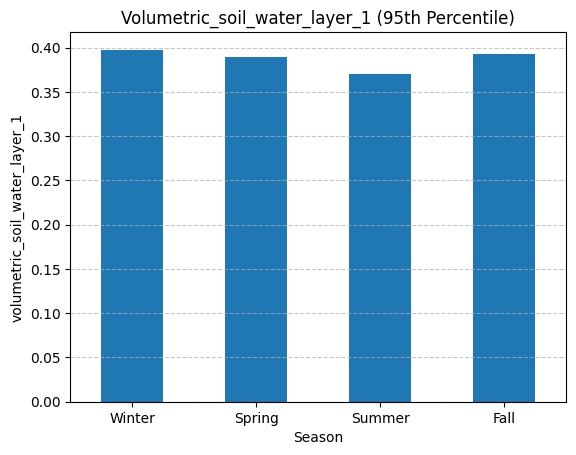


Processing Dataset 2...
After processing volumetric_soil_water_layer_2: min=-0.00041749957017600536, max=0.745419979095459
Performing Seasonal Analysis for Dataset 2...
Seasonal extremes for Dataset 2:
        latitude  longitude  volumetric_soil_water_layer_2  number   step  \
Winter     70.25      55.75                       0.397880     0.0 0 days   
Spring     70.25      55.75                       0.390556     0.0 0 days   
Summer     70.25      55.75                       0.367158     0.0 0 days   
Fall       70.25      55.75                       0.393638     0.0 0 days   

        depthBelowLandLayer  
Winter                  7.0  
Spring                  7.0  
Summer                  7.0  
Fall                    7.0  

Processing Dataset 3...
After processing temperature_2m: min=-30.4718017578125, max=35.897369384765625
After processing wind_u_component: min=-12.856679916381836, max=13.232304573059082
After processing wind_v_component: min=-13.652950286865234, max=10.7078113

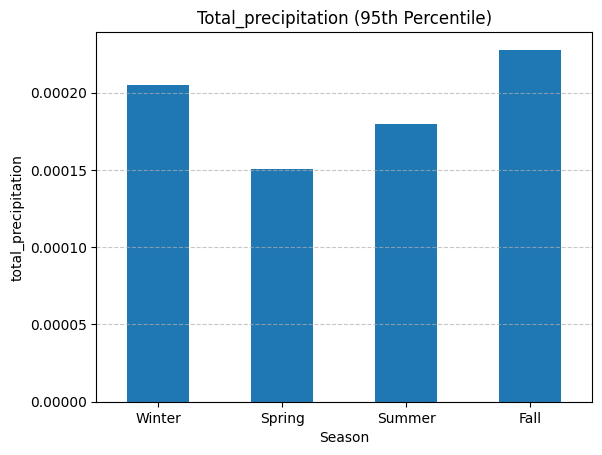

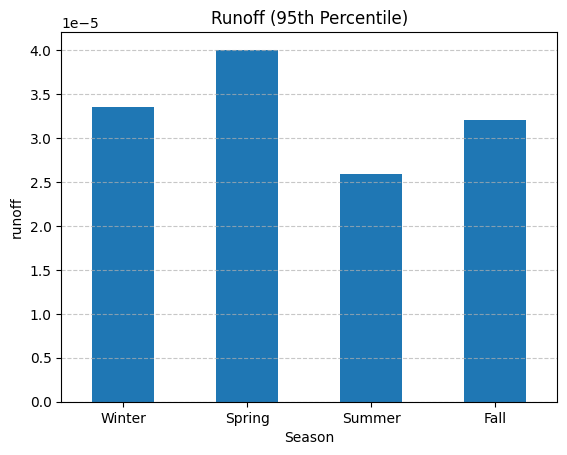

In [36]:
# Dictionary to rename variables for clarity
rename_dict = {
    "t2m": "temperature_2m",
    "tp": "total_precipitation",
    "u10": "wind_u_component",
    "v10": "wind_v_component",
    "d2m": "dewpoint_temperature_2m",
    "sp": "surface_pressure",
    "swvl1": "volumetric_soil_water_layer_1",
    "swvl2": "volumetric_soil_water_layer_2",
    "stl1": "soil_temperature_level_1",
    "smlt": "snowmelt",
    "pev": "potential_evaporation",
    "e": "evaporation",
    "ro": "runoff",
    "slt": "soil_type"
}

# List to store processed datasets
processed_datasets = []

# Process each dataset in the list
for i, ds in enumerate(datasets):
    print(f"\nProcessing Dataset {i + 1}...")

    # Fill missing values with 0
    ds = ds.fillna(0)

    # Remove duplicate time entries
    time_index = pd.Index(ds.time.values)
    if time_index.duplicated().any():
        ds = ds.sel(time=~time_index.duplicated())

    # Validate variable ranges and clean data
    for var in ds.variables:
        if var in rename_dict:
            if "temperature" in rename_dict[var]:
                # Ensure temperature is within reasonable bounds (200-350 K)
                ds[var] = ds[var].where((ds[var] >= 200) & (ds[var] <= 350), float("nan"))
            elif "precipitation" in rename_dict[var]:
                # Ensure precipitation is non-negative
                ds[var] = ds[var].where(ds[var] >= 0, float("nan"))

    # Unit conversions for specific variables
    if "t2m" in ds.variables:
        ds["t2m"] = ds["t2m"] - 273.15  # Kelvin to Celsius
    if "d2m" in ds.variables:
        ds["d2m"] = ds["d2m"] - 273.15
    if "stl1" in ds.variables:
        ds["stl1"] = ds["stl1"] - 273.15
    if "sp" in ds.variables:
        ds["sp"] = ds["sp"] / 100  # Pa to hPa
    if "u10" in ds.variables and "v10" in ds.variables:
        ds["wind_speed"] = (ds["u10"]**2 + ds["v10"]**2)**0.5  # Wind speed

    # Fix missing time steps
    expected_time = pd.date_range(start=str(ds.time.min().values), end=str(ds.time.max().values), freq="1M")
    if not ds.time.equals(expected_time):
        ds = ds.reindex(time=expected_time, method="nearest")

    # Fill gaps and calculate monthly averages
    ds = ds.interpolate_na(dim="time").resample(time="ME").mean()

    # Rename variables for clarity
    existing_vars = set(ds.variables)
    rename_vars = {k: v for k, v in rename_dict.items() if k in existing_vars}
    ds = ds.rename(rename_vars)

    # Debugging: Print variable stats
    for var in rename_vars.values():
        print(f"After processing {var}: min={ds[var].min().values}, max={ds[var].max().values}")

    # Seasonal analysis
    print(f"Performing Seasonal Analysis for Dataset {i + 1}...")
    df = ds.to_dataframe().reset_index()
    df.set_index("time", inplace=True)

    # Add a 'season' column: 1 = Winter, 2 = Spring, 3 = Summer, 4 = Fall
    df["season"] = (df.index.month % 12 // 3) + 1

    # Calculate 95th percentile for key variables by season
    seasonal_extremes = df.groupby("season").quantile(0.95)
    seasonal_extremes.index = ["Winter", "Spring", "Summer", "Fall"]

    # Display seasonal extremes
    print(f"Seasonal extremes for Dataset {i + 1}:")
    print(seasonal_extremes)

    # Plot seasonal extremes for specific variables
    for column in ["total_precipitation", "runoff", "volumetric_soil_water_layer_1"]:
        if column in seasonal_extremes.columns:
            seasonal_extremes[column].plot(
                kind="bar", title=f"{column.capitalize()} (95th Percentile)", ylabel=column
            )
            plt.xlabel("Season")
            plt.xticks(rotation=0)
            plt.grid(axis="y", linestyle="--", alpha=0.7)
            plt.show()

    # Append processed dataset to the list
    processed_datasets.append(ds)

#### Seasonal Precipitation Averages


Performing Spatial Analysis for Dataset 4...


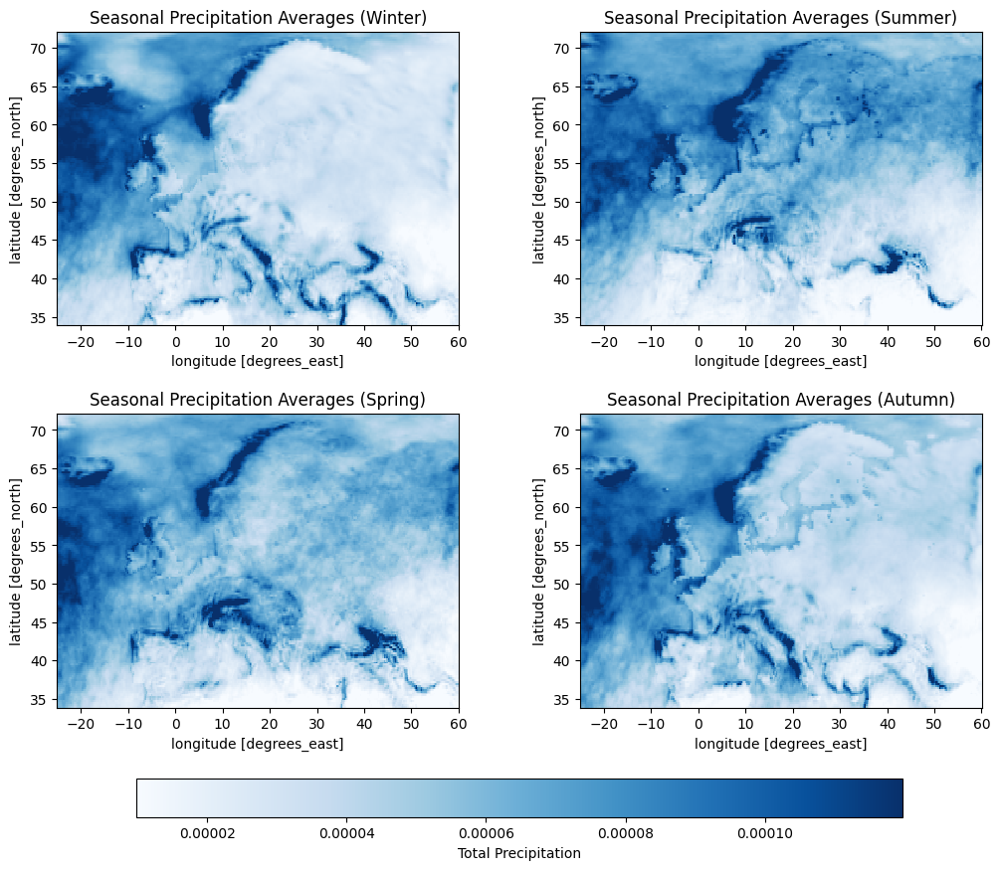

In [37]:
# Spatial Analysis of Seasonal Averages
print(f"\nPerforming Spatial Analysis for Dataset {i + 1}...")
if "total_precipitation" in processed_datasets[3].variables:
    # Map seasons to full names
    season_mapping = {"DJF": "Winter", "MAM": "Spring", "JJA": "Summer", "SON": "Autumn"}

    # Calculate seasonal averages
    seasonal_avg_map = processed_datasets[3]["total_precipitation"].groupby("time.season").mean()

    # Replace season abbreviations with full names
    seasonal_avg_map["season"] = xr.DataArray(
        [season_mapping[season] for season in seasonal_avg_map.season.data],
        dims="season",
    )

    # Determine consistent scale for plots
    global_min = seasonal_avg_map.min().values
    global_max = seasonal_avg_map.max().values

    # Create subplots for each season
    fig, axes = plt.subplots(2, 2, figsize=(12, 10))
    axes = axes.flatten()

    for ax, season in zip(axes, seasonal_avg_map.season.data):
        spatial_data = seasonal_avg_map.sel(season=season)

        if "latitude" in spatial_data.dims and "longitude" in spatial_data.dims:
            # Ensure data is 2D
            spatial_data = spatial_data.mean(dim=set(spatial_data.dims) - {"latitude", "longitude"})
            im = spatial_data.plot.imshow(
                ax=ax,
                cmap="Blues",
                robust=True,
                add_colorbar=False
            )
            ax.set_title(f"Seasonal Precipitation Averages ({season})")
        else:
            ax.set_title(f"Skipping {season} (no spatial dimensions)")
            ax.axis("off")

    # Add a single colorbar for all plots
    cbar = fig.colorbar(im, ax=axes, orientation="horizontal", fraction=0.05, pad=0.2)
    cbar.set_label("Total Precipitation")

    # Adjust layout for clarity
    fig.subplots_adjust(hspace=0.3, wspace=0.3, bottom=0.22, top=0.9)
    plt.show()
    

#### Explore Correlations & Convert from Datasets to Dataframes and Combine them

In [8]:
# Print variables for each dataset
for i, ds in enumerate(processed_datasets):
    print(f"\nVariables in Dataset {i}:")
    for var in ds.variables:
        print(f"- {var}")


Variables in Dataset 0:
- volumetric_soil_water_layer_1
- soil_temperature_level_1
- latitude
- longitude
- number
- step
- depthBelowLandLayer
- time

Variables in Dataset 1:
- volumetric_soil_water_layer_2
- latitude
- longitude
- number
- step
- depthBelowLandLayer
- time

Variables in Dataset 2:
- soil_type
- surface_pressure
- wind_u_component
- wind_v_component
- temperature_2m
- dewpoint_temperature_2m
- wind_speed
- latitude
- longitude
- number
- step
- surface
- time

Variables in Dataset 3:
- snowmelt
- evaporation
- runoff
- total_precipitation
- potential_evaporation
- step
- latitude
- longitude
- number
- surface
- time


In [38]:
# Define Variables of Interest
variables_of_interest = [
    "temperature_2m",
    "total_precipitation",
    "wind_u_component",
    "wind_v_component",
    "dewpoint_temperature_2m",
    "surface_pressure",
    "volumetric_soil_water_layer_1",
    "volumetric_soil_water_layer_2",
    "soil_temperature_level_1",
    "snowmelt",
    "potential_evaporation",
    "evaporation",
    "runoff",
    "soil_type"
]

# Prepare a list to store DataFrames for correlation analysis
data_frames = []

for i, ds in enumerate(processed_datasets):
    print(f"Processing Dataset {i + 1} for correlation analysis...")

    # Filter variables of interest present in the dataset
    available_vars = [var for var in variables_of_interest if var in ds]
    print(f"Variables available in Dataset {i + 1}: {available_vars}")

    # Skip datasets without any variables of interest
    if not available_vars:
        print(f"Dataset {i + 1} contains no variables of interest. Skipping.")
        continue

    # Convert selected variables to DataFrame and combine
    selected_vars = {var: ds[var].to_dataframe() for var in available_vars}
    combined_df = pd.concat(selected_vars.values(), axis=1)

    # Align by the time index and calculate mean for duplicates
    combined_df = combined_df.groupby(level="time").mean()

    # Append the combined DataFrame to the list
    data_frames.append(combined_df)

# Combine all DataFrames from the datasets
data_frames_combined = pd.concat(data_frames, axis=1) if data_frames else None

if data_frames_combined is not None:

    # Drop rows with missing values
    merged_data = data_frames_combined.dropna()
    print(f"Merged data shape: {merged_data.shape}")
    # Select only variables of interest for correlation analysis
    selected_columns = [col for col in variables_of_interest if col in merged_data.columns]
    filtered_data = merged_data[selected_columns]
    print(f"Filtered data shape: {filtered_data.shape}")

    # Compute and display the correlation matrix
    print("\nComputing correlation matrix...")
    correlation_matrix = filtered_data.corr()
    ## print(correlation_matrix)
else:
    print("\nNo valid data for correlation analysis.")


Processing Dataset 1 for correlation analysis...
Variables available in Dataset 1: ['volumetric_soil_water_layer_1', 'soil_temperature_level_1']
Processing Dataset 2 for correlation analysis...
Variables available in Dataset 2: ['volumetric_soil_water_layer_2']
Processing Dataset 3 for correlation analysis...
Variables available in Dataset 3: ['temperature_2m', 'wind_u_component', 'wind_v_component', 'dewpoint_temperature_2m', 'surface_pressure', 'soil_type']
Processing Dataset 4 for correlation analysis...
Variables available in Dataset 4: ['total_precipitation', 'snowmelt', 'potential_evaporation', 'evaporation', 'runoff']
Merged data shape: (131, 51)
Filtered data shape: (131, 14)

Computing correlation matrix...


#### Visualize Relationships Using Scatter Plots or Heatmaps


Visualizing pairwise relationships...


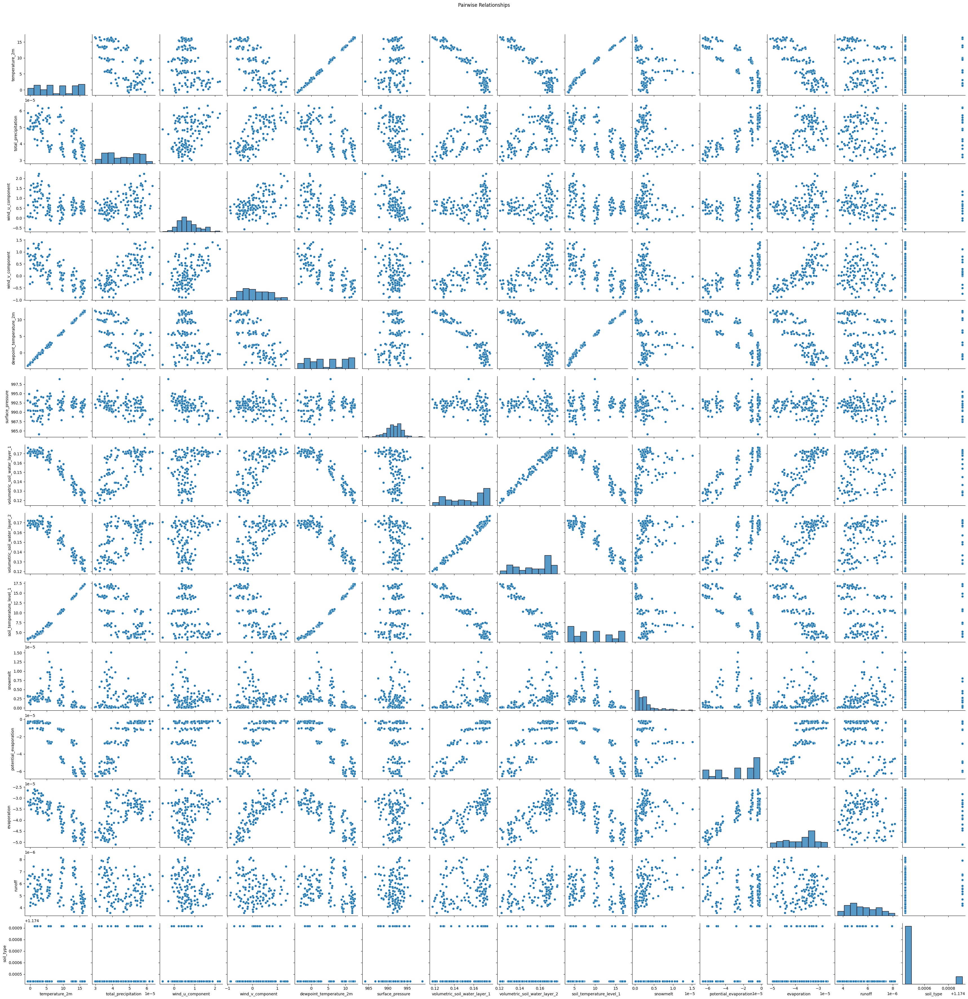


Heatmap of the correlation matrix...


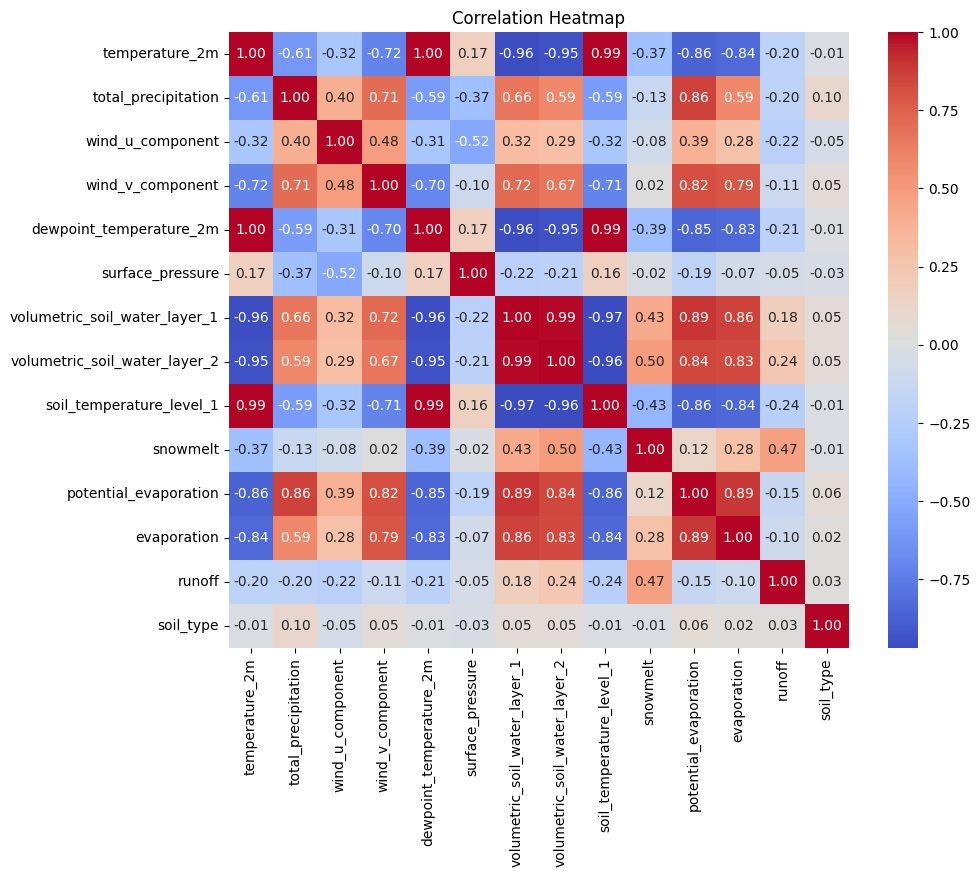

In [10]:
# Visualize Relationships Using Scatter Plots and Heatmaps
print("\nVisualizing pairwise relationships...")

# Scatter plot for pairwise relationships
sns.pairplot(merged_data[selected_columns])
plt.suptitle("Pairwise Relationships", y=1.02)
plt.show()

# Heatmap for the correlation matrix
print("\nHeatmap of the correlation matrix...")
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)
plt.title("Correlation Heatmap")
plt.show()

#### Check for Lagged Correlations between total_precipitation and volumetric_soil_water_layer_1


Checking for lagged correlations...
Lag 1: Correlation between total_precipitation and volumetric_soil_water_layer_1 = 0.87
Lag 2: Correlation between total_precipitation and volumetric_soil_water_layer_1 = 0.83
Lag 3: Correlation between total_precipitation and volumetric_soil_water_layer_1 = 0.60
Lag 4: Correlation between total_precipitation and volumetric_soil_water_layer_1 = 0.21
Lag 5: Correlation between total_precipitation and volumetric_soil_water_layer_1 = -0.23
Lag 6: Correlation between total_precipitation and volumetric_soil_water_layer_1 = -0.62


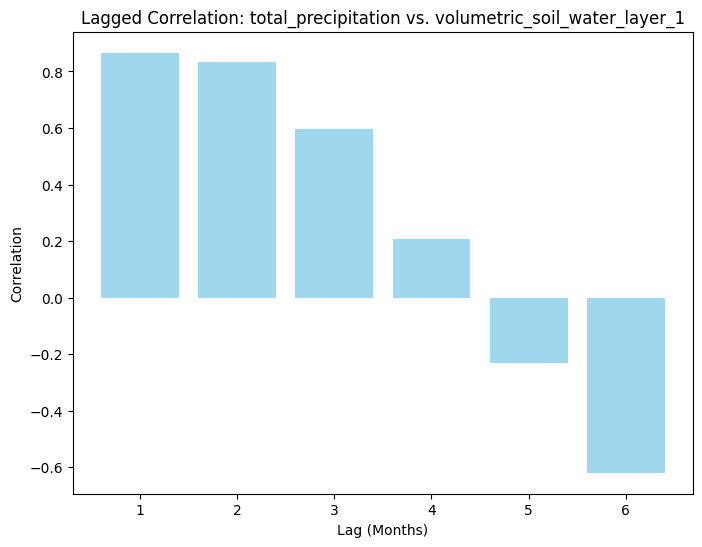

In [11]:
# Lagged Correlation Analysis
print("\nChecking for lagged correlations...")

# Define variables to analyze lagged correlation (e.g., precipitation vs. soil water levels)
lag_variable = "total_precipitation"
response_variable = "volumetric_soil_water_layer_1"

# Maximum number of lags to check
max_lag = 6

# Calculate lagged correlations
lagged_correlations = []
for lag in range(1, max_lag + 1):
    shifted_data = merged_data[lag_variable].shift(lag)  # Shift precipitation data by 'lag' months
    correlation = merged_data[response_variable].corr(shifted_data)
    lagged_correlations.append((lag, correlation))
    print(f"Lag {lag}: Correlation between {lag_variable} and {response_variable} = {correlation:.2f}")

# Visualize lagged correlations
lags, correlations = zip(*lagged_correlations)
plt.figure(figsize=(8, 6))
plt.bar(lags, correlations, color="skyblue", alpha=0.8)
plt.xlabel("Lag (Months)")
plt.ylabel("Correlation")
plt.title(f"Lagged Correlation: {lag_variable} vs. {response_variable}")
plt.xticks(lags)
plt.show()

#### Calculate lagged correlations between temperature_2m and volumetric_soil_water_layer_1


Step 7: Checking for lagged correlations...
Lag 1: Correlation between temperature_2m and volumetric_soil_water_layer_1 = -0.79
Lag 2: Correlation between temperature_2m and volumetric_soil_water_layer_1 = -0.40
Lag 3: Correlation between temperature_2m and volumetric_soil_water_layer_1 = 0.09
Lag 4: Correlation between temperature_2m and volumetric_soil_water_layer_1 = 0.54
Lag 5: Correlation between temperature_2m and volumetric_soil_water_layer_1 = 0.84
Lag 6: Correlation between temperature_2m and volumetric_soil_water_layer_1 = 0.93


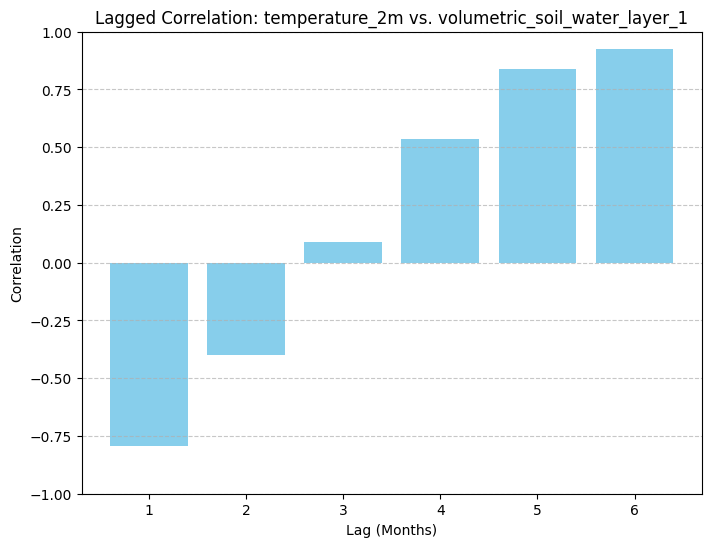

In [12]:
# Define variables for lagged correlation
lag_variable = "temperature_2m"  # Predictor variable
response_variable = "volumetric_soil_water_layer_1"  # Response variable
max_lag = 6  # Maximum lag to test (in months)

# Initialize a list to store lagged correlations
lagged_correlations = []

print("\nStep 7: Checking for lagged correlations...")
for lag in range(1, max_lag + 1):
    # Shift the temperature data by 'lag' months
    shifted_data = merged_data[lag_variable].shift(lag)
    
    # Compute the correlation with soil water content
    correlation = merged_data[response_variable].corr(shifted_data)
    
    # Store the lag and correlation
    lagged_correlations.append((lag, correlation))
    print(f"Lag {lag}: Correlation between {lag_variable} and {response_variable} = {correlation:.2f}")

# Convert lagged correlations into a DataFrame for visualization
lagged_df = pd.DataFrame(lagged_correlations, columns=["Lag (Months)", "Correlation"])

# Plot lagged correlations
plt.figure(figsize=(8, 6))
plt.bar(lagged_df["Lag (Months)"], lagged_df["Correlation"], color="skyblue")
plt.xlabel("Lag (Months)")
plt.ylabel("Correlation")
plt.title(f"Lagged Correlation: {lag_variable} vs. {response_variable}")
plt.xticks(range(1, max_lag + 1))
plt.ylim(-1, 1)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.show()


#### Calculate lagged correlations between total_precipitation and runoff (Analyze rainfall impact on runoff)


Step: Checking for lagged correlations...
Lag 1: Correlation between total_precipitation and runoff = 0.09
Lag 2: Correlation between total_precipitation and runoff = 0.34
Lag 3: Correlation between total_precipitation and runoff = 0.53
Lag 4: Correlation between total_precipitation and runoff = 0.57
Lag 5: Correlation between total_precipitation and runoff = 0.49
Lag 6: Correlation between total_precipitation and runoff = 0.30


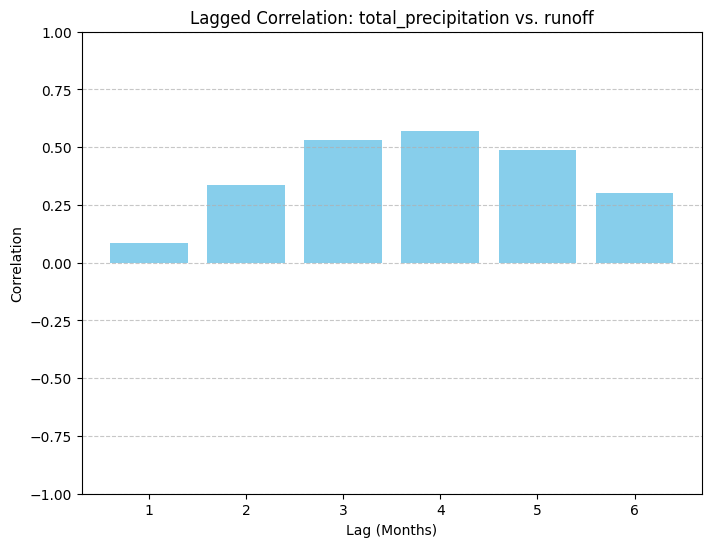

In [13]:
# Variables to analyze lagged correlation
lag_variable = "total_precipitation"  # Predictor variable (rainfall)
response_variable = "runoff"  # Response variable (runoff)
max_lag = 6  # Maximum lag to test (in months)

# Initialize a list to store lagged correlations
lagged_correlations = []

print("\nStep: Checking for lagged correlations...")
for lag in range(1, max_lag + 1):
    # Shift the predictor variable by 'lag' months
    shifted_data = filtered_data[lag_variable].shift(lag)
    
    # Compute correlation with the response variable
    correlation = filtered_data[response_variable].corr(shifted_data)
    
    # Store the lag and correlation
    lagged_correlations.append((lag, correlation))
    print(f"Lag {lag}: Correlation between {lag_variable} and {response_variable} = {correlation:.2f}")

# Convert lagged correlations into a DataFrame for visualization
lagged_df = pd.DataFrame(lagged_correlations, columns=["Lag (Months)", "Correlation"])

# Plot lagged correlations
plt.figure(figsize=(8, 6))
plt.bar(lagged_df["Lag (Months)"], lagged_df["Correlation"], color="skyblue")
plt.xlabel("Lag (Months)")
plt.ylabel("Correlation")
plt.title(f"Lagged Correlation: {lag_variable} vs. {response_variable}")
plt.xticks(range(1, max_lag + 1))
plt.ylim(-1, 1)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.show()


#### Calculate lagged correlations between snowmelt and volumetric_soil_water_layer_2 
#### (Analyze snowmelt's delayed effects on deeper soil water)


Step: Checking for lagged correlations...
Lag 1: Correlation between snowmelt and volumetric_soil_water_layer_2 = 0.06
Lag 2: Correlation between snowmelt and volumetric_soil_water_layer_2 = -0.36
Lag 3: Correlation between snowmelt and volumetric_soil_water_layer_2 = -0.63
Lag 4: Correlation between snowmelt and volumetric_soil_water_layer_2 = -0.65
Lag 5: Correlation between snowmelt and volumetric_soil_water_layer_2 = -0.46
Lag 6: Correlation between snowmelt and volumetric_soil_water_layer_2 = -0.19


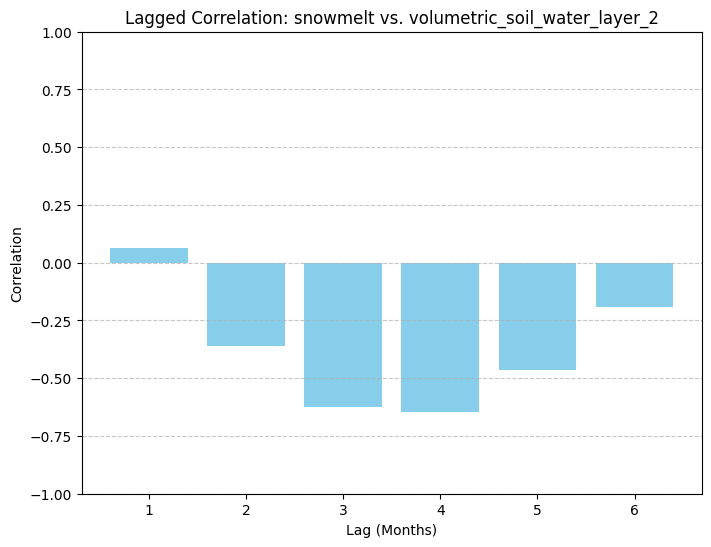

In [14]:
# Variables to analyze lagged correlation
lag_variable = "snowmelt"  # Predictor variable (snowmelt)
response_variable = "volumetric_soil_water_layer_2"  # Response variable (deep soil water)
max_lag = 6  # Maximum lag to test (in months)

# Initialize a list to store lagged correlations
lagged_correlations = []

print("\nStep: Checking for lagged correlations...")
for lag in range(1, max_lag + 1):
    # Shift the predictor variable by 'lag' months
    shifted_data = filtered_data[lag_variable].shift(lag)
    
    # Compute correlation with the response variable
    correlation = filtered_data[response_variable].corr(shifted_data)
    
    # Store the lag and correlation
    lagged_correlations.append((lag, correlation))
    print(f"Lag {lag}: Correlation between {lag_variable} and {response_variable} = {correlation:.2f}")

# Convert lagged correlations into a DataFrame for visualization
lagged_df = pd.DataFrame(lagged_correlations, columns=["Lag (Months)", "Correlation"])

# Plot lagged correlations
plt.figure(figsize=(8, 6))
plt.bar(lagged_df["Lag (Months)"], lagged_df["Correlation"], color="skyblue")
plt.xlabel("Lag (Months)")
plt.ylabel("Correlation")
plt.title(f"Lagged Correlation: {lag_variable} vs. {response_variable}")
plt.xticks(range(1, max_lag + 1))
plt.ylim(-1, 1)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.show()


#### Calculate lagged correlations between temperature_2m and potential_evaporation 
#### (Study how temperature impacts evaporation over time)


Step: Checking for lagged correlations...
Lag 1: Correlation between temperature_2m and potential_evaporation = -0.51
Lag 2: Correlation between temperature_2m and potential_evaporation = -0.02
Lag 3: Correlation between temperature_2m and potential_evaporation = 0.46
Lag 4: Correlation between temperature_2m and potential_evaporation = 0.80
Lag 5: Correlation between temperature_2m and potential_evaporation = 0.94
Lag 6: Correlation between temperature_2m and potential_evaporation = 0.84


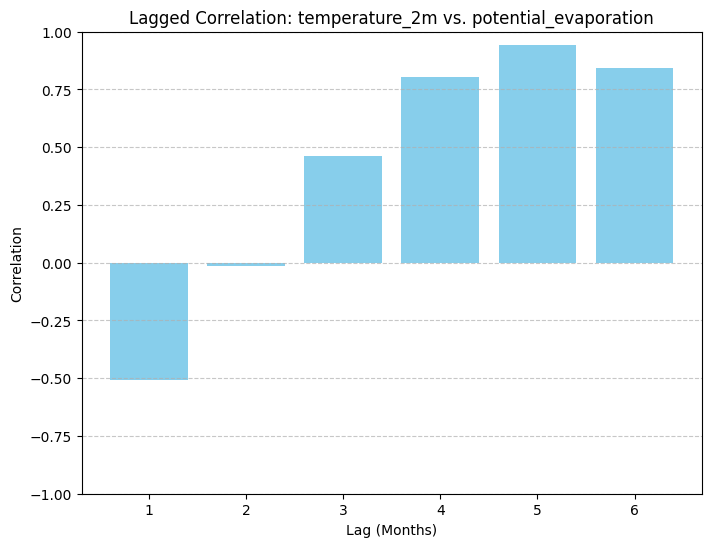

In [15]:
# Variables to analyze lagged correlation
lag_variable = "temperature_2m"  # Predictor variable (temperature)
response_variable = "potential_evaporation"  # Response variable (evaporation potential)
max_lag = 6  # Maximum lag to test (in months)

# Initialize a list to store lagged correlations
lagged_correlations = []

print("\nStep: Checking for lagged correlations...")
for lag in range(1, max_lag + 1):
    # Shift the predictor variable by 'lag' months
    shifted_data = filtered_data[lag_variable].shift(lag)
    
    # Compute correlation with the response variable
    correlation = filtered_data[response_variable].corr(shifted_data)
    
    # Store the lag and correlation
    lagged_correlations.append((lag, correlation))
    print(f"Lag {lag}: Correlation between {lag_variable} and {response_variable} = {correlation:.2f}")

# Convert lagged correlations into a DataFrame for visualization
lagged_df = pd.DataFrame(lagged_correlations, columns=["Lag (Months)", "Correlation"])

# Plot lagged correlations
plt.figure(figsize=(8, 6))
plt.bar(lagged_df["Lag (Months)"], lagged_df["Correlation"], color="skyblue")
plt.xlabel("Lag (Months)")
plt.ylabel("Correlation")
plt.title(f"Lagged Correlation: {lag_variable} vs. {response_variable}")
plt.xticks(range(1, max_lag + 1))
plt.ylim(-1, 1)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.show()


#### Trend Analysis


Analyzing trend for: temperature_2m...


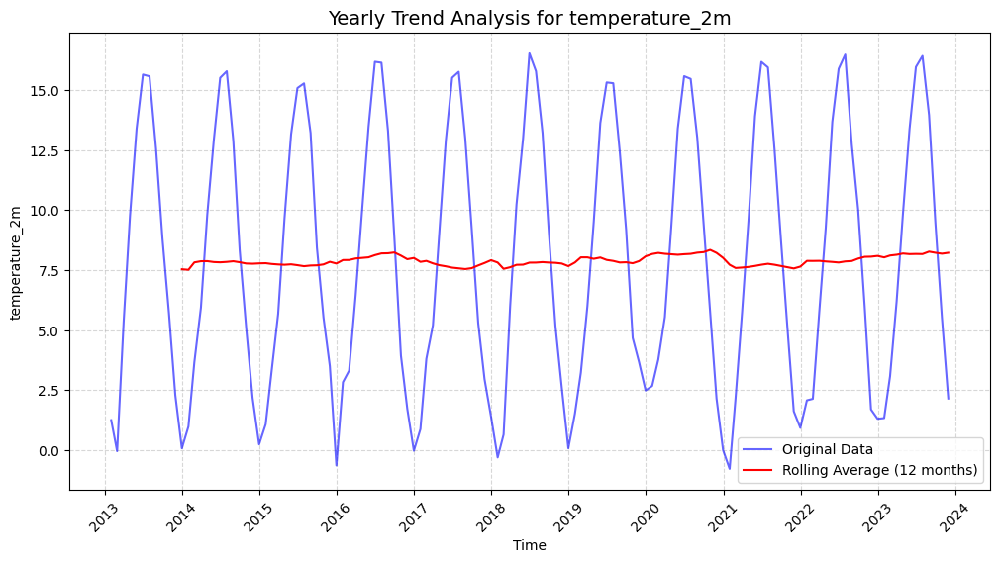

C:\Users\giann\AppData\Local\Temp\ipykernel_17548\573293066.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['season'] = (merged_data.index.month % 12 // 3) + 1


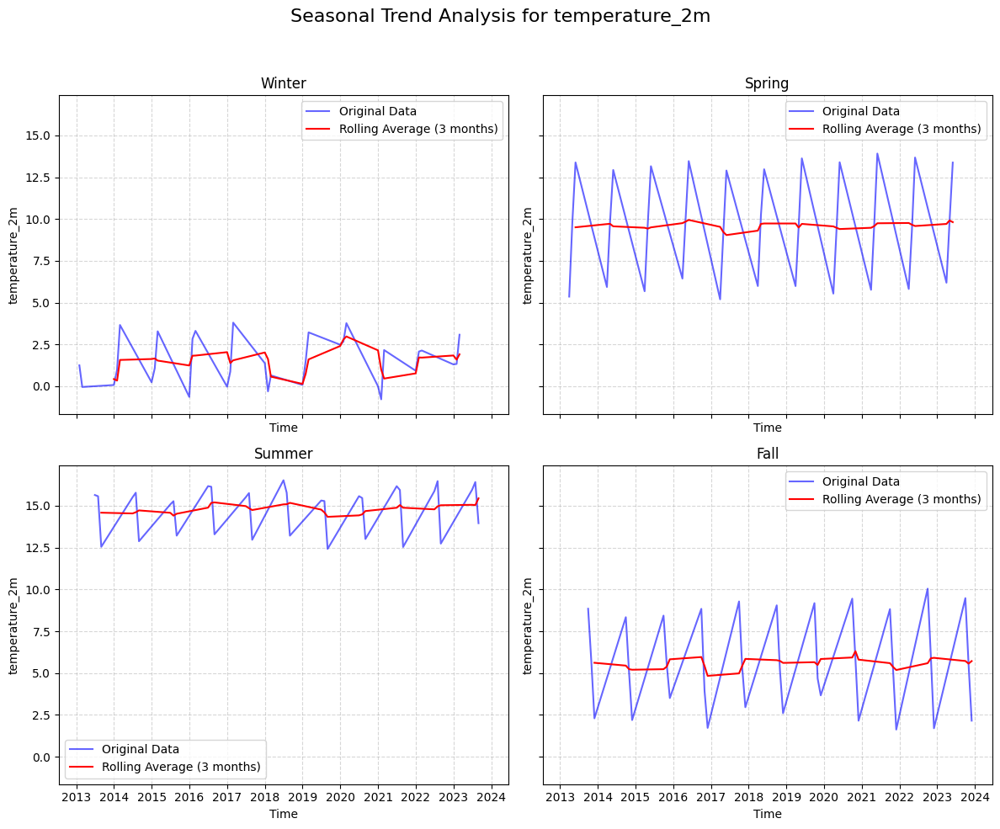


Analyzing trend for: total_precipitation...


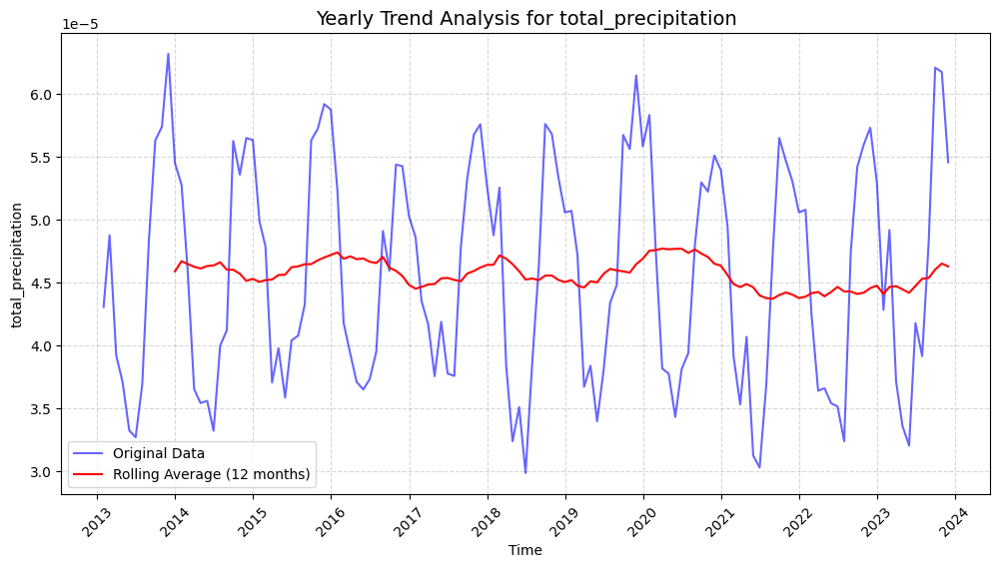

C:\Users\giann\AppData\Local\Temp\ipykernel_17548\573293066.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['season'] = (merged_data.index.month % 12 // 3) + 1


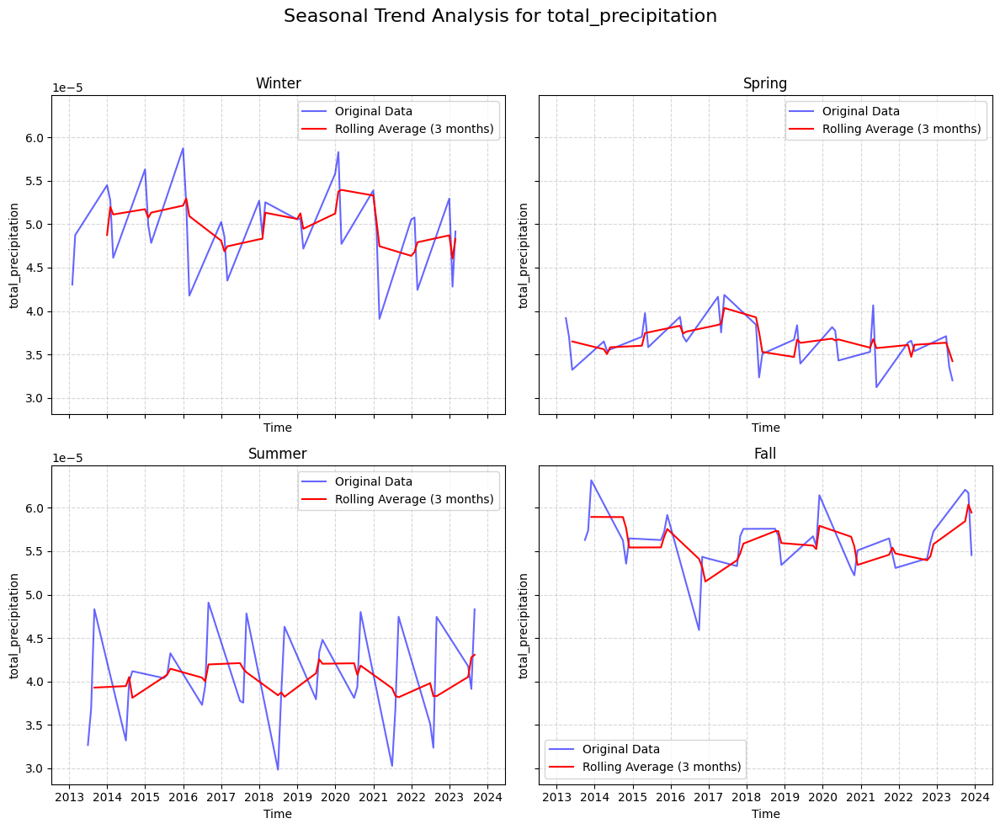


Analyzing trend for: wind_u_component...


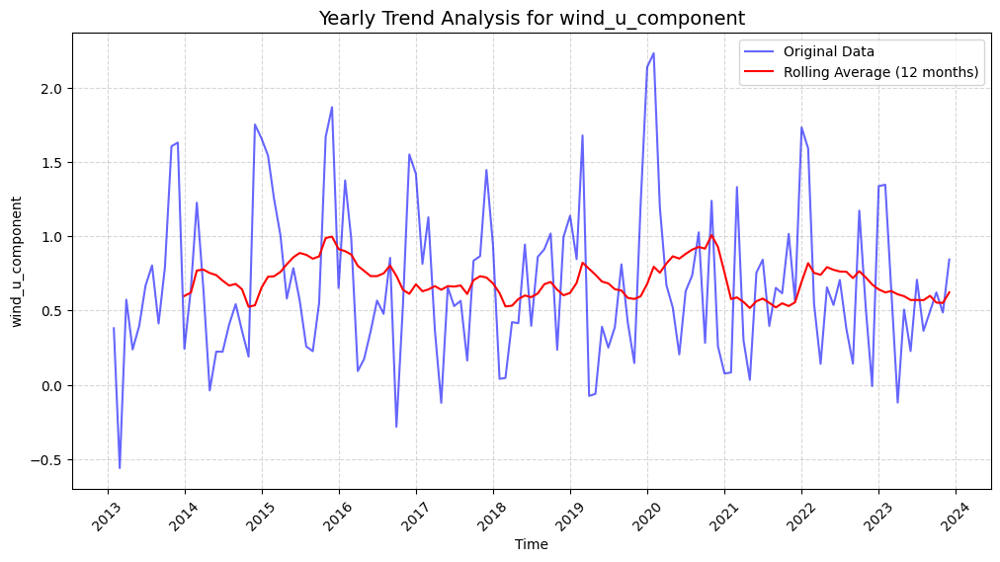

C:\Users\giann\AppData\Local\Temp\ipykernel_17548\573293066.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['season'] = (merged_data.index.month % 12 // 3) + 1


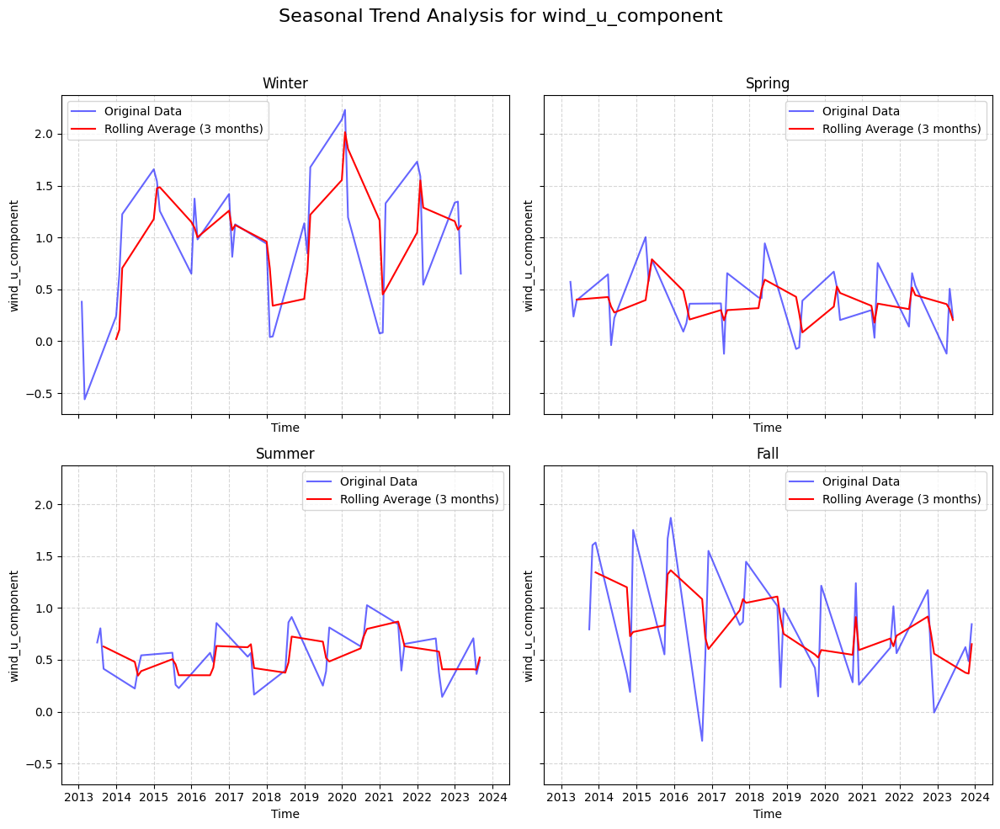


Analyzing trend for: wind_v_component...


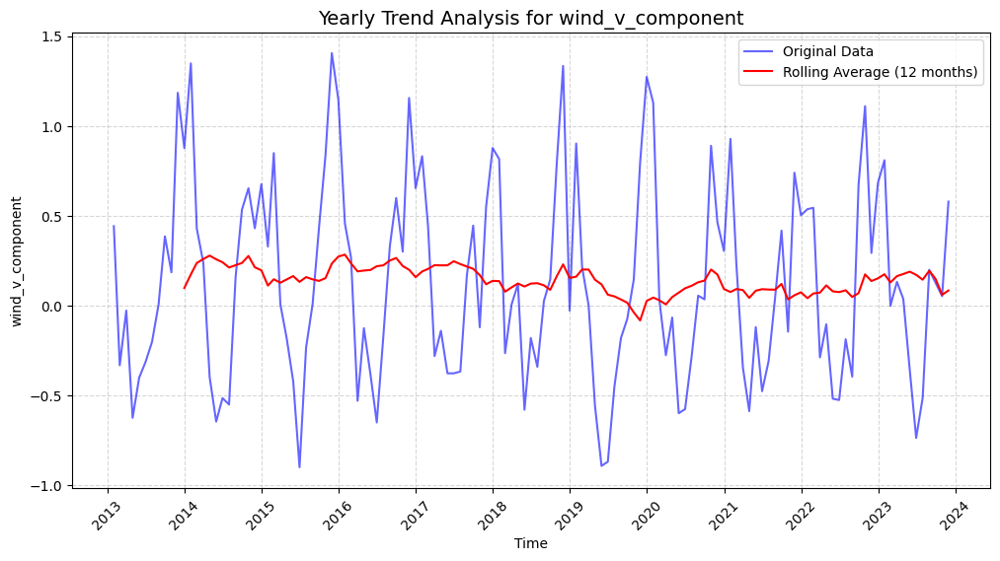

C:\Users\giann\AppData\Local\Temp\ipykernel_17548\573293066.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['season'] = (merged_data.index.month % 12 // 3) + 1


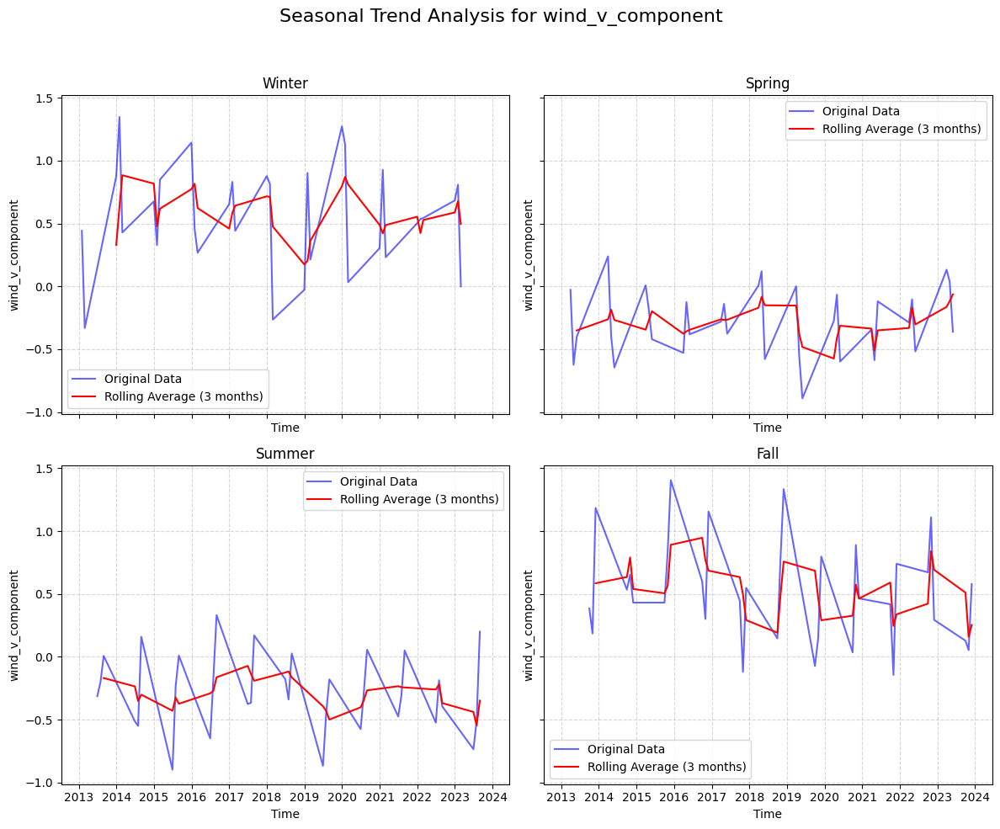


Analyzing trend for: dewpoint_temperature_2m...


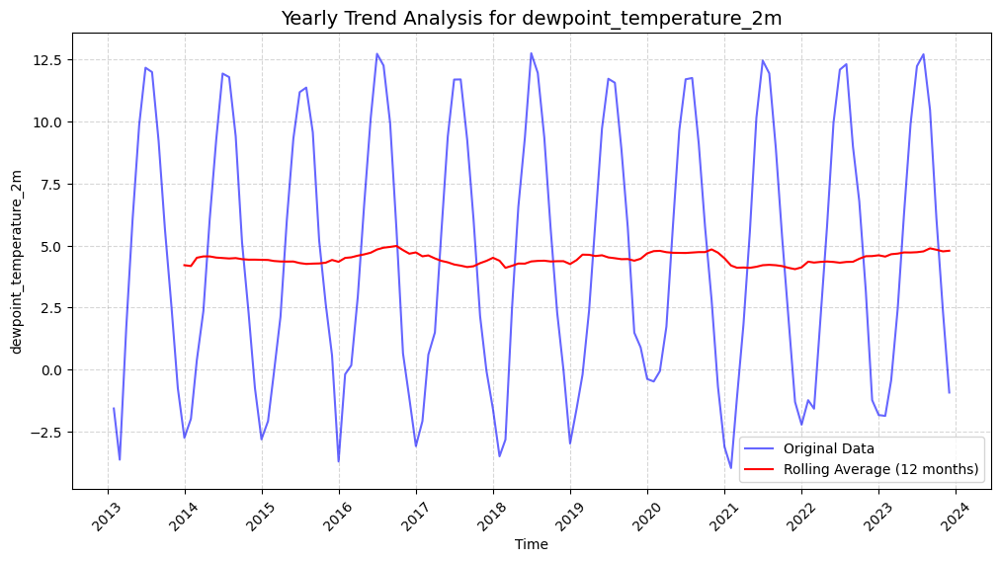

C:\Users\giann\AppData\Local\Temp\ipykernel_17548\573293066.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['season'] = (merged_data.index.month % 12 // 3) + 1


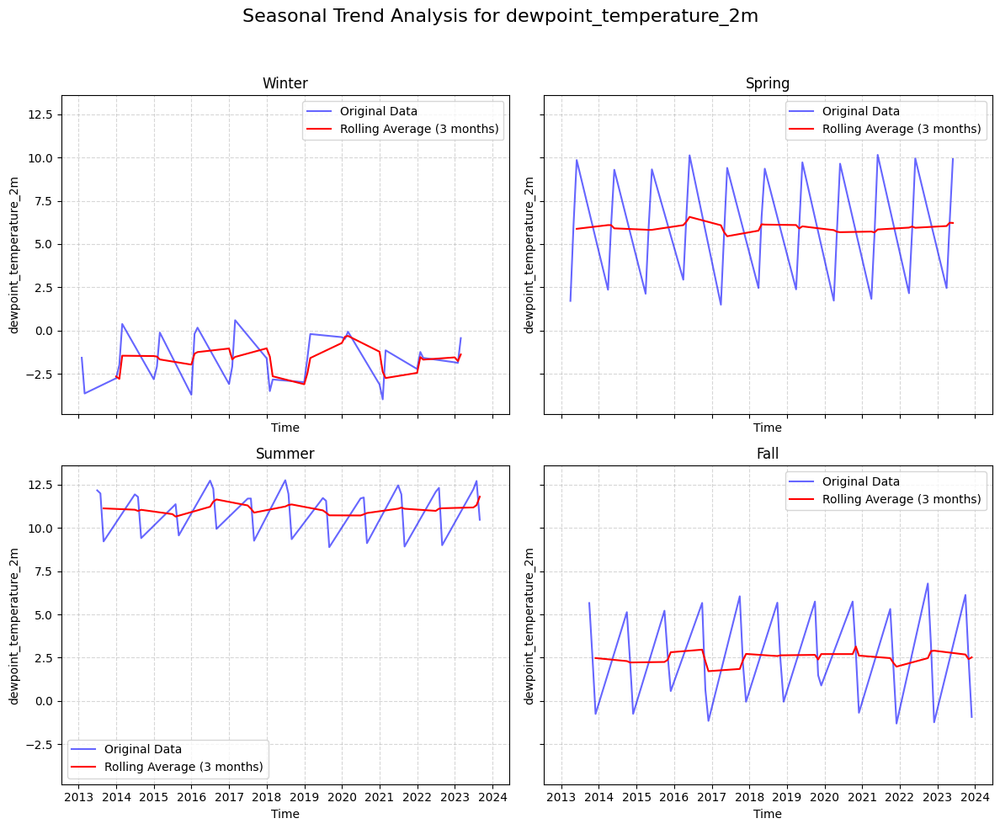


Analyzing trend for: surface_pressure...


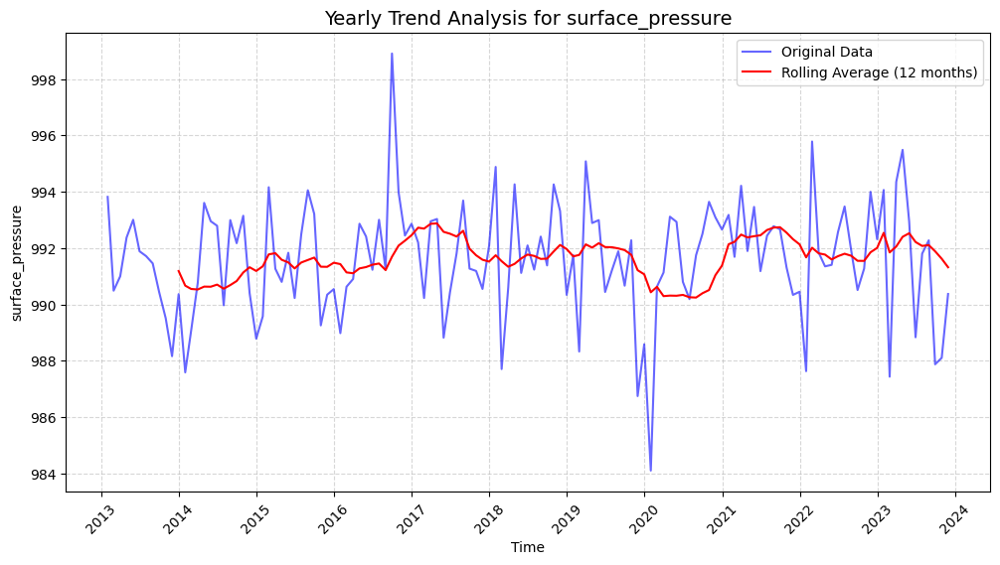

C:\Users\giann\AppData\Local\Temp\ipykernel_17548\573293066.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['season'] = (merged_data.index.month % 12 // 3) + 1


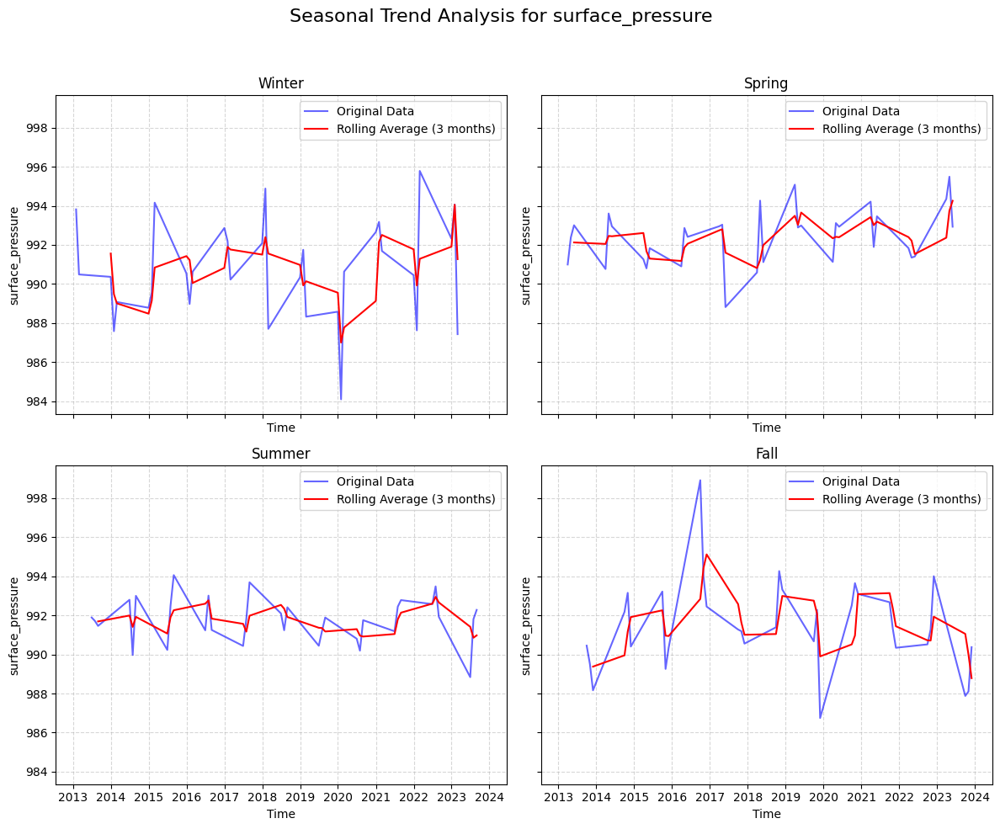


Analyzing trend for: volumetric_soil_water_layer_1...


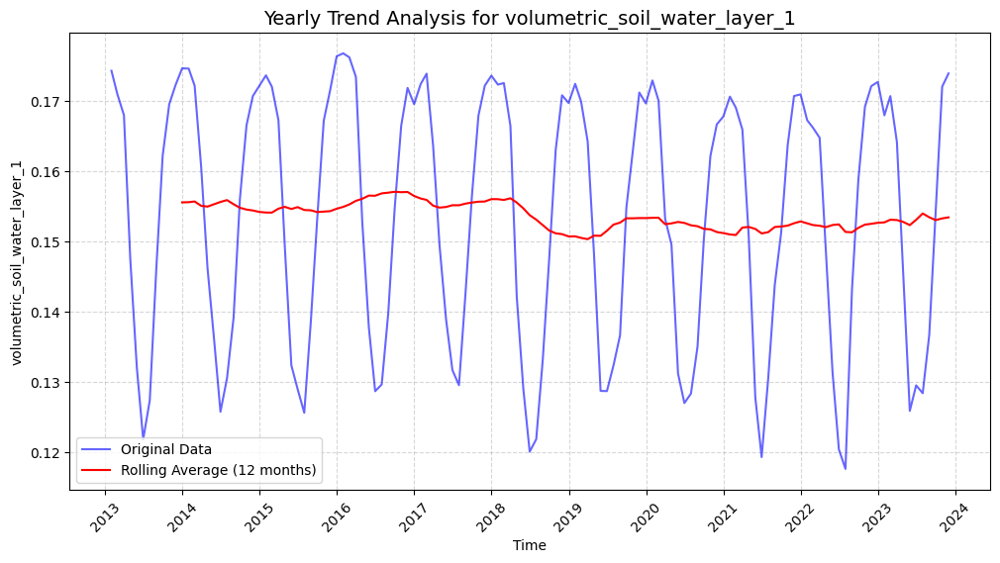

C:\Users\giann\AppData\Local\Temp\ipykernel_17548\573293066.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['season'] = (merged_data.index.month % 12 // 3) + 1


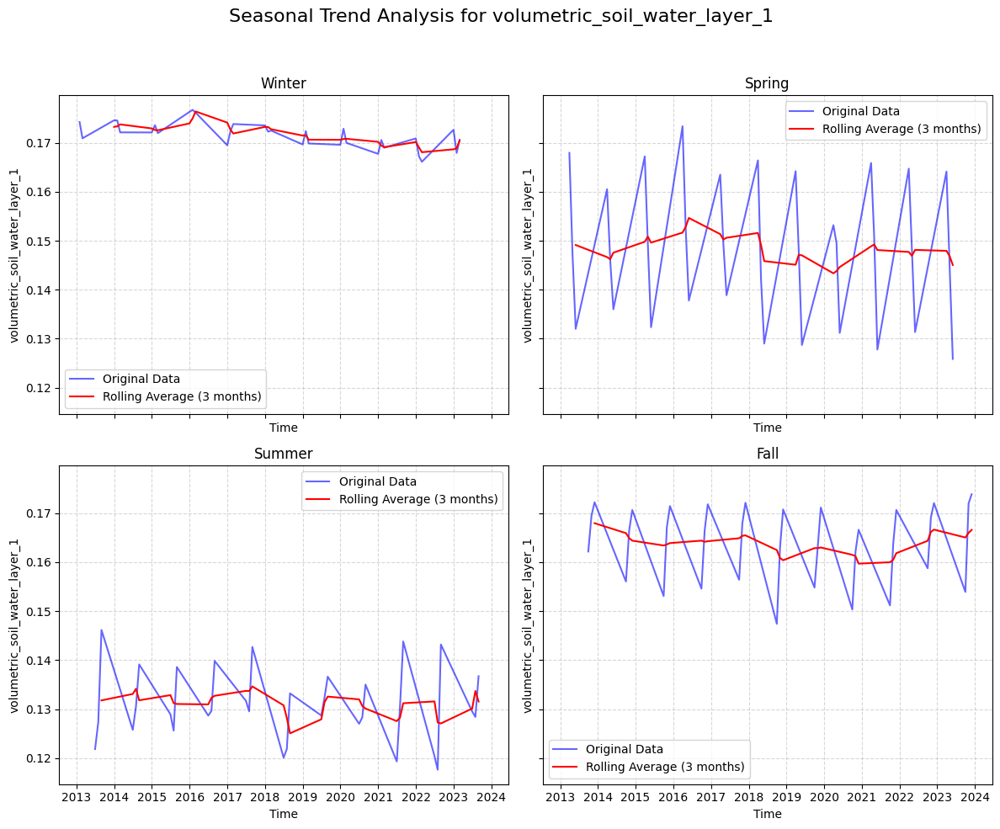


Analyzing trend for: volumetric_soil_water_layer_2...


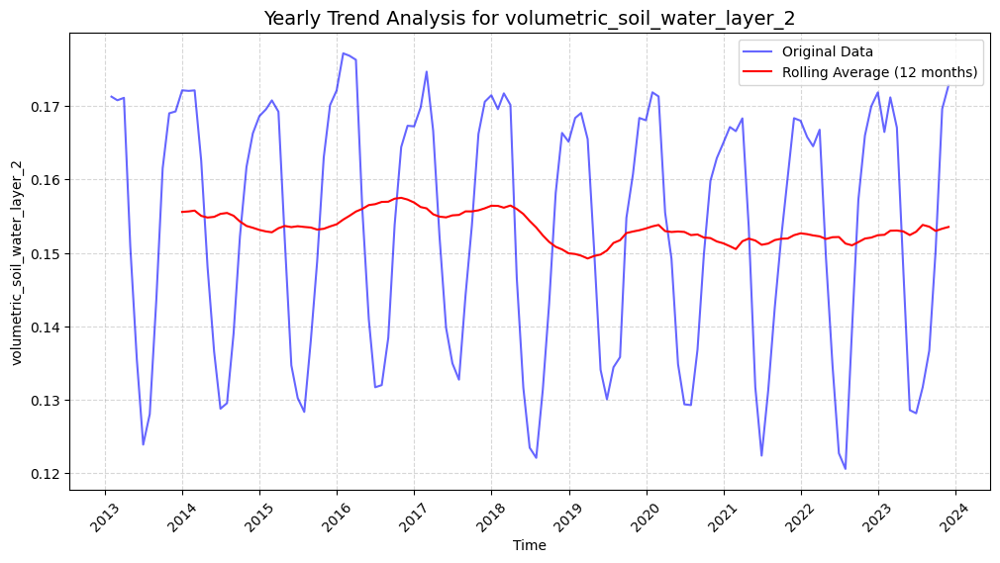

C:\Users\giann\AppData\Local\Temp\ipykernel_17548\573293066.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['season'] = (merged_data.index.month % 12 // 3) + 1


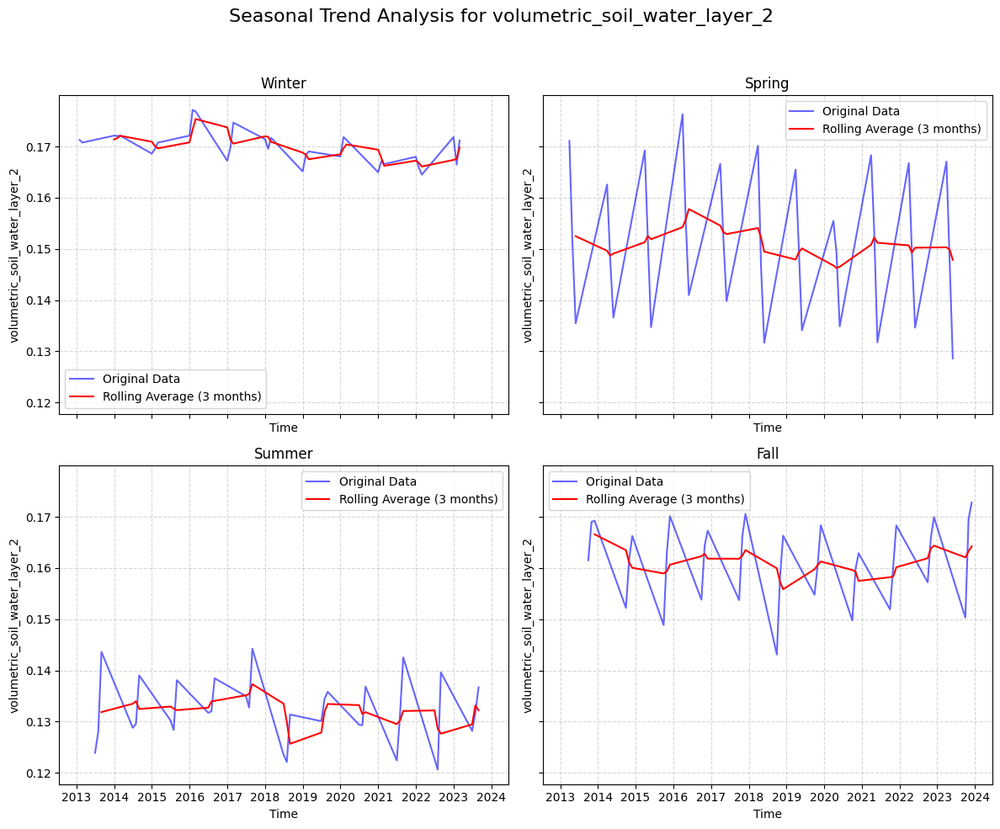


Analyzing trend for: soil_temperature_level_1...


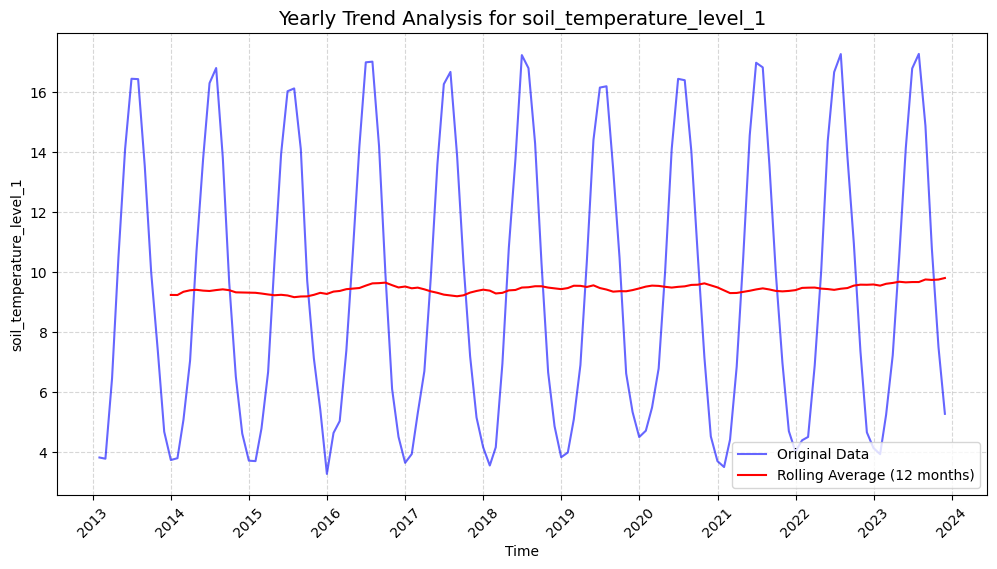

C:\Users\giann\AppData\Local\Temp\ipykernel_17548\573293066.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['season'] = (merged_data.index.month % 12 // 3) + 1


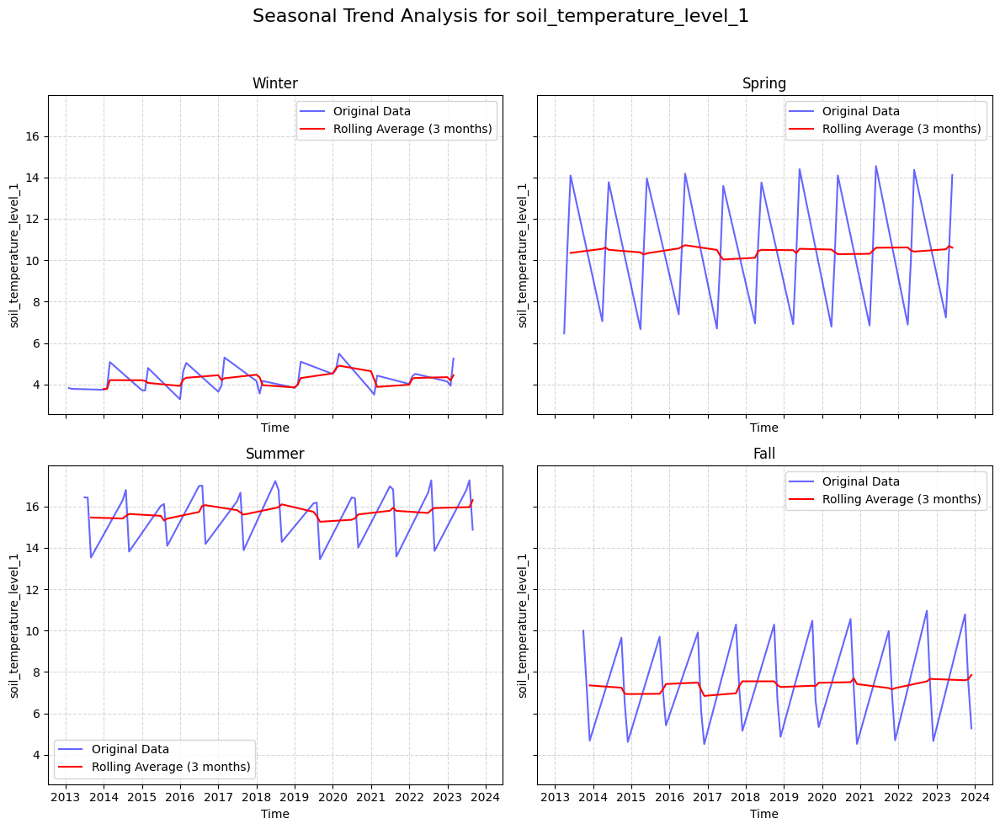


Analyzing trend for: snowmelt...


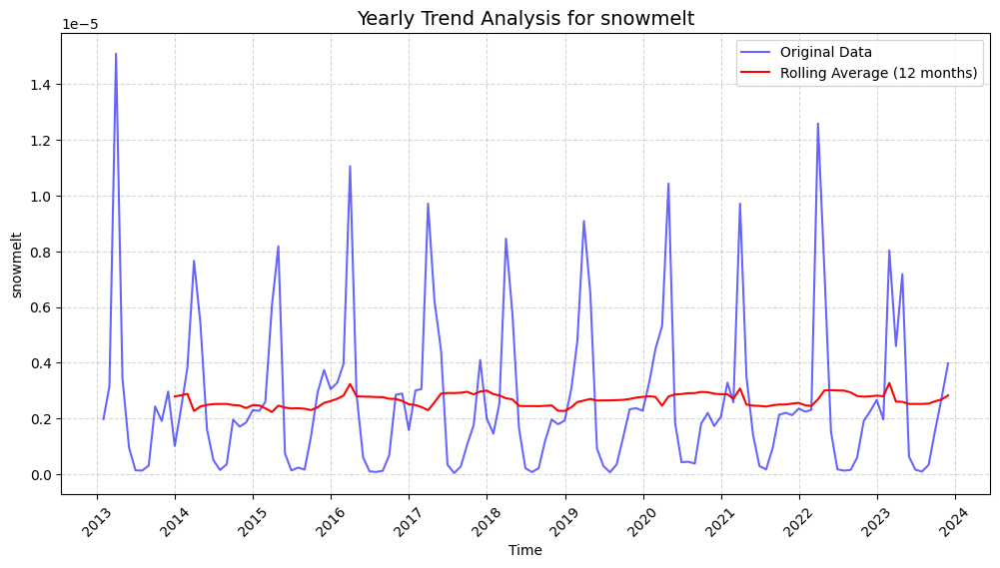

C:\Users\giann\AppData\Local\Temp\ipykernel_17548\573293066.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['season'] = (merged_data.index.month % 12 // 3) + 1


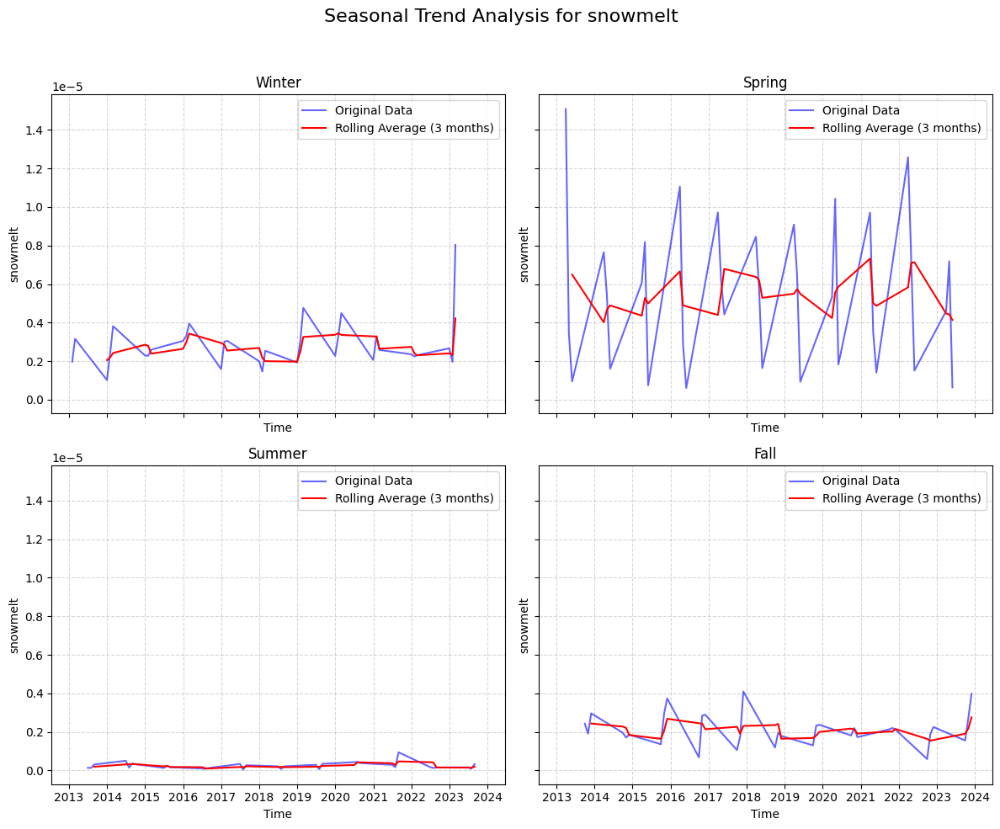


Analyzing trend for: potential_evaporation...


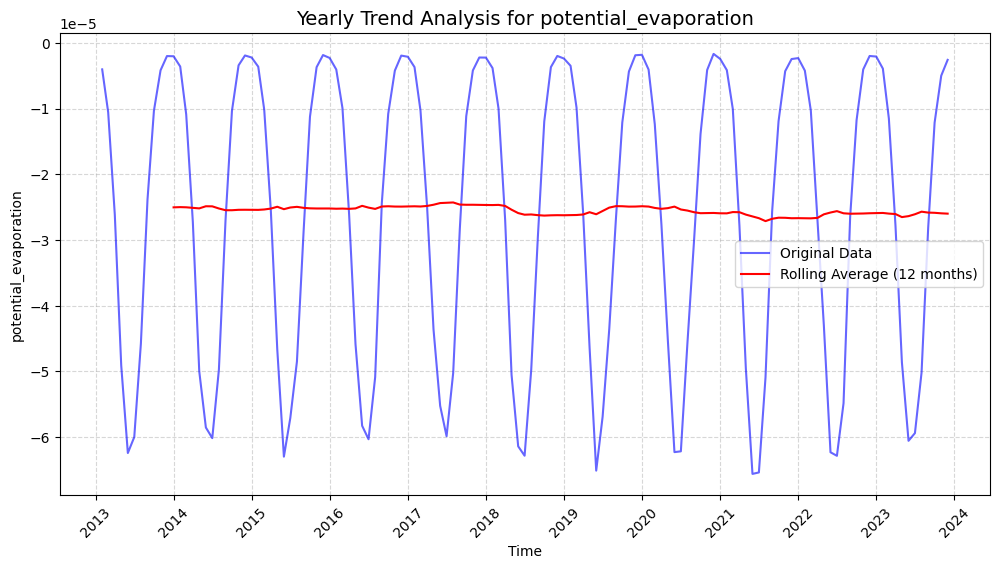

C:\Users\giann\AppData\Local\Temp\ipykernel_17548\573293066.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['season'] = (merged_data.index.month % 12 // 3) + 1


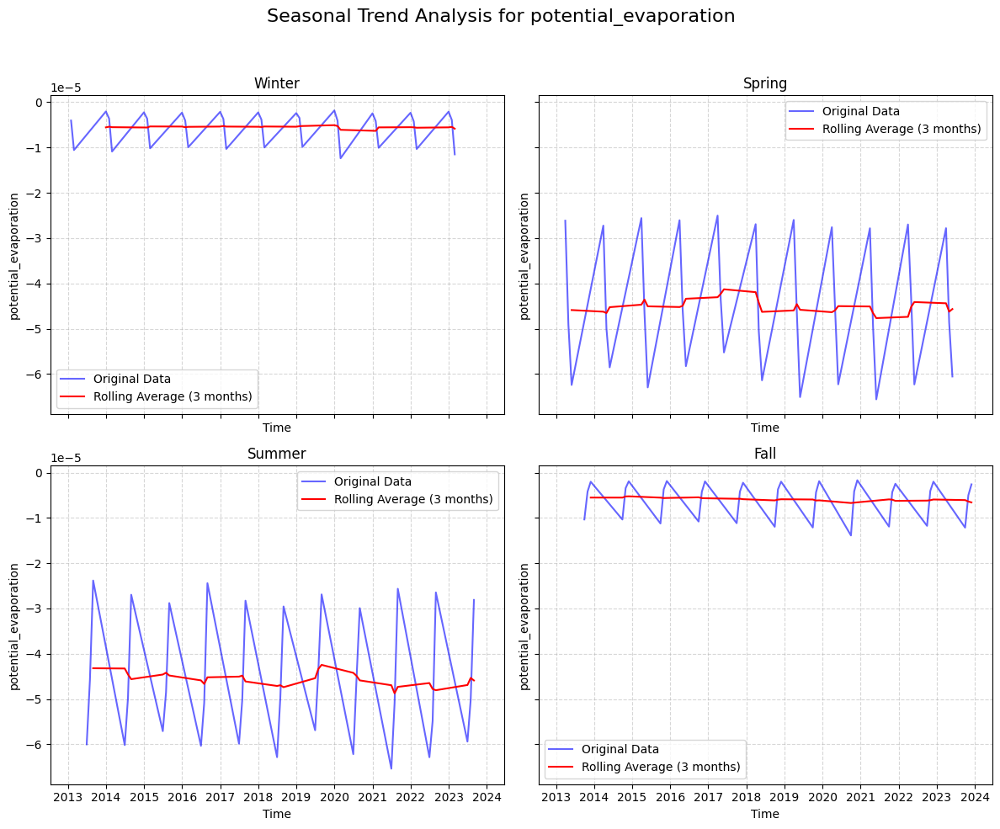


Analyzing trend for: evaporation...


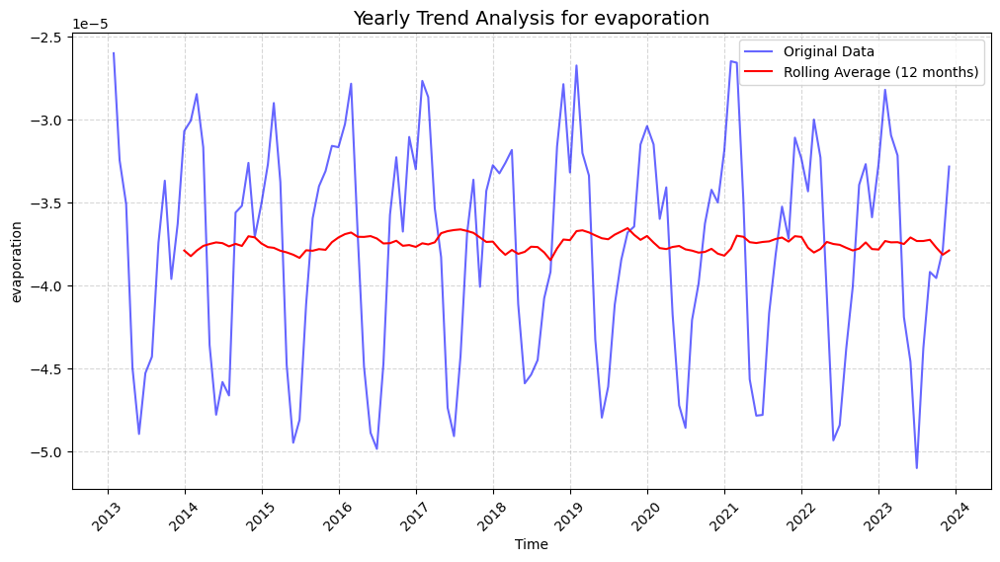

C:\Users\giann\AppData\Local\Temp\ipykernel_17548\573293066.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['season'] = (merged_data.index.month % 12 // 3) + 1


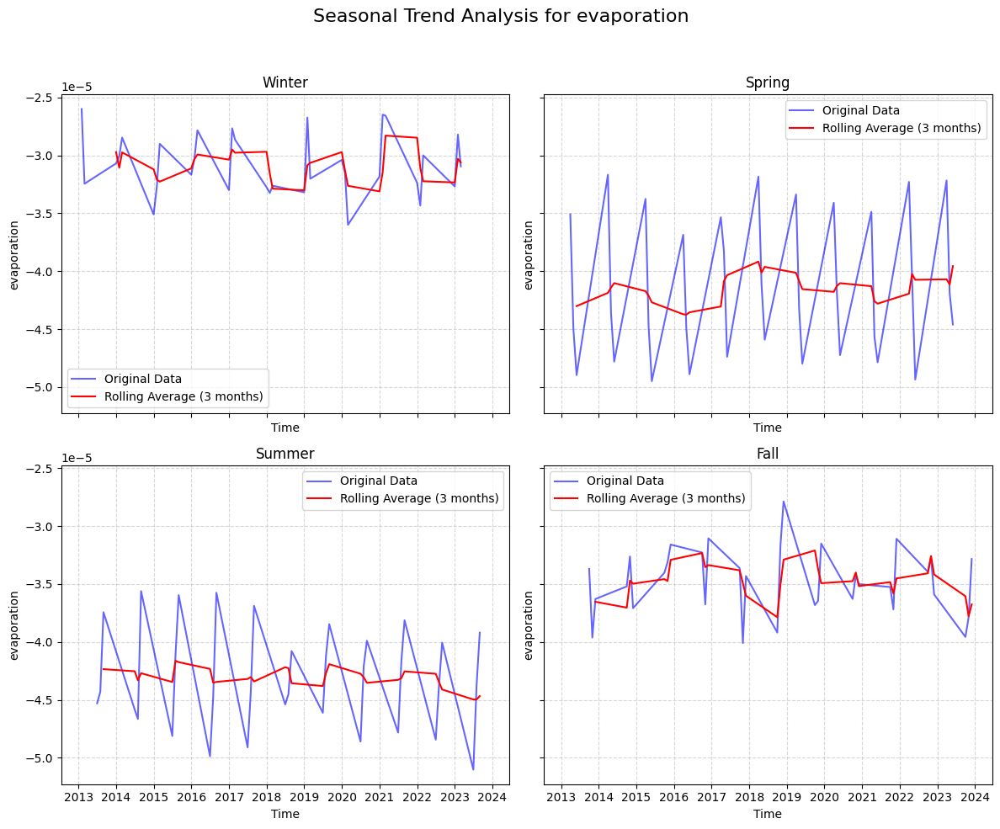


Analyzing trend for: runoff...


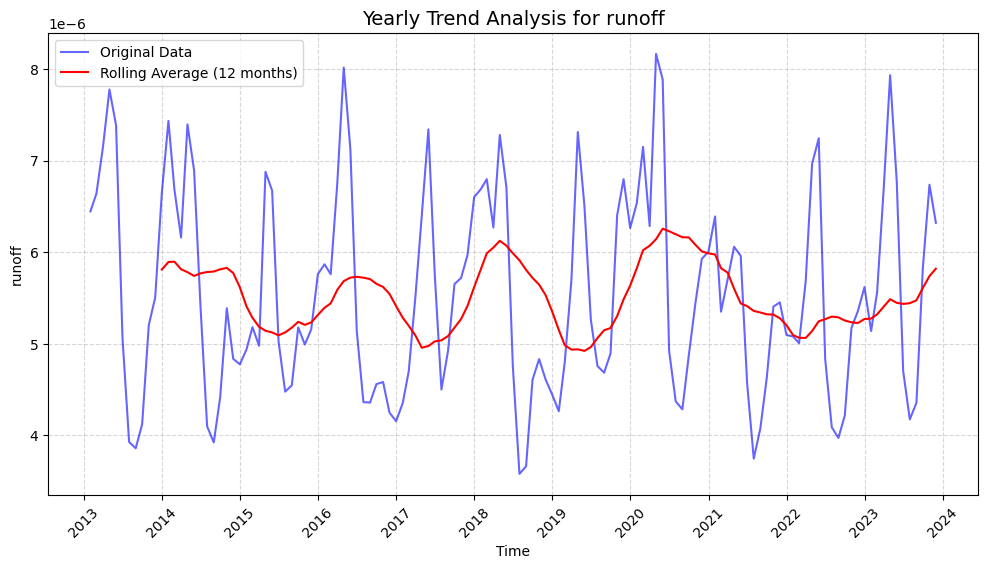

C:\Users\giann\AppData\Local\Temp\ipykernel_17548\573293066.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['season'] = (merged_data.index.month % 12 // 3) + 1


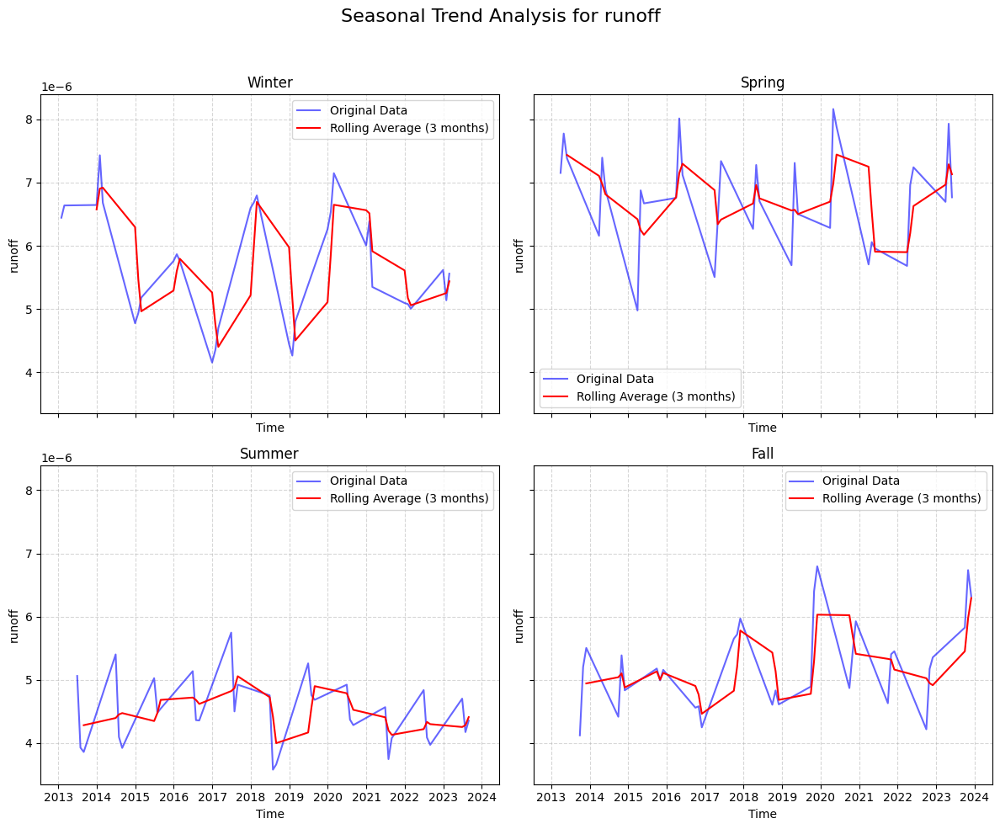


Analyzing trend for: soil_type...


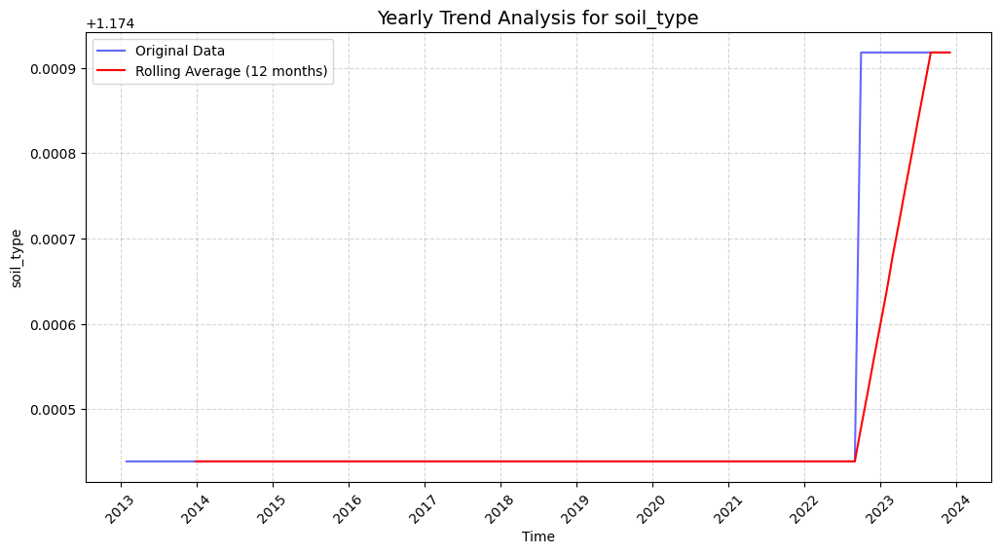

C:\Users\giann\AppData\Local\Temp\ipykernel_17548\573293066.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['season'] = (merged_data.index.month % 12 // 3) + 1


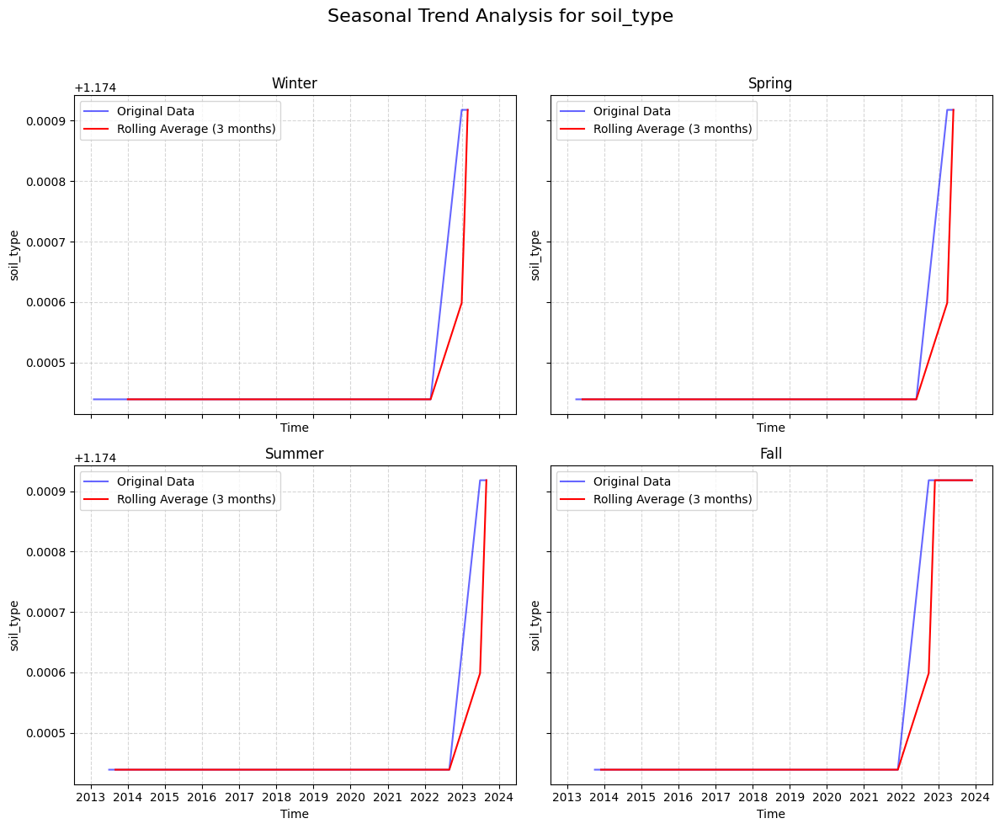

In [16]:
# Loop through each variable to analyze trends
for var in variables_of_interest:
    if var in merged_data.columns:
        print(f"\nAnalyzing trend for: {var}...")

        # Get the time series for the variable
        time_series = merged_data[var]

        # Fill missing values
        time_series = time_series.interpolate(method="linear")

        # Calculate a rolling average (12-month moving average)
        rolling_avg = time_series.rolling(window=12).mean()

        # Plot the yearly trend
        plt.figure(figsize=(12, 6))
        plt.plot(time_series, label="Original Data", color="blue", alpha=0.6)
        plt.plot(rolling_avg, label="Rolling Average (12 months)", color="red")
        plt.title(f"Yearly Trend Analysis for {var}", fontsize=14)
        plt.xlabel("Time")
        plt.ylabel(var)
        plt.gca().xaxis.set_major_locator(mdates.YearLocator())
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
        plt.xticks(rotation=45)
        plt.grid(True, linestyle="--", alpha=0.5)
        plt.legend()
        plt.show()

        # Add a 'season' column to the DataFrame: 1 = Winter, 2 = Spring, 3 = Summer, 4 = Fall
        merged_data['season'] = (merged_data.index.month % 12 // 3) + 1

        # Group the time series by season
        seasonal_data = merged_data.groupby('season')[var]

        # Create subplots for each season
        fig, axes = plt.subplots(2, 2, figsize=(12, 10), sharex=True, sharey=True)
        axes = axes.flatten()
        season_names = ["Winter", "Spring", "Summer", "Fall"]

        for i, (season, group) in enumerate(seasonal_data):
            # Calculate rolling average for the season
            rolling_avg = group.rolling(window=3).mean()

            # Plot the original data and rolling average
            axes[i].plot(group.index, group, label="Original Data", color="blue", alpha=0.6)
            axes[i].plot(rolling_avg.index, rolling_avg, label="Rolling Average (3 months)", color="red")

            # Add title, labels, and legend
            axes[i].set_title(f"{season_names[i]}", fontsize=12)
            axes[i].set_xlabel("Time")
            axes[i].set_ylabel(var)
            axes[i].xaxis.set_major_locator(mdates.YearLocator(1))  # Set grid for every year
            axes[i].xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
            axes[i].grid(True, linestyle="--", alpha=0.5)
            axes[i].legend()

        # Adjust layout and show plot
        fig.suptitle(f"Seasonal Trend Analysis for {var}", fontsize=16)
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()
    else:
        print(f"Variable '{var}' not found in the dataset.")


#### Spatial Analysis

Skipping temperature_2m: No time dimension or not available in dataset.
Skipping temperature_2m: No time dimension or not available in dataset.

Processing temperature_2m...


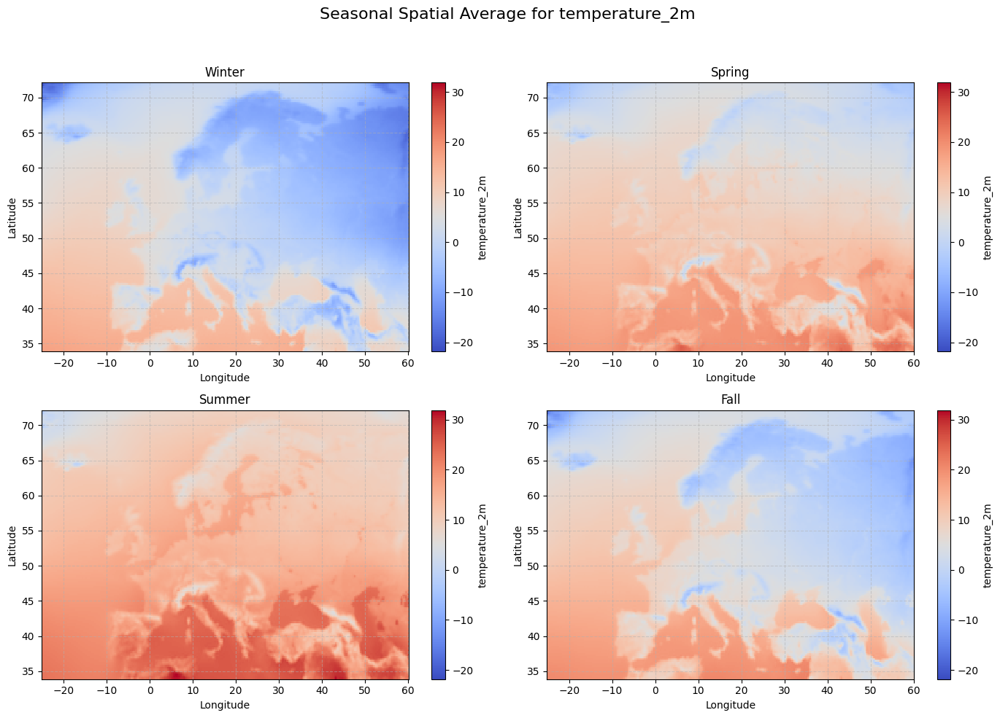

Skipping temperature_2m: No time dimension or not available in dataset.
Skipping total_precipitation: No time dimension or not available in dataset.
Skipping total_precipitation: No time dimension or not available in dataset.
Skipping total_precipitation: No time dimension or not available in dataset.

Processing total_precipitation...


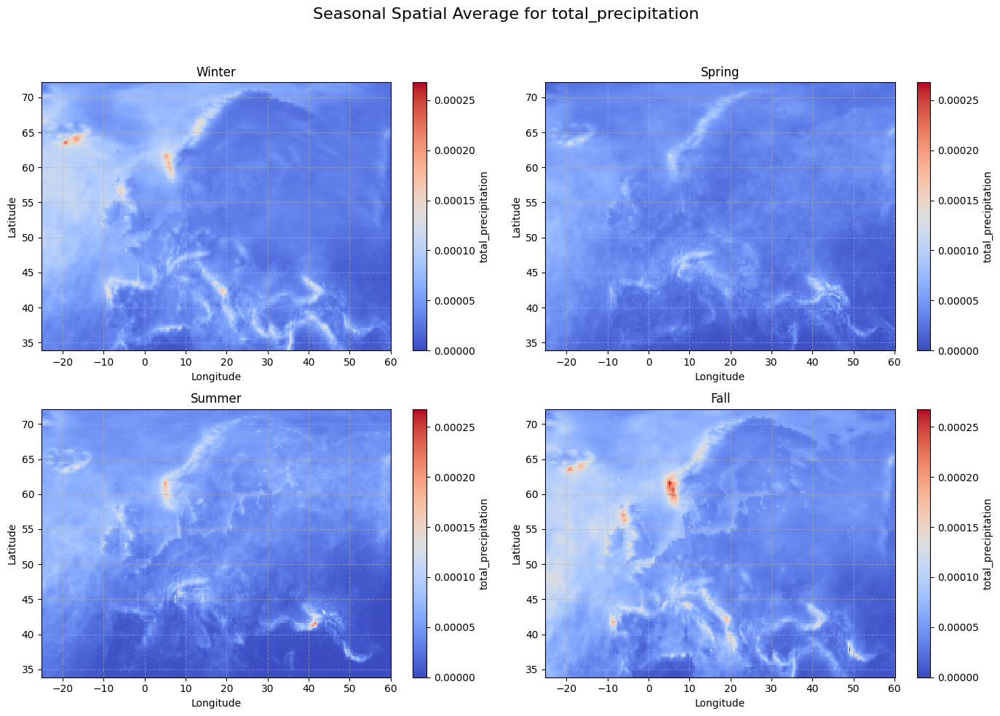

Skipping wind_u_component: No time dimension or not available in dataset.
Skipping wind_u_component: No time dimension or not available in dataset.

Processing wind_u_component...


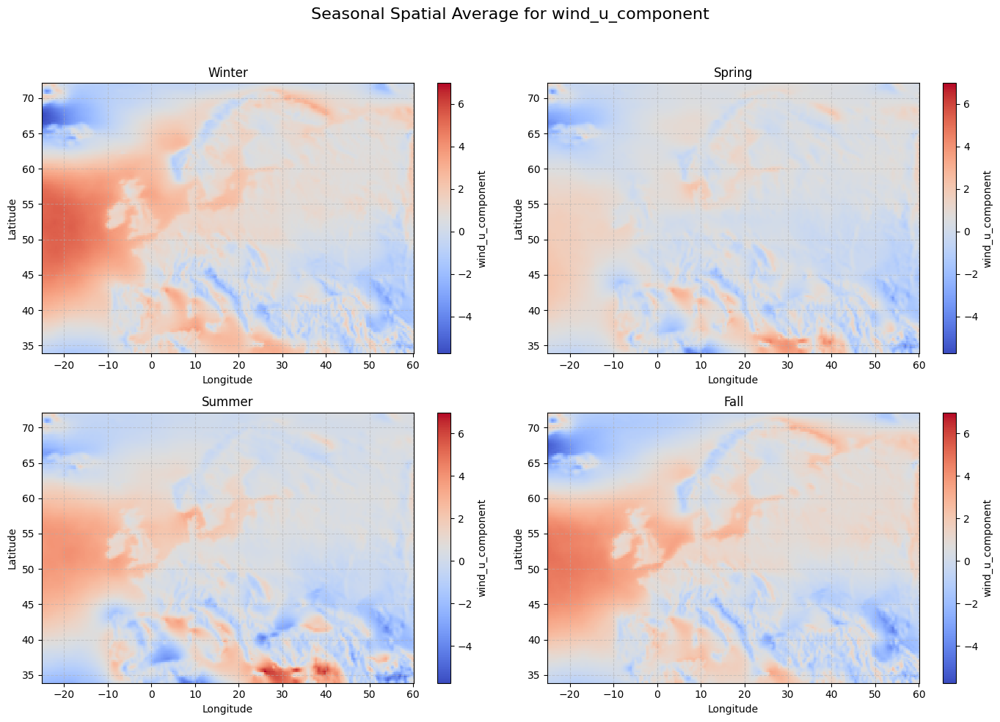

Skipping wind_u_component: No time dimension or not available in dataset.
Skipping wind_v_component: No time dimension or not available in dataset.
Skipping wind_v_component: No time dimension or not available in dataset.

Processing wind_v_component...


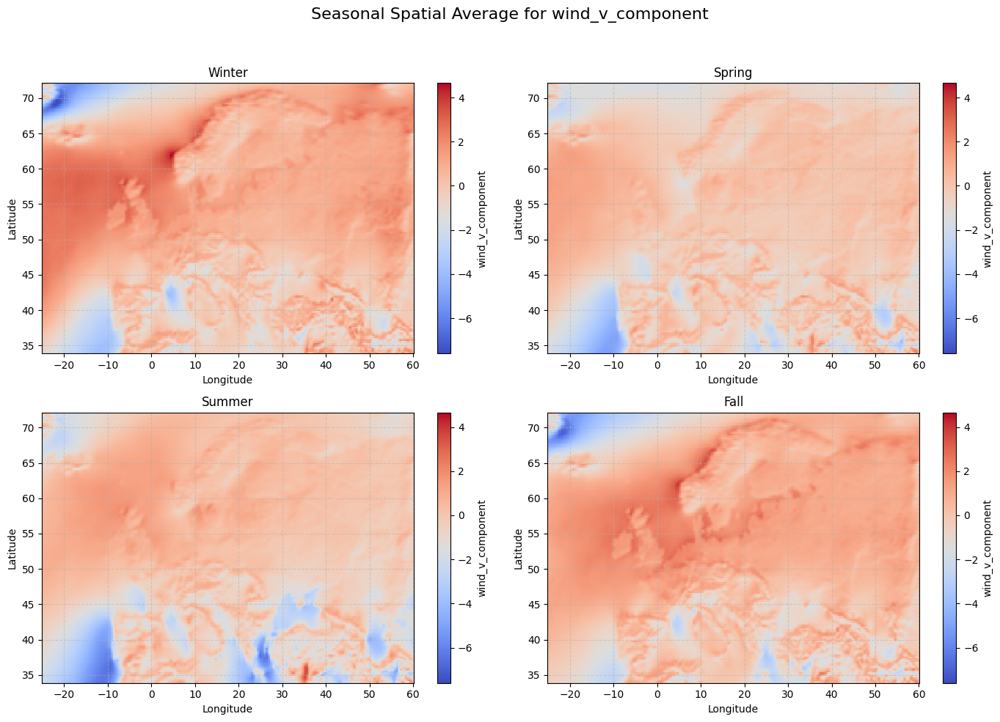

Skipping wind_v_component: No time dimension or not available in dataset.
Skipping dewpoint_temperature_2m: No time dimension or not available in dataset.
Skipping dewpoint_temperature_2m: No time dimension or not available in dataset.

Processing dewpoint_temperature_2m...


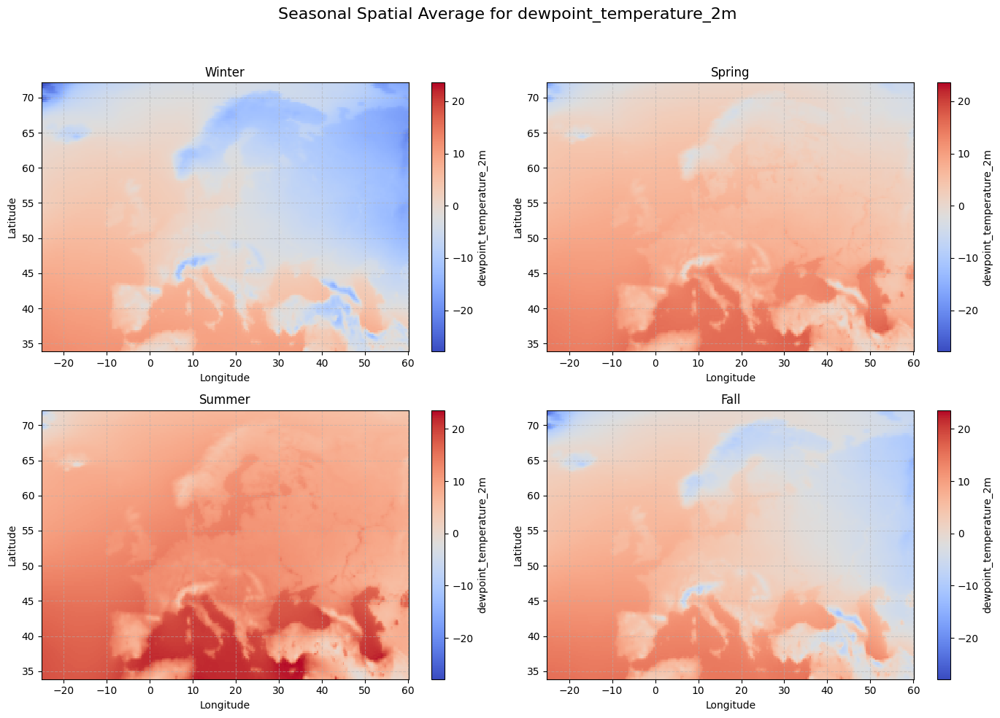

Skipping dewpoint_temperature_2m: No time dimension or not available in dataset.
Skipping surface_pressure: No time dimension or not available in dataset.
Skipping surface_pressure: No time dimension or not available in dataset.

Processing surface_pressure...


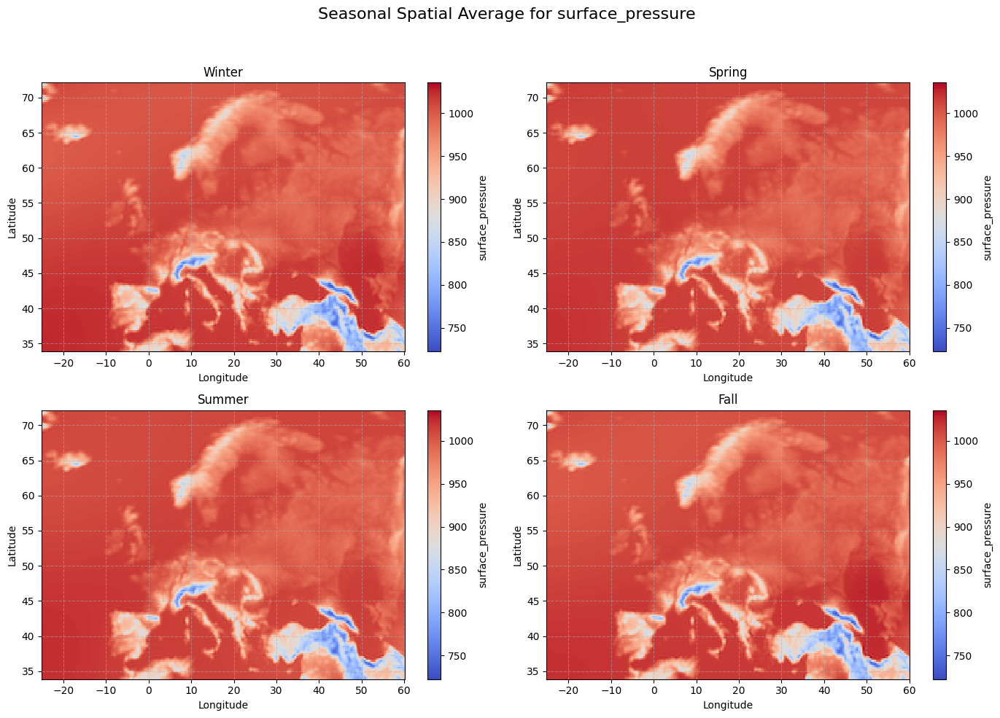

Skipping surface_pressure: No time dimension or not available in dataset.

Processing volumetric_soil_water_layer_1...


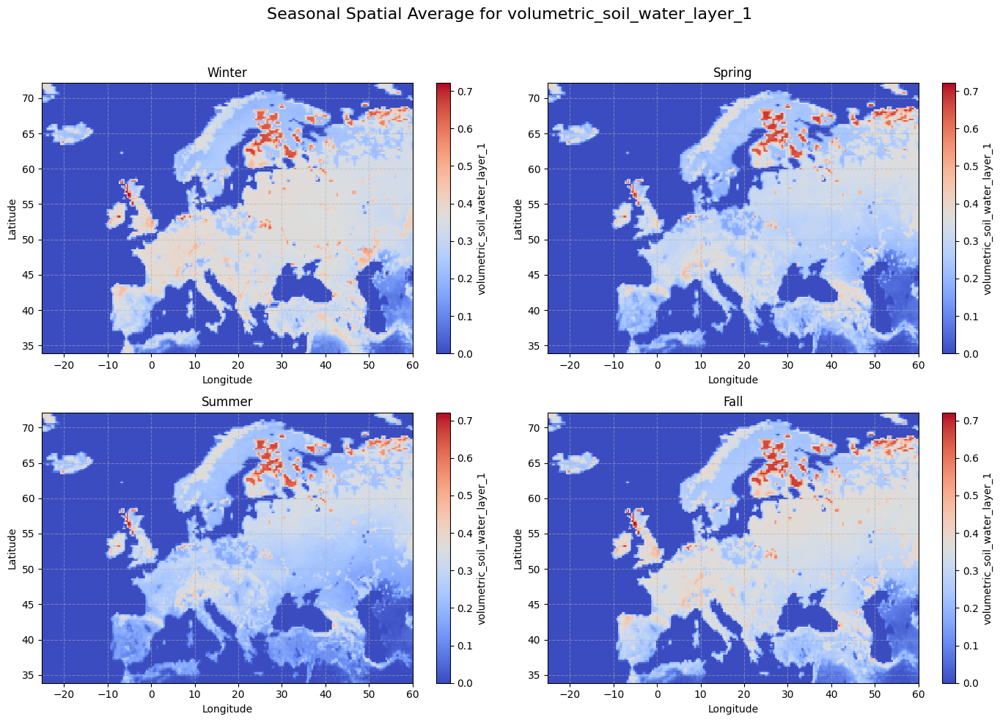

Skipping volumetric_soil_water_layer_1: No time dimension or not available in dataset.
Skipping volumetric_soil_water_layer_1: No time dimension or not available in dataset.
Skipping volumetric_soil_water_layer_1: No time dimension or not available in dataset.
Skipping volumetric_soil_water_layer_2: No time dimension or not available in dataset.

Processing volumetric_soil_water_layer_2...


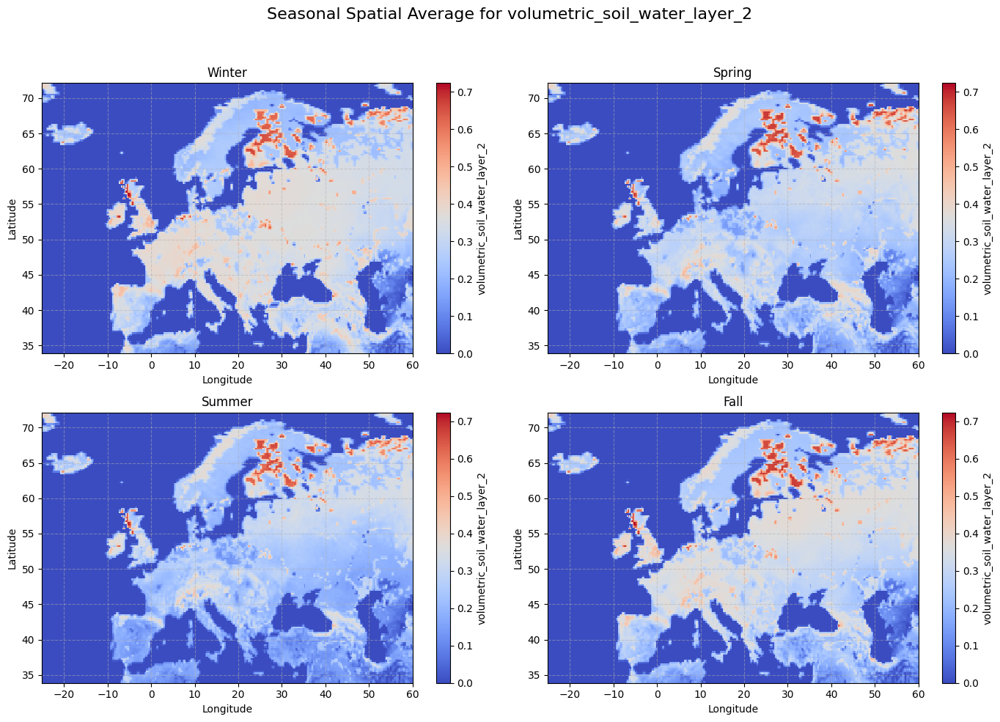

Skipping volumetric_soil_water_layer_2: No time dimension or not available in dataset.
Skipping volumetric_soil_water_layer_2: No time dimension or not available in dataset.

Processing soil_temperature_level_1...


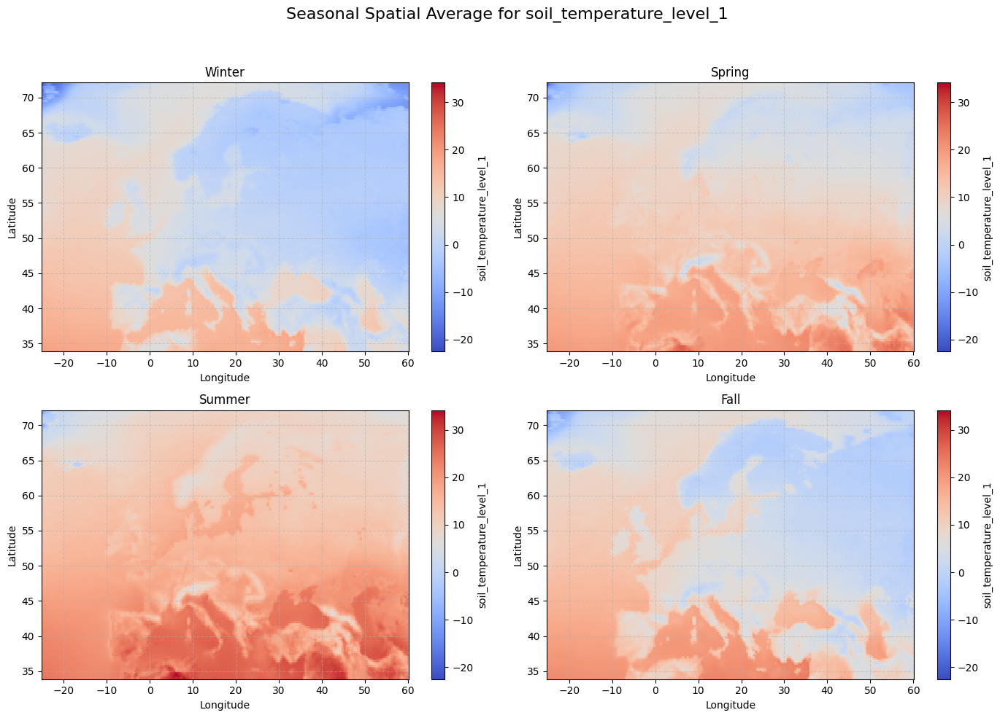

Skipping soil_temperature_level_1: No time dimension or not available in dataset.
Skipping soil_temperature_level_1: No time dimension or not available in dataset.
Skipping soil_temperature_level_1: No time dimension or not available in dataset.
Skipping snowmelt: No time dimension or not available in dataset.
Skipping snowmelt: No time dimension or not available in dataset.
Skipping snowmelt: No time dimension or not available in dataset.

Processing snowmelt...


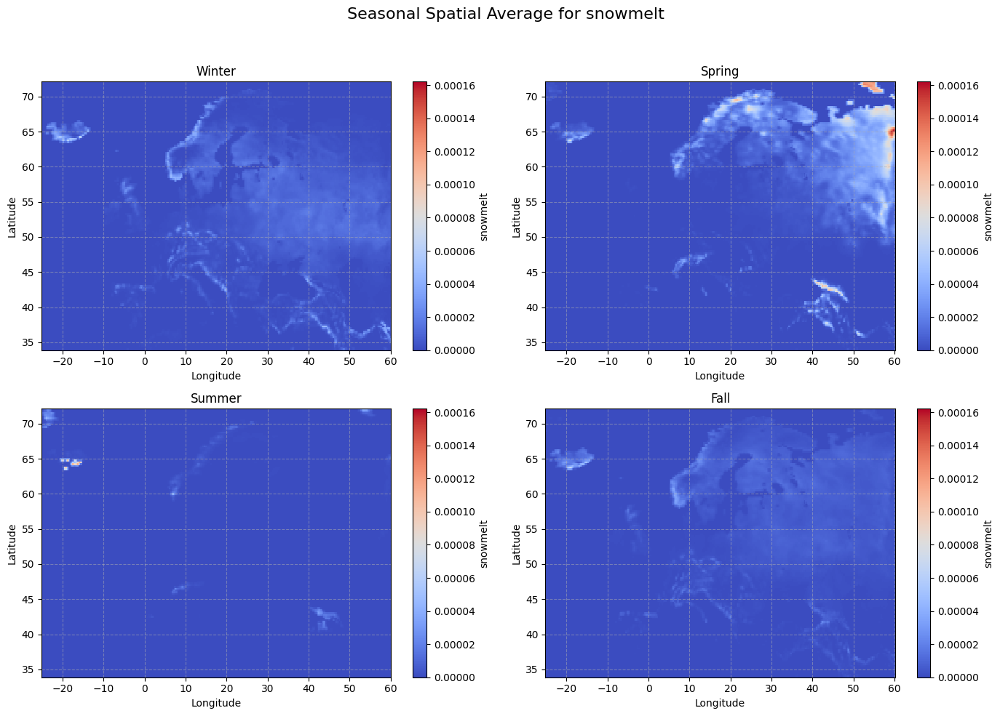

Skipping potential_evaporation: No time dimension or not available in dataset.
Skipping potential_evaporation: No time dimension or not available in dataset.
Skipping potential_evaporation: No time dimension or not available in dataset.

Processing potential_evaporation...


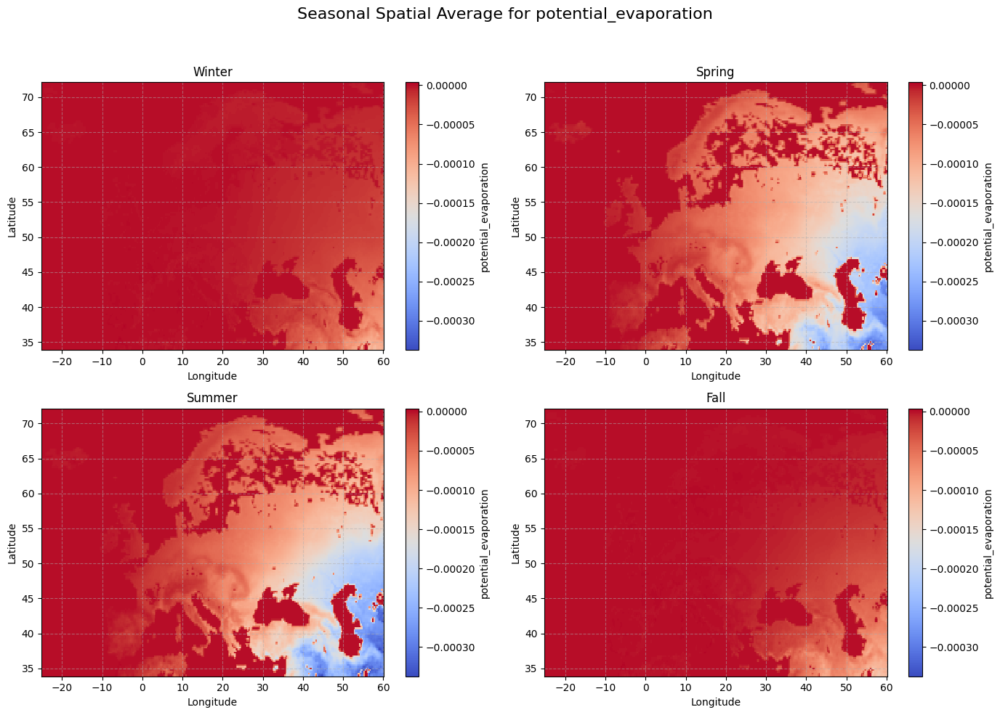

Skipping evaporation: No time dimension or not available in dataset.
Skipping evaporation: No time dimension or not available in dataset.
Skipping evaporation: No time dimension or not available in dataset.

Processing evaporation...


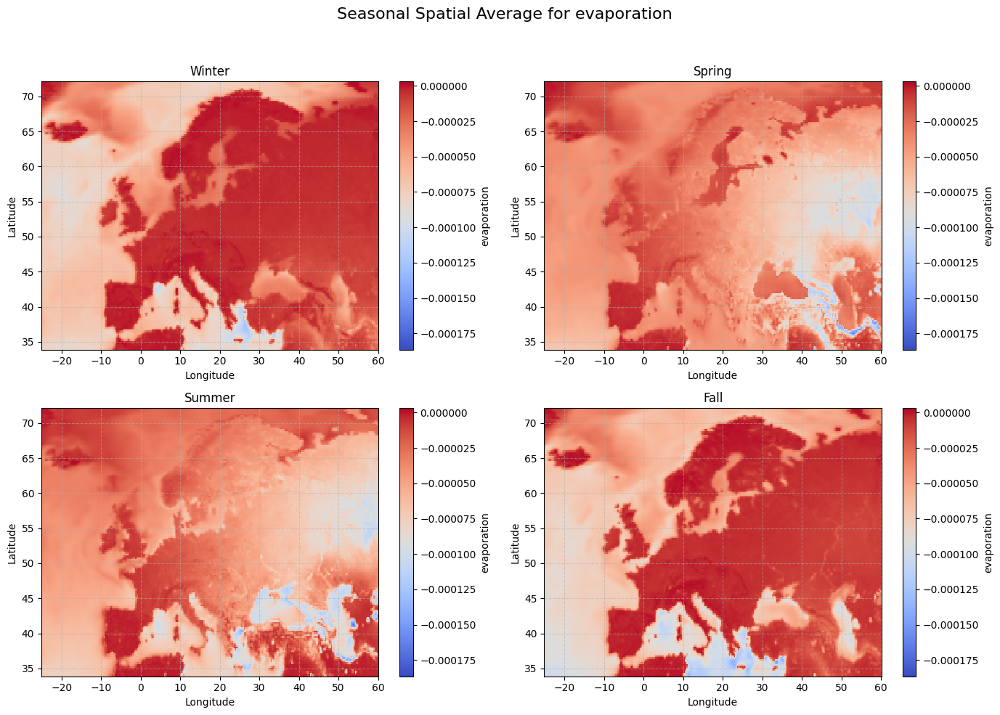

Skipping runoff: No time dimension or not available in dataset.
Skipping runoff: No time dimension or not available in dataset.
Skipping runoff: No time dimension or not available in dataset.

Processing runoff...


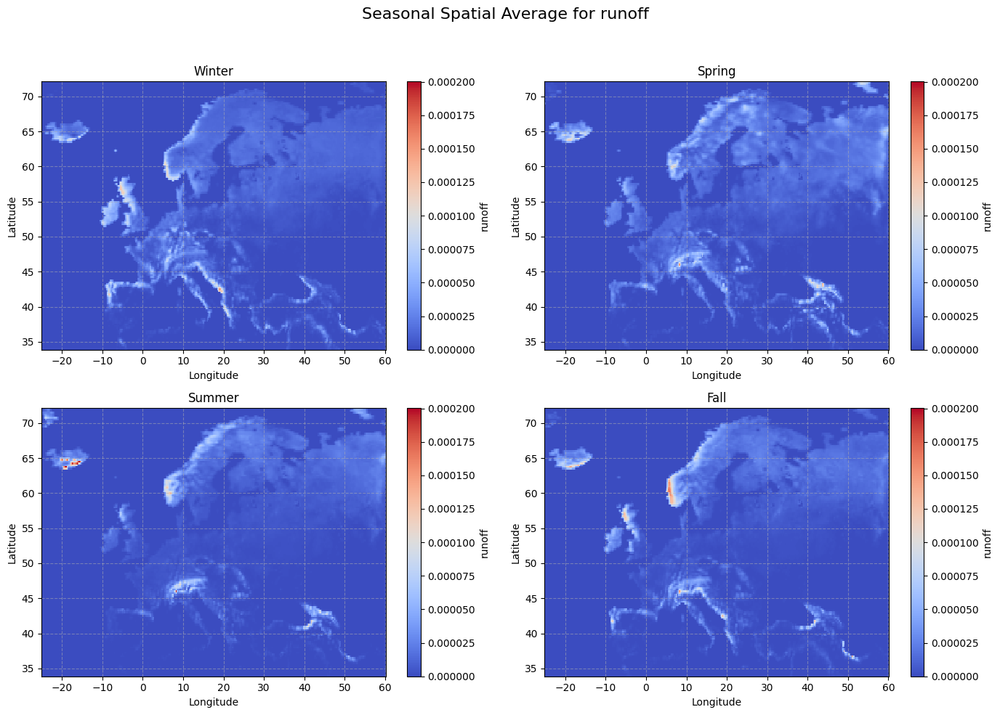

Skipping soil_type: No time dimension or not available in dataset.
Skipping soil_type: No time dimension or not available in dataset.

Processing soil_type...


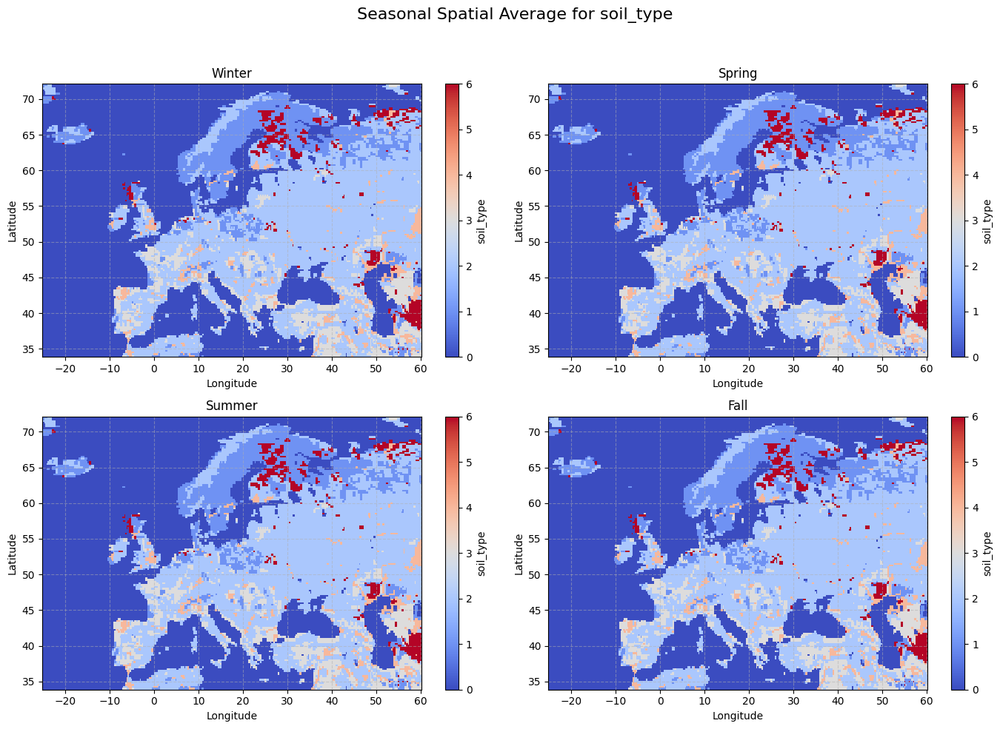

Skipping soil_type: No time dimension or not available in dataset.


In [39]:
# Seasonal Spatial Analysis with 2x2 Subplots for Seasons for Each Variable
season_mapping = {"DJF": "Winter", "MAM": "Spring", "JJA": "Summer", "SON": "Fall"}

for var in variables_of_interest:
    for ds in processed_datasets:
        if var in ds.variables and "time" in ds.dims:
            print(f"\nProcessing {var}...")

            # Ensure time is a datetime object
            if not np.issubdtype(ds["time"].dtype, np.datetime64):
                ds["time"] = pd.to_datetime(ds["time"].values)

            # Add a 'season' coordinate
            ds = ds.assign_coords(season=ds["time"].dt.season)

            # Calculate seasonal averages
            seasonal_averages = {}
            for season_code, season_name in season_mapping.items():
                seasonal_data = ds.where(ds["season"] == season_code, drop=True)
                reduced_var = seasonal_data[var].mean(dim=[dim for dim in seasonal_data[var].dims if dim not in {"latitude", "longitude"}])
                if "latitude" in reduced_var.dims and "longitude" in reduced_var.dims:
                    seasonal_averages[season_name] = reduced_var
                else:
                    print(f"  Skipping {var} for {season_name}: No latitude/longitude information.")
            
            # If no valid data for any season, skip this variable
            if not seasonal_averages:
                print(f"No valid spatial data for {var}. Skipping...")
                continue

            # Find global min and max for the color scale
            global_min = min(spatial_data.min().values for spatial_data in seasonal_averages.values())
            global_max = max(spatial_data.max().values for spatial_data in seasonal_averages.values())

            # Create 2x2 subplots
            fig, axes = plt.subplots(2, 2, figsize=(14, 10))
            axes = axes.flatten()

            for ax, (season_name, spatial_data) in zip(axes, seasonal_averages.items()):
                spatial_data.plot(
                    ax=ax,
                    cmap="coolwarm",
                    vmin=global_min,  # Use global min
                    vmax=global_max,  # Use global max
                    cbar_kwargs={"label": var},
                )
                ax.set_title(f"{season_name}")
                ax.set_xlabel("Longitude")
                ax.set_ylabel("Latitude")
                ax.grid(True, linestyle="--", alpha=0.5)

            # Adjust layout and add a title
            fig.suptitle(f"Seasonal Spatial Average for {var}", fontsize=16)
            fig.tight_layout(rect=[0, 0, 1, 0.95])
            plt.show()

        else:
            print(f"Skipping {var}: No time dimension or not available in dataset.")


#### Spatial Analysis and Visualizing for Flood and Drought Risk Areas 

Generating maps for Winter...
Generating maps for Spring...
Generating maps for Summer...
Generating maps for Fall...


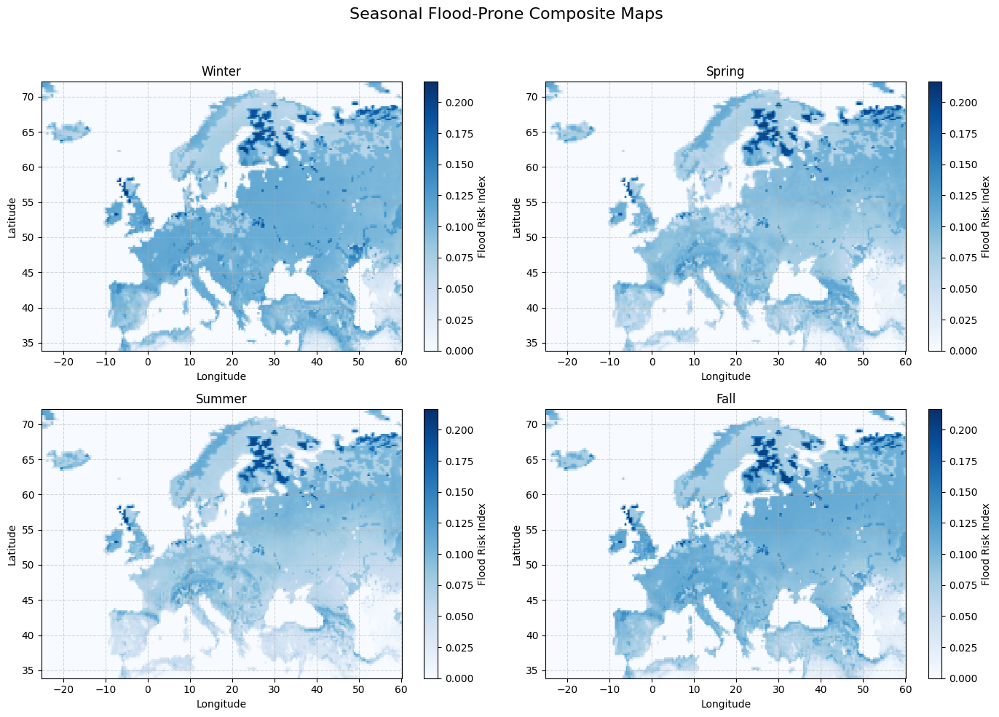

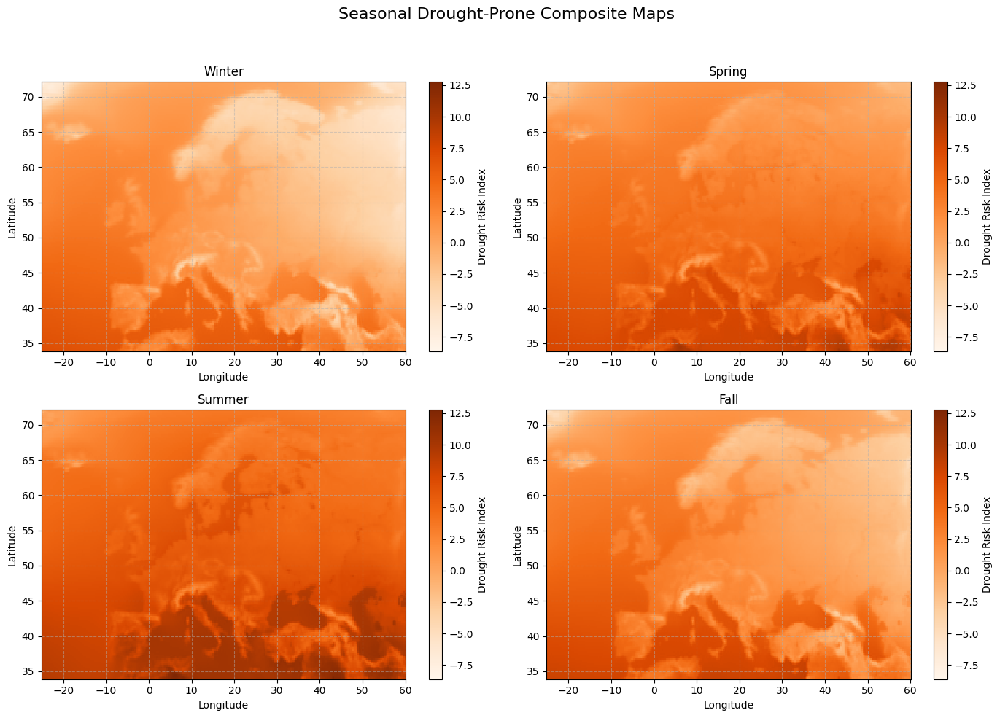

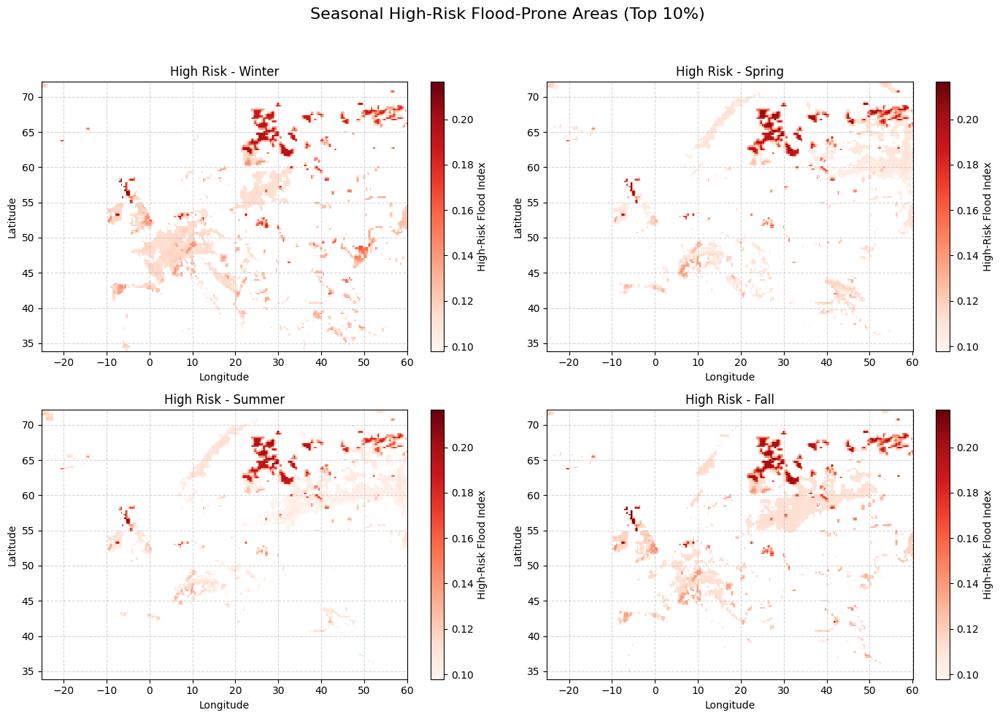

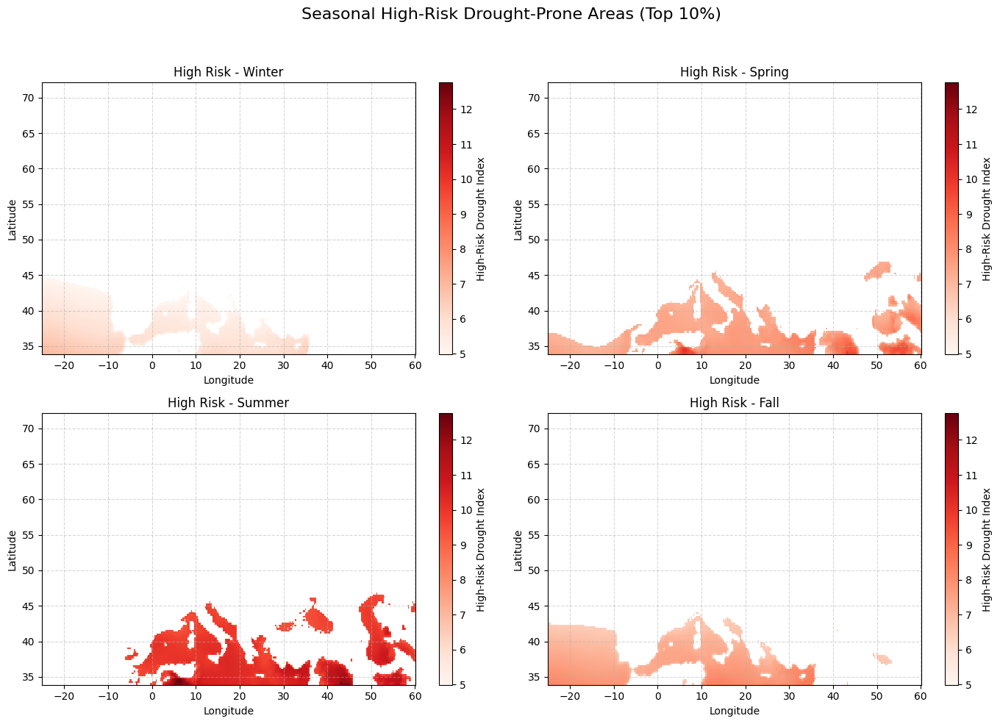

In [46]:
# Weights for flood-prone and drought-prone maps
flood_weights = {
    "total_precipitation": 0.5,
    "volumetric_soil_water_layer_1": 0.3,
    "runoff": 0.2,
}

drought_weights = {
    "temperature_2m": 0.4,
    "potential_evaporation": 0.3,
    "volumetric_soil_water_layer_1": 0.3,
}

# Ensure latitude and longitude are sorted in all datasets
for i, ds in enumerate(processed_datasets):
    if "latitude" in ds.dims:
        processed_datasets[i] = ds.sortby("latitude")
    if "longitude" in ds.dims:
        processed_datasets[i] = ds.sortby("longitude")

# Helper function to generate seasonal composite maps
def generate_seasonal_composite(weights, season_code, datasets):
    seasonal_composite_map = None
    for var, weight in weights.items():
        for ds in datasets:
            if var in ds.variables and "time" in ds.dims:
                # Filter for the specific season
                ds = ds.assign_coords(season=ds["time"].dt.season)
                seasonal_data = ds.where(ds["season"] == season_code, drop=True)

                reduced_var = seasonal_data[var].mean(dim=[dim for dim in seasonal_data[var].dims if dim not in {"latitude", "longitude"}])
                if "latitude" in reduced_var.dims and "longitude" in reduced_var.dims:
                    weighted_map = reduced_var * weight
                    if seasonal_composite_map is None:
                        seasonal_composite_map = weighted_map
                    else:
                        seasonal_composite_map += weighted_map
    return seasonal_composite_map

# Rest of the code remains unchanged
# ...


# Generate seasonal composite maps for flood-prone and drought-prone indices
season_mapping = {"DJF": "Winter", "MAM": "Spring", "JJA": "Summer", "SON": "Fall"}
seasonal_flood_maps = {}
seasonal_drought_maps = {}

for season_code, season_name in season_mapping.items():
    print(f"Generating maps for {season_name}...")
    seasonal_flood_maps[season_name] = generate_seasonal_composite(flood_weights, season_code, processed_datasets)
    seasonal_drought_maps[season_name] = generate_seasonal_composite(drought_weights, season_code, processed_datasets)

# Compute global min and max for flood-prone and drought-prone maps
global_flood_min = min(flood_map.min().values for flood_map in seasonal_flood_maps.values() if flood_map is not None)
global_flood_max = max(flood_map.max().values for flood_map in seasonal_flood_maps.values() if flood_map is not None)

global_drought_min = min(drought_map.min().values for drought_map in seasonal_drought_maps.values() if drought_map is not None)
global_drought_max = max(drought_map.max().values for drought_map in seasonal_drought_maps.values() if drought_map is not None)

# Compute global min and max for high-risk flood and drought areas
global_high_risk_flood_min = min(
    flood_map.where(flood_map > flood_map.quantile(0.9), drop=False).min().values
    for flood_map in seasonal_flood_maps.values() if flood_map is not None
)
global_high_risk_flood_max = max(
    flood_map.where(flood_map > flood_map.quantile(0.9), drop=False).max().values
    for flood_map in seasonal_flood_maps.values() if flood_map is not None
)

global_high_risk_drought_min = min(
    drought_map.where(drought_map > drought_map.quantile(0.9), drop=False).min().values
    for drought_map in seasonal_drought_maps.values() if drought_map is not None
)
global_high_risk_drought_max = max(
    drought_map.where(drought_map > drought_map.quantile(0.9), drop=False).max().values
    for drought_map in seasonal_drought_maps.values() if drought_map is not None
)

# Plot seasonal flood-prone maps with consistent color scale
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
axes = axes.flatten()
for ax, (season_name, flood_map) in zip(axes, seasonal_flood_maps.items()):
    if flood_map is not None:
        flood_map.plot(
            ax=ax,
            cmap="Blues",
            vmin=global_flood_min,
            vmax=global_flood_max,
            cbar_kwargs={"label": "Flood Risk Index"},
        )
        ax.set_title(f"{season_name}")
        ax.set_xlabel("Longitude")
        ax.set_ylabel("Latitude")
        ax.grid(True, linestyle="--", alpha=0.5)
    else:
        ax.set_title(f"{season_name}: No data")
        ax.axis("off")
fig.suptitle("Seasonal Flood-Prone Composite Maps", fontsize=16)
fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

# Plot seasonal drought-prone maps with consistent color scale
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
axes = axes.flatten()
for ax, (season_name, drought_map) in zip(axes, seasonal_drought_maps.items()):
    if drought_map is not None:
        drought_map.plot(
            ax=ax,
            cmap="Oranges",
            vmin=global_drought_min,
            vmax=global_drought_max,
            cbar_kwargs={"label": "Drought Risk Index"},
        )
        ax.set_title(f"{season_name}")
        ax.set_xlabel("Longitude")
        ax.set_ylabel("Latitude")
        ax.grid(True, linestyle="--", alpha=0.5)
    else:
        ax.set_title(f"{season_name}: No data")
        ax.axis("off")
fig.suptitle("Seasonal Drought-Prone Composite Maps", fontsize=16)
fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

# High-risk flood-prone areas (Top 10%) with consistent color scale
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
axes = axes.flatten()
for ax, (season_name, flood_map) in zip(axes, seasonal_flood_maps.items()):
    if flood_map is not None:
        high_risk_flood_areas = flood_map.where(flood_map > flood_map.quantile(0.9), drop=False)
        high_risk_flood_areas.plot(
            ax=ax,
            cmap="Reds",
            vmin=global_high_risk_flood_min,
            vmax=global_high_risk_flood_max,
            cbar_kwargs={"label": "High-Risk Flood Index"},
        )
        ax.set_title(f"High Risk - {season_name}")
        ax.set_xlabel("Longitude")
        ax.set_ylabel("Latitude")
        ax.grid(True, linestyle="--", alpha=0.5)
    else:
        ax.set_title(f"{season_name}: No data")
        ax.axis("off")
fig.suptitle("Seasonal High-Risk Flood-Prone Areas (Top 10%)", fontsize=16)
fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

# High-risk drought-prone areas (Top 10%) with consistent color scale
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
axes = axes.flatten()
for ax, (season_name, drought_map) in zip(axes, seasonal_drought_maps.items()):
    if drought_map is not None:
        high_risk_drought_areas = drought_map.where(drought_map > drought_map.quantile(0.9), drop=False)
        high_risk_drought_areas.plot(
            ax=ax,
            cmap="Reds",
            vmin=global_high_risk_drought_min,
            vmax=global_high_risk_drought_max,
            cbar_kwargs={"label": "High-Risk Drought Index"},
        )
        ax.set_title(f"High Risk - {season_name}")
        ax.set_xlabel("Longitude")
        ax.set_ylabel("Latitude")
        ax.grid(True, linestyle="--", alpha=0.5)
    else:
        ax.set_title(f"{season_name}: No data")
        ax.axis("off")
fig.suptitle("Seasonal High-Risk Drought-Prone Areas (Top 10%)", fontsize=16)
fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


#### Event Identification and Analysis for Flood


Analyzing total_precipitation for seasonal extreme events...
Threshold for extreme events in total_precipitation during Winter: 5.7217881112592296e-05
Number of extreme events for total_precipitation during Winter: 2
Threshold for extreme events in total_precipitation during Spring: 4.105449552298523e-05
Number of extreme events for total_precipitation during Spring: 2
Threshold for extreme events in total_precipitation during Summer: 4.831632395507768e-05
Number of extreme events for total_precipitation during Summer: 2
Threshold for extreme events in total_precipitation during Fall: 6.18772057350725e-05
Number of extreme events for total_precipitation during Fall: 2

Analyzing temperature_2m for seasonal extreme events...
Threshold for extreme events in temperature_2m during Winter: 3.7141738533973694
Number of extreme events for temperature_2m during Winter: 2
Threshold for extreme events in temperature_2m during Spring: 13.646624755859374
Number of extreme events for temperature_2

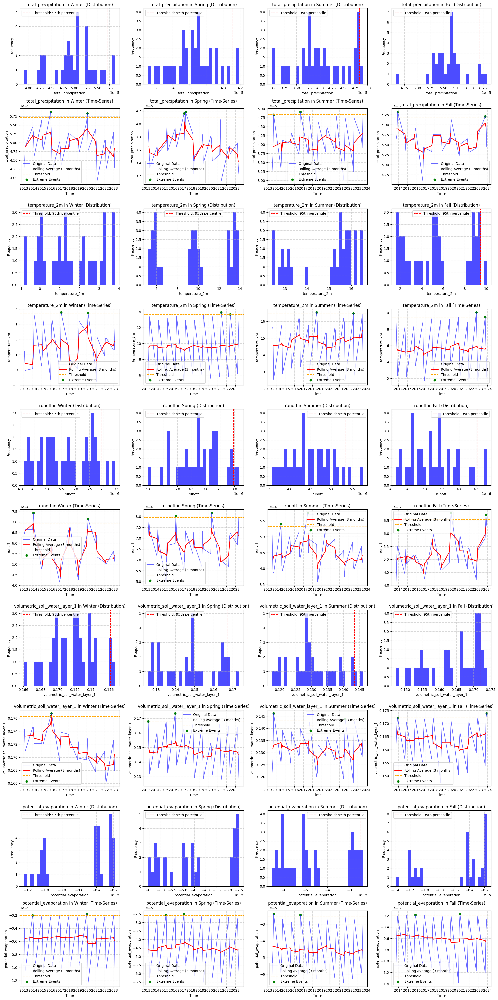

In [86]:
# Variables to analyze
variables_to_analyze = ["total_precipitation", "temperature_2m", "runoff", "volumetric_soil_water_layer_1", "potential_evaporation"]

# Map seasons to names
season_mapping = {1: "Winter", 2: "Spring", 3: "Summer", 4: "Fall"}

# Create a copy of filtered_data to ensure we are not modifying a view
filtered_data = filtered_data.copy()

# Add a season column to the data
filtered_data["season"] = (filtered_data.index.month % 12 // 3) + 1
filtered_data["season"] = filtered_data["season"].map(season_mapping)

# Create a 6x4 grid for seasonal plotting (3 variables x 2 plots per variable x 4 seasons)
fig, axes = plt.subplots(len(variables_to_analyze) * 2, 4, figsize=(20, len(variables_to_analyze) * 8))
axes = axes.reshape(len(variables_to_analyze) * 2, 4)  # Ensure proper shape

for i, variable in enumerate(variables_to_analyze):
    if variable in filtered_data.columns:
        print(f"\nAnalyzing {variable} for seasonal extreme events...")

        # Loop through each season
        for j, (season_code, season_name) in enumerate(season_mapping.items()):
            # Filter data for the current season
            seasonal_data = filtered_data[filtered_data["season"] == season_name]

            if seasonal_data.empty:
                print(f"No data available for {variable} in {season_name}")
                continue

            # Calculate the threshold for extreme events (95th percentile)
            threshold = seasonal_data[variable].quantile(0.95)
            print(f"Threshold for extreme events in {variable} during {season_name}: {threshold}")

            # Calculate a rolling average (e.g., 3-month rolling window)
            rolling_average = seasonal_data[variable].rolling(window=3, center=True).mean()

            # Find values that are above the threshold
            extreme_events = seasonal_data[seasonal_data[variable] > threshold]
            print(f"Number of extreme events for {variable} during {season_name}: {len(extreme_events)}")

            # Plot the distribution of the variable for the season
            ax_hist = axes[i * 2, j]  # Top row for histograms
            ax_hist.hist(seasonal_data[variable], bins=30, color="blue", alpha=0.7)
            ax_hist.axvline(threshold, color="red", linestyle="--", label=f"Threshold: 95th percentile")
            ax_hist.set_title(f"{variable} in {season_name} (Distribution)")
            ax_hist.set_xlabel(variable)
            ax_hist.set_ylabel("Frequency")
            ax_hist.legend()
            ax_hist.grid(True, linestyle="--", alpha=0.5)

            # Plot the time-series data with extreme events and rolling average
            ax_time_series = axes[i * 2 + 1, j]  # Bottom row for time-series plots
            ax_time_series.plot(seasonal_data[variable], label="Original Data", color="blue", alpha=0.6)
            ax_time_series.plot(rolling_average, label="Rolling Average (3 months)", color="red", linewidth=2)
            ax_time_series.axhline(threshold, color="orange", linestyle="--", label="Threshold")
            ax_time_series.scatter(extreme_events.index, extreme_events[variable], color="green", label="Extreme Events")
            ax_time_series.set_title(f"{variable} in {season_name} (Time-Series)")
            ax_time_series.set_xlabel("Time")
            ax_time_series.set_ylabel(variable)
            ax_time_series.legend()
            ax_time_series.grid(True, linestyle="--", alpha=0.5)

            # Format the x-axis to show years clearly
            ax_time_series.xaxis.set_major_locator(mdates.YearLocator(1))  # One tick per year
            ax_time_series.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))

    else:
        print(f"The variable '{variable}' does not exist in the dataset.")

# Adjust layout to prevent overlap and show the plots
plt.tight_layout()
plt.show()


#### Event Identification and Analysis for Drought


Analyzing temperature_2m for seasonal drought-related extreme events...
Threshold for drought events in temperature_2m during Winter: 3.7141738533973694
Number of drought-related extreme events for temperature_2m during Winter: 2
Threshold for drought events in temperature_2m during Spring: 13.646624755859374
Number of drought-related extreme events for temperature_2m during Spring: 2
Threshold for drought events in temperature_2m during Summer: 16.443128967285155
Number of drought-related extreme events for temperature_2m during Summer: 2
Threshold for drought events in temperature_2m during Fall: 9.460983848571777
Number of drought-related extreme events for temperature_2m during Fall: 2

Analyzing potential_evaporation for seasonal drought-related extreme events...
Threshold for drought events in potential_evaporation during Winter: -2.0652801822507174e-06
Number of drought-related extreme events for potential_evaporation during Winter: 2
Threshold for drought events in potential_e

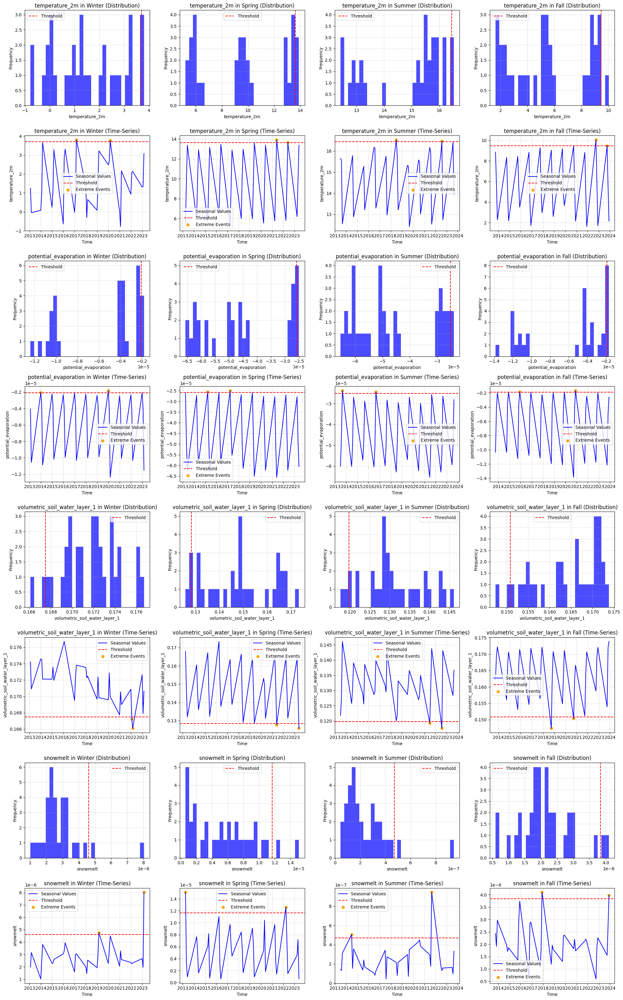

In [87]:
# Variables to analyze for drought
drought_variables = ["temperature_2m", "potential_evaporation", "volumetric_soil_water_layer_1", "snowmelt"]

# Map seasons to names
season_mapping = {1: "Winter", 2: "Spring", 3: "Summer", 4: "Fall"}

# Add a season column to the data
filtered_data = filtered_data.copy()
filtered_data["season"] = (filtered_data.index.month % 12 // 3) + 1
filtered_data["season"] = filtered_data["season"].map(season_mapping)

# Create a 6x4 grid for seasonal plotting (3 variables x 2 plots per variable x 4 seasons)
fig, axes = plt.subplots(len(drought_variables) * 2, 4, figsize=(20, len(drought_variables) * 8))
axes = axes.reshape(len(drought_variables) * 2, 4)  # Ensure proper shape

for i, variable in enumerate(drought_variables):
    if variable in filtered_data.columns:
        print(f"\nAnalyzing {variable} for seasonal drought-related extreme events...")

        # Loop through each season
        for j, (season_code, season_name) in enumerate(season_mapping.items()):
            # Filter data for the current season
            seasonal_data = filtered_data[filtered_data["season"] == season_name]

            if seasonal_data.empty:
                print(f"No data available for {variable} in {season_name}")
                continue

            # Determine the threshold and comparison operator
            if variable == "volumetric_soil_water_layer_1":
                threshold = seasonal_data[variable].quantile(0.05)  # Lower values indicate drought
                comparison_operator = "<"  # For soil water, drought means values below the threshold
            else:
                threshold = seasonal_data[variable].quantile(0.95)  # Higher values indicate drought
                comparison_operator = ">"  # For temperature/evaporation, drought means values above the threshold

            print(f"Threshold for drought events in {variable} during {season_name}: {threshold}")

            # Find drought-related extreme events
            if comparison_operator == ">":
                extreme_events = seasonal_data[seasonal_data[variable] > threshold]
            else:
                extreme_events = seasonal_data[seasonal_data[variable] < threshold]

            print(f"Number of drought-related extreme events for {variable} during {season_name}: {len(extreme_events)}")

            # Plot the distribution of the variable for the season
            ax_hist = axes[i * 2, j]  # Top row for histograms
            ax_hist.hist(seasonal_data[variable], bins=30, color="blue", alpha=0.7)
            ax_hist.axvline(threshold, color="red", linestyle="--", label=f"Threshold")
            ax_hist.set_title(f"{variable} in {season_name} (Distribution)")
            ax_hist.set_xlabel(variable)
            ax_hist.set_ylabel("Frequency")
            ax_hist.legend()
            ax_hist.grid(True, linestyle="--", alpha=0.5)

            # Plot the time-series data with drought-related extreme events
            ax_time_series = axes[i * 2 + 1, j]  # Bottom row for time-series plots
            ax_time_series.plot(seasonal_data[variable], label="Seasonal Values", color="blue")
            ax_time_series.axhline(threshold, color="red", linestyle="--", label="Threshold")
            ax_time_series.scatter(extreme_events.index, extreme_events[variable], color="orange", label="Extreme Events")
            ax_time_series.set_title(f"{variable} in {season_name} (Time-Series)")
            ax_time_series.set_xlabel("Time")
            ax_time_series.set_ylabel(variable)
            ax_time_series.legend()
            ax_time_series.grid(True, linestyle="--", alpha=0.5)

            # Format the x-axis to show years clearly
            ax_time_series.xaxis.set_major_locator(mdates.YearLocator(1))  # Show one tick per year
            ax_time_series.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))

    else:
        print(f"The variable '{variable}' does not exist in the dataset.")

# Adjust layout to prevent overlap and show the plots
plt.tight_layout()
plt.show()


## 2. Climate_indicators_for_Europe_from_2013_to_2023_derived_from_reanalysis

#### Combine Datasets

In [4]:
# Define the folder path containing .nc files
folder_path = r"C:\Users\giann\OneDrive\Desktop\Thesis\Copernicus_Data\Climate_indicators_for_Europe_from_2013_to_2023_derived_from_reanalysis"

# Find all .nc files in the folder
file_list = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith(".nc")]

# Open and combine datasets using Dask with adjustable chunking
print("Opening datasets...")

chunk_sizes = {
    "step": 20,         # Adjust this based on the total number of steps
    "latitude": 100,    # Adjust this based on the spatial resolution
    "longitude": 100    # Adjust this based on the spatial resolution
}

combined_dataset = xr.open_mfdataset(
    file_list,
    combine='nested',
    concat_dim='step',
    coords='minimal',
    chunks=chunk_sizes  # Use optimized chunk sizes
)
print("Datasets combined successfully with adjusted chunking!")

Opening datasets...
Datasets combined successfully with adjusted chunking!


#### Data Cleaning & Seasonal Seperation


Processing and analyzing data for 2013-01-01 to 2018-12-31...
Validated and converted 2-metre temperature (t2m).
Validated and converted total precipitation (tp).
Validated Fire Weather Index (fwi): values >= 0.

Processing and analyzing data for 2019-01-01 to 2023-12-31...
Validated and converted 2-metre temperature (t2m).
Validated and converted total precipitation (tp).
Validated Fire Weather Index (fwi): values >= 0.


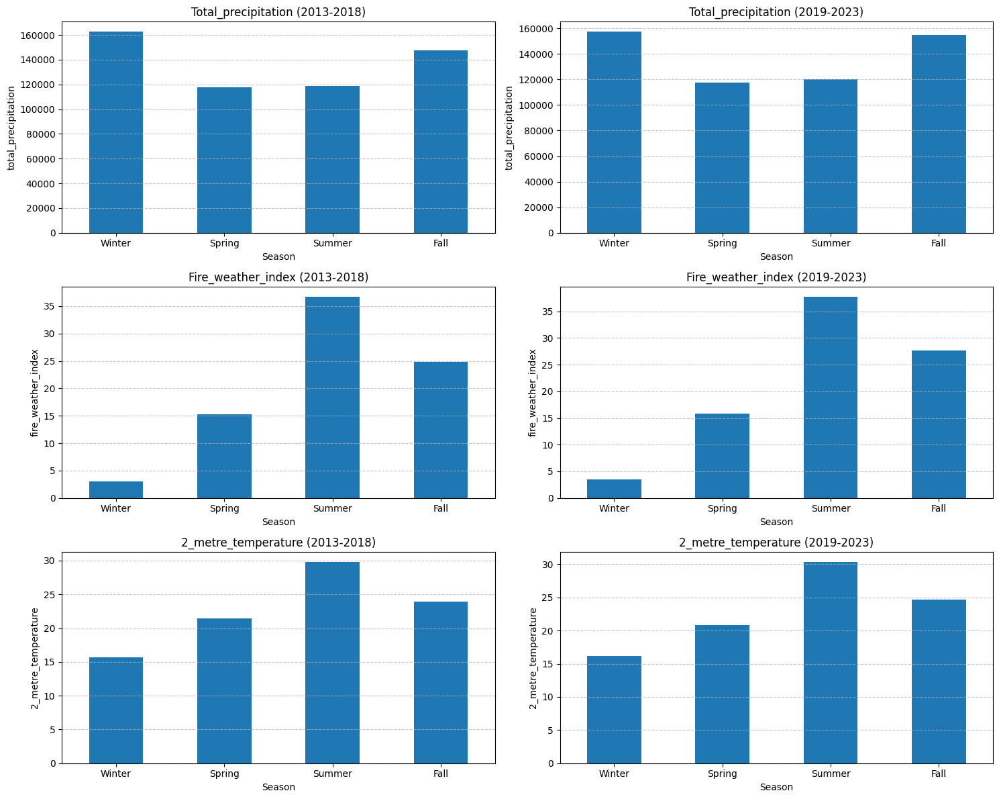

In [24]:
# Define time ranges for segmentation
time_segments = [
    ("2013-01-01", "2018-12-31"),
    ("2019-01-01", "2023-12-31")
]

# Rename variables for clarity
rename_dict = {
    "fwi": "fire_weather_index",
    "tp": "total_precipitation",
    "cdd": "cooling_degree_days",
    "t2m": "2_metre_temperature"
}

# Dictionary to store segmented datasets
segment_datasets = {}

# Process and analyze each time segment
for start_date, end_date in time_segments:
    print(f"\nProcessing and analyzing data for {start_date} to {end_date}...")

    # Filter dataset by time range
    segment_dataset = combined_dataset.sel(time=slice(start_date, end_date))

    # Subset dataset to Europe (Lat: 35°N to 70°N, Lon: -25°E to 45°E)
    europe_lat_bounds = slice(35, 70)
    europe_lon_bounds = slice(-25, 45)
    segment_dataset = segment_dataset.sel(lat=europe_lat_bounds, lon=europe_lon_bounds)

    # Replace missing values with NaN
    segment_dataset = segment_dataset.fillna(float("nan"))

    # Clean and validate specific variables
    if "t2m" in segment_dataset.variables:
        segment_dataset["t2m"] = segment_dataset["t2m"].where(
            (segment_dataset["t2m"] >= 200) & (segment_dataset["t2m"] <= 350), float("nan")
        )
        segment_dataset["t2m"] = segment_dataset["t2m"] - 273.15  # Convert from Kelvin to Celsius
        segment_dataset["t2m"].attrs["units"] = "Celsius"
        print("Validated and converted 2-metre temperature (t2m).")

    if "tp" in segment_dataset.variables:
        segment_dataset["tp"] = segment_dataset["tp"].where(segment_dataset["tp"] >= 0, float("nan"))
        segment_dataset["tp"] = segment_dataset["tp"] * 1000  # Convert to millimeters
        segment_dataset["tp"].attrs["units"] = "mm"
        print("Validated and converted total precipitation (tp).")

    if "fwi" in segment_dataset.variables:
        segment_dataset["fwi"] = segment_dataset["fwi"].where(segment_dataset["fwi"] >= 0, float("nan"))
        print("Validated Fire Weather Index (fwi): values >= 0.")

    segment_dataset = segment_dataset.rename({k: v for k, v in rename_dict.items() if k in segment_dataset})

    # Aggregate daily data into monthly averages to reduce noise
    segment_dataset = segment_dataset.resample(time="1ME").mean()

    # Store processed dataset
    segment_datasets[f"{start_date}_to_{end_date}"] = segment_dataset

# Prepare for 3x2 subplot visualization
fig, axes = plt.subplots(3, 2, figsize=(15, 12), sharex=False)
variables = ["total_precipitation", "fire_weather_index", "2_metre_temperature"]

time_segment_labels = ["2013-2018", "2019-2023"]

# Iterate through rows (variables) and columns (time segments)
for row_idx, variable in enumerate(variables):
    for col_idx, (start_date, end_date) in enumerate(time_segments):
        dataset_key = f"{start_date}_to_{end_date}"
        segment_dataset = segment_datasets[dataset_key]

        # Convert xarray Dataset to pandas DataFrame
        df = segment_dataset.to_dataframe().reset_index()
        df.set_index('time', inplace=True)

        # Add a 'season' column: 1 = Winter, 2 = Spring, 3 = Summer, 4 = Fall
        df['season'] = (df.index.month % 12 // 3) + 1

        # Calculate 95th percentile for the variable by season
        if variable in df.columns:
            seasonal_extremes = df.groupby('season')[variable].quantile(0.95)
            seasonal_extremes.index = ['Winter', 'Spring', 'Summer', 'Fall']

            # Plot the data
            ax = axes[row_idx, col_idx]
            seasonal_extremes.plot(
                kind='bar', ax=ax, title=f'{variable.capitalize()} ({time_segment_labels[col_idx]})', ylabel=variable
            )
            ax.set_xlabel('Season')
            ax.set_xticks(range(4))
            ax.set_xticklabels(['Winter', 'Spring', 'Summer', 'Fall'], rotation=0)
            ax.grid(axis='y', linestyle='--', alpha=0.7)

# Adjust layout
plt.tight_layout()
plt.show()

#### Seasonal Analysis of FWI


Performing Spatial Analysis for Fire Weather Index for 2013-01-01 to 2018-12-31...


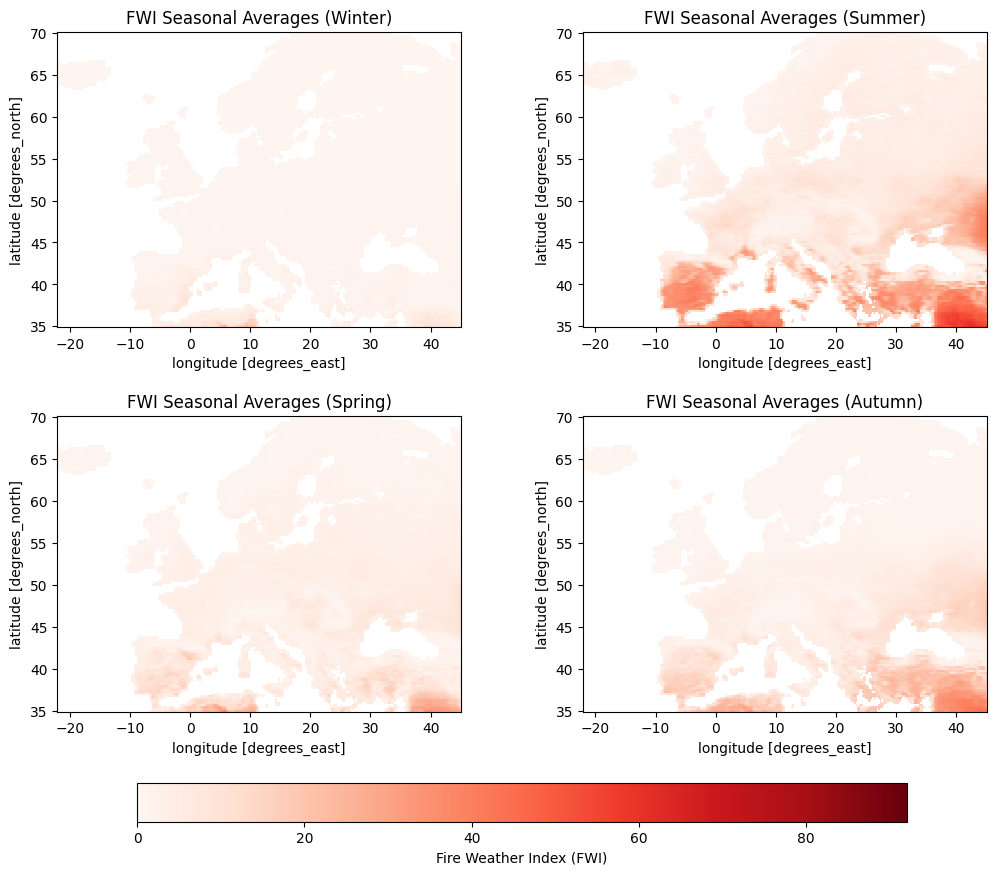

Variables in the processed dataset: ['2_metre_temperature', 'data', 'total_precipitation', 'cooling_degree_days', 'fire_weather_index']
Finished processing 2013-01-01 to 2018-12-31.


Performing Spatial Analysis for Fire Weather Index for 2019-01-01 to 2023-12-31...


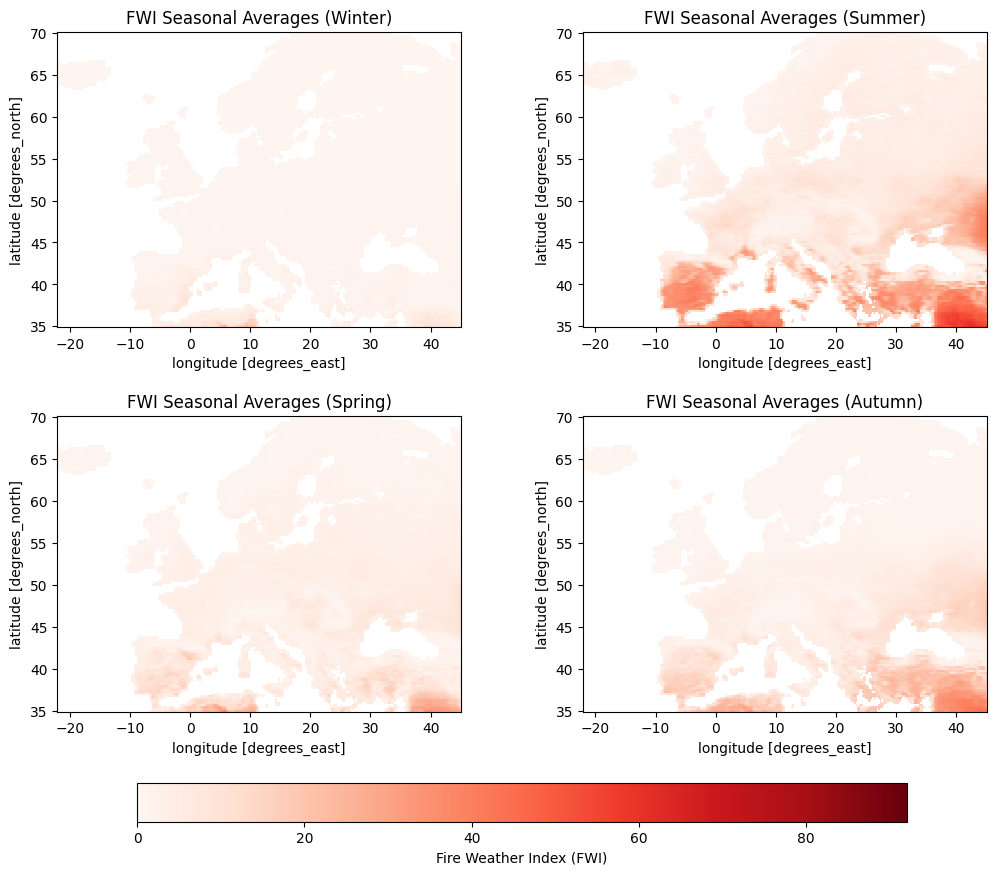

Variables in the processed dataset: ['2_metre_temperature', 'data', 'total_precipitation', 'cooling_degree_days', 'fire_weather_index']
Finished processing 2019-01-01 to 2023-12-31.



In [26]:
# Replace season abbreviations with full names
season_mapping = {"DJF": "Winter", "MAM": "Spring", "JJA": "Summer", "SON": "Autumn"}

# Process and analyze each time segment
for start_date, end_date in time_segments:

    # Spatial Analysis of Seasonal Averages for Fire Weather Index (FWI)
    print(f"\nPerforming Spatial Analysis for Fire Weather Index for {start_date} to {end_date}...")
    if "fire_weather_index" in segment_dataset.variables:
        # Group by season and calculate spatial averages
        seasonal_avg_map = segment_dataset["fire_weather_index"].groupby("time.season").mean()

        # Replace season names in the data
        seasonal_avg_map["season"] = xr.DataArray(
            [season_mapping[season] for season in seasonal_avg_map.season.data],
            dims="season",
        )

        # Determine consistent scale for all plots
        global_min = seasonal_avg_map.min().values
        global_max = seasonal_avg_map.max().values

        # Create a 2x2 subplot
        fig, axes = plt.subplots(2, 2, figsize=(12, 10))
        axes = axes.flatten()  # Flatten the 2D array of axes for easier iteration

        # Plot each season in a subplot
        for ax, season in zip(axes, seasonal_avg_map.season.data):
            # Select the data for the specific season
            spatial_data = seasonal_avg_map.sel(season=season)

            # Ensure the data is 2D by reducing dimensions if necessary
            if "lat" in spatial_data.dims and "lon" in spatial_data.dims:
                spatial_data = spatial_data.mean(dim=[dim for dim in spatial_data.dims if dim not in ["lat", "lon"]])

                # Plot the data
                im = spatial_data.plot.imshow(
                    ax=ax,
                    cmap="Reds",
                    robust=True,
                    vmin=global_min,  # Set consistent scaling
                    vmax=global_max,  # Set consistent scaling
                    add_colorbar=False,
                    extent=[-25, 45, 35, 70]  # Explicitly restrict the plot to Europe
                )
                ax.set_title(f"FWI Seasonal Averages ({season})")
            else:
                ax.set_title(f"Skipping {season} (no spatial dimensions)")
                ax.axis("off")

        # Add a single colorbar for all subplots
        cbar = fig.colorbar(im, ax=axes, orientation="horizontal", fraction=0.05, pad=0.2)
        cbar.set_label("Fire Weather Index (FWI)")

        # Adjust layout to create space for the colorbar
        fig.subplots_adjust(hspace=0.3, wspace=0.3, bottom=0.22, top=0.9)
        plt.show()

    # Display the variables included in the processed dataset (debugging/confirmation)
    print("Variables in the processed dataset:", list(segment_dataset.data_vars))

    print(f"Finished processing {start_date} to {end_date}.\n")


#### Convert Datasets to Dataframes

In [27]:
# Dictionary to store segment DataFrames
segment_dataframes = {}

# Convert segmented datasets to DataFrames
for time_range, dataset in segment_datasets.items():
    
    print(f"\nConverting dataset for {time_range} to DataFrame.")
    # Convert to DataFrame
    segment_df = dataset.to_dataframe().reset_index()
    segment_dataframes[time_range] = segment_df


Converting dataset for 2013-01-01_to_2018-12-31 to DataFrame.

Converting dataset for 2019-01-01_to_2023-12-31 to DataFrame.


#### Explore Correlations


Computing correlation matrix for 2013-01-01_to_2018-12-31...


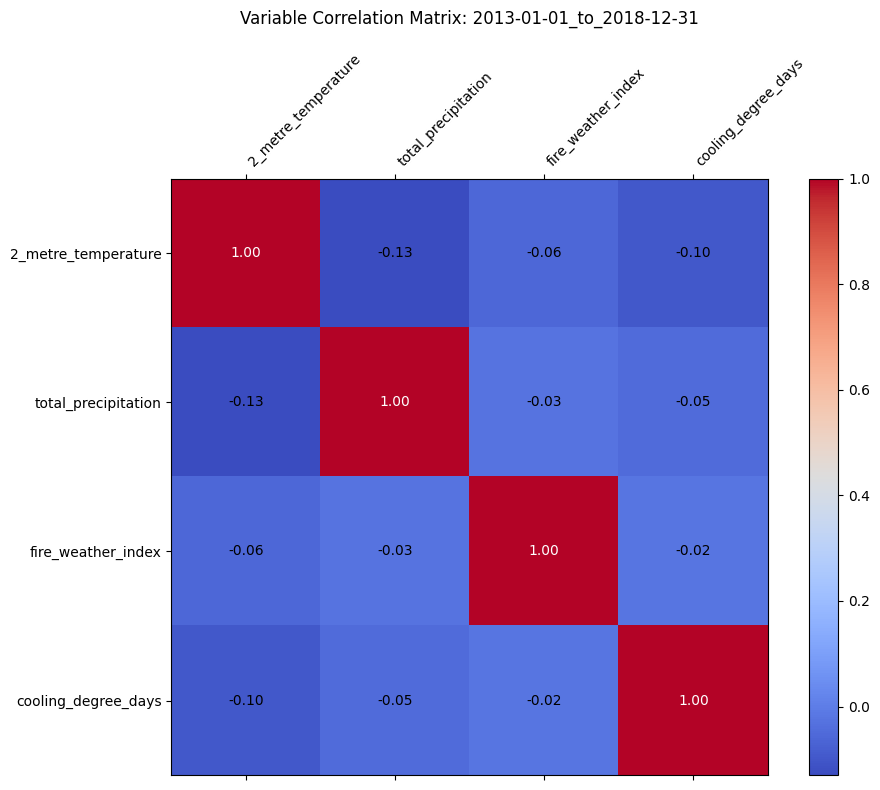


Correlation Matrix for 2013-01-01_to_2018-12-31:
                     2_metre_temperature  total_precipitation  \
2_metre_temperature             1.000000            -0.129986   
total_precipitation            -0.129986             1.000000   
fire_weather_index             -0.055256            -0.026573   
cooling_degree_days            -0.097662            -0.046966   

                     fire_weather_index  cooling_degree_days  
2_metre_temperature           -0.055256            -0.097662  
total_precipitation           -0.026573            -0.046966  
fire_weather_index             1.000000            -0.019965  
cooling_degree_days           -0.019965             1.000000  

Computing correlation matrix for 2019-01-01_to_2023-12-31...


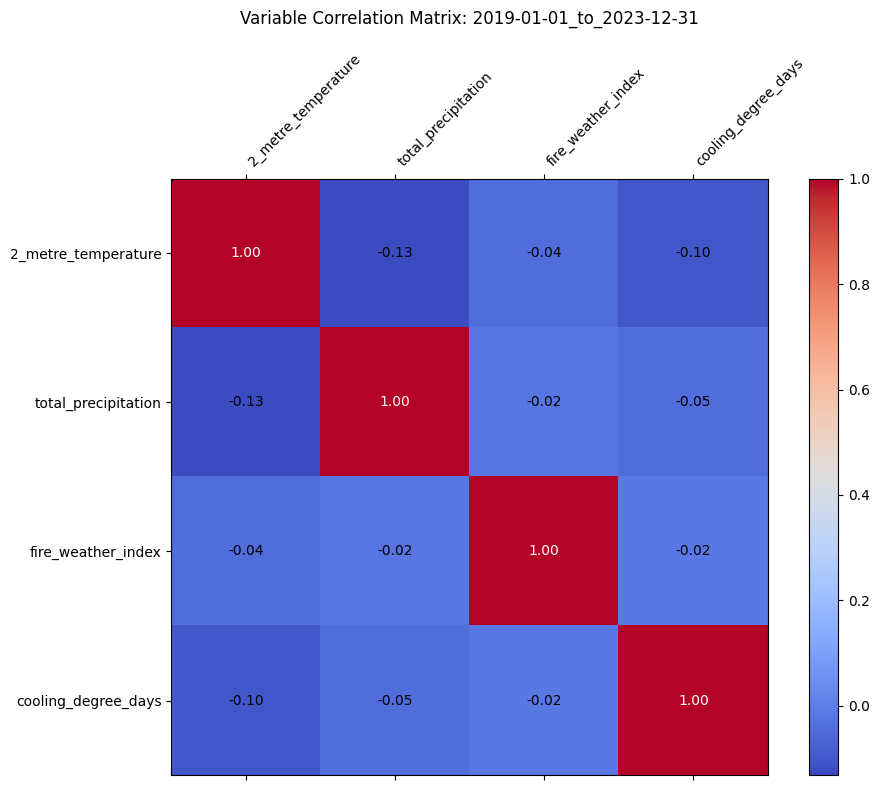


Correlation Matrix for 2019-01-01_to_2023-12-31:
                     2_metre_temperature  total_precipitation  \
2_metre_temperature             1.000000            -0.131624   
total_precipitation            -0.131624             1.000000   
fire_weather_index             -0.044071            -0.020924   
cooling_degree_days            -0.098407            -0.046720   

                     fire_weather_index  cooling_degree_days  
2_metre_temperature           -0.044071            -0.098407  
total_precipitation           -0.020924            -0.046720  
fire_weather_index             1.000000            -0.015643  
cooling_degree_days           -0.015643             1.000000  


In [28]:
# Correlation analysis for each segment DataFrame
for time_range, dataframe in segment_dataframes.items():
    print(f"\nComputing correlation matrix for {time_range}...")

    # Variables of interest
    variables_of_interest = [
        "2_metre_temperature",
        "total_precipitation",
        "fire_weather_index",
        "cooling_degree_days"
    ]

    # Select available variables in the DataFrame
    available_vars = [var for var in variables_of_interest if var in dataframe]

    if not available_vars:
        print(f"No variables of interest found in the DataFrame for {time_range}. Skipping.")
        continue

    # Preprocess DataFrame to handle missing values
    dataframe_subset = dataframe[available_vars]
    # Fill missing values with 0
    dataframe_subset = dataframe_subset.fillna(0)  

    if dataframe_subset.empty:
        print(f"No valid data available for correlation matrix in {time_range}. Skipping.")
        continue

    # Compute correlation matrix
    correlation_matrix = dataframe_subset.corr()

    # Visualize correlation matrix
    fig, ax = plt.subplots(figsize=(10, 8))
    cax = ax.matshow(correlation_matrix, cmap="coolwarm")
    plt.colorbar(cax)

    # Add ticks and labels
    ax.set_xticks(np.arange(len(available_vars)))
    ax.set_yticks(np.arange(len(available_vars)))
    ax.set_xticklabels(available_vars, rotation=45, ha="left")
    ax.set_yticklabels(available_vars)

    # Annotate heatmap with values
    for i in range(len(available_vars)):
        for j in range(len(available_vars)):
            value = correlation_matrix.iloc[i, j]
            text_color = "white" if abs(value) > 0.5 else "black"
            ax.text(j, i, f"{value:.2f}", va="center", ha="center", color=text_color)

    plt.title(f"Variable Correlation Matrix: {time_range}", pad=20)
    plt.tight_layout()
    plt.show()

    # Print correlation matrix
    print(f"\nCorrelation Matrix for {time_range}:")
    print(correlation_matrix)

#### Trend Analysis


Analyzing trends for segment: 2013-01-01_to_2018-12-31...

Analyzing trend for: 2_metre_temperature in segment 2013-01-01_to_2018-12-31...

Analyzing trend for: total_precipitation in segment 2013-01-01_to_2018-12-31...

Analyzing trend for: fire_weather_index in segment 2013-01-01_to_2018-12-31...

Analyzing trend for: cooling_degree_days in segment 2013-01-01_to_2018-12-31...

Analyzing trends for segment: 2019-01-01_to_2023-12-31...

Analyzing trend for: 2_metre_temperature in segment 2019-01-01_to_2023-12-31...

Analyzing trend for: total_precipitation in segment 2019-01-01_to_2023-12-31...

Analyzing trend for: fire_weather_index in segment 2019-01-01_to_2023-12-31...

Analyzing trend for: cooling_degree_days in segment 2019-01-01_to_2023-12-31...


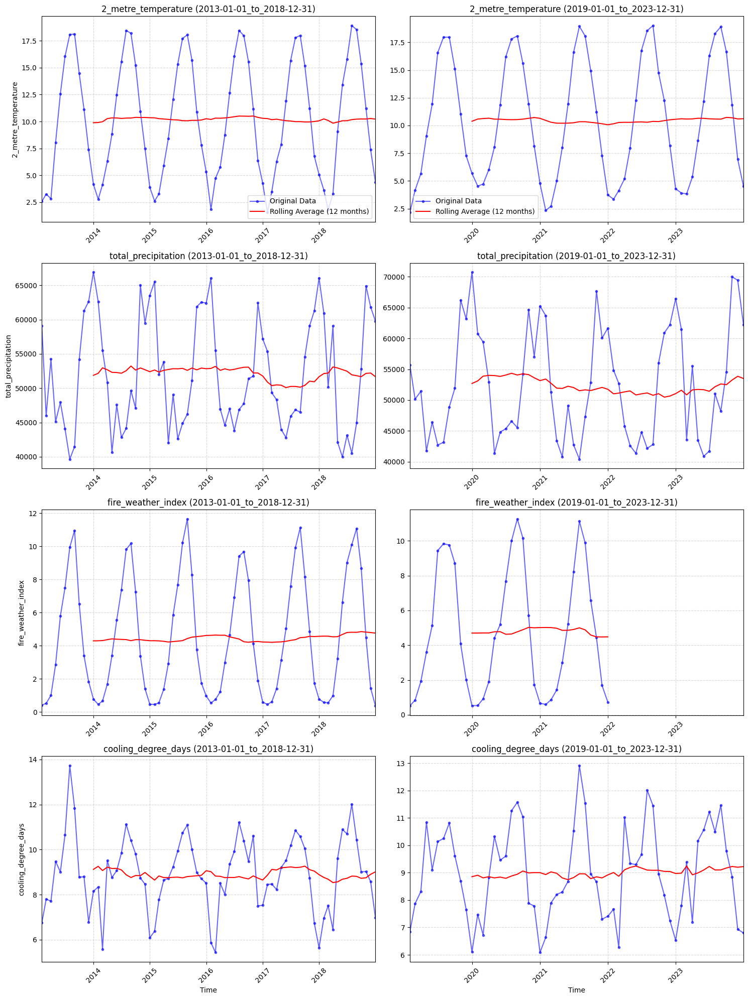

In [29]:
# Prepare subplots
n_variables = len(variables_of_interest)
n_segments = len(segment_dataframes)
fig, axes = plt.subplots(nrows=n_variables, ncols=n_segments, figsize=(15, 5 * n_variables), sharex=False)

if n_segments == 1:
    axes = np.expand_dims(axes, axis=1)  # Handle single-segment edge case

# Loop through each segment and variable to analyze trends
for col_idx, (time_range, dataframe) in enumerate(segment_dataframes.items()):
    print(f"\nAnalyzing trends for segment: {time_range}...")

    # Ensure 'time' is a proper datetime index
    if 'time' in dataframe.columns:
        dataframe['time'] = pd.to_datetime(dataframe['time'])
        dataframe.set_index('time', inplace=True)

    for row_idx, var in enumerate(variables_of_interest):
        if var in dataframe.columns:
            print(f"\nAnalyzing trend for: {var} in segment {time_range}...")

            # Get the time series for the variable
            time_series = dataframe[var]

            # Resample to ensure regular monthly intervals
            time_series = time_series.resample('M').mean()

            # Calculate a rolling average (12-month moving average)
            rolling_avg = time_series.rolling(window=12).mean()

            # Plot the original data and rolling average on subplot
            ax = axes[row_idx, col_idx]
            ax.plot(time_series, label="Original Data", color="blue", alpha=0.6, marker = '.')
            ax.plot(rolling_avg, label="Rolling Average (12 months)", color="red")

            # Add title, labels, and legend
            ax.set_title(f"{var} ({time_range})", fontsize=12)
            ax.set_xlabel("Time") if row_idx == n_variables - 1 else ax.set_xlabel("")
            ax.set_ylabel(var) if col_idx == 0 else ax.set_ylabel("")

            # Format x-axis to show available years only
            ax.set_xlim(time_series.index.min(), time_series.index.max())
            ax.xaxis.set_major_locator(YearLocator())
            ax.xaxis.set_major_formatter(DateFormatter('%Y'))
            ax.tick_params(axis='x', rotation=45)  # Rotate year labels

            # Add grid and legend
            ax.grid(True, linestyle="--", alpha=0.5)
            if row_idx == 0:  # Show legend only on top row
                ax.legend()
        else:
            print(f"Variable '{var}' not found in segment {time_range}.")

# Adjust layout
plt.tight_layout()
plt.show()


 #### Temperature vs. Fire weather index over time


Analyzing relationship for segment: 2013-01-01_to_2018-12-31...
Correlation between Temp and FWI in 2013-01-01_to_2018-12-31: 0.97

Analyzing relationship for segment: 2019-01-01_to_2023-12-31...
Correlation between Temp and FWI in 2019-01-01_to_2023-12-31: 0.97


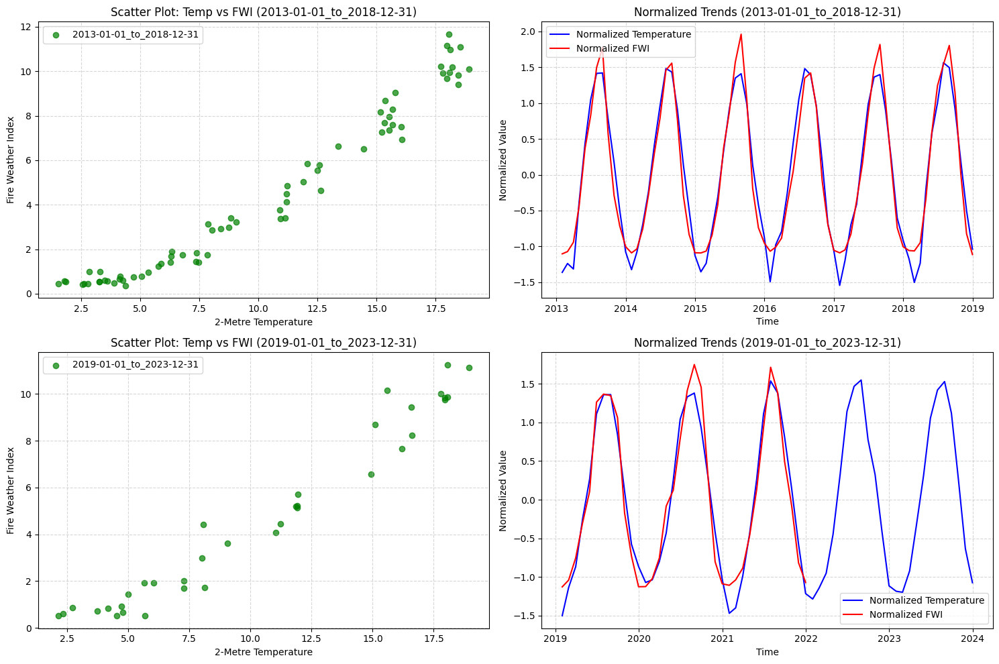

In [30]:
# Extract specific variables for comparison
comparison_variables = ["2_metre_temperature", "fire_weather_index"]

# Prepare subplots: one row per segment
n_segments = len(segment_dataframes)
fig, axes = plt.subplots(nrows=n_segments, ncols=2, figsize=(15, 5 * n_segments), sharex=False)

if n_segments == 1:
    axes = np.expand_dims(axes, axis=0)  # Handle single-segment edge case

for col_idx, (time_range, dataframe) in enumerate(segment_dataframes.items()):
    print(f"\nAnalyzing relationship for segment: {time_range}...")

    # Ensure 'time' is a proper datetime index
    if 'time' in dataframe.columns:
        dataframe['time'] = pd.to_datetime(dataframe['time'])
        dataframe.set_index('time', inplace=True)

    # Resample data for regular intervals
    resampled_data = dataframe[comparison_variables].resample('M').mean()

    # Scatter plot
    ax_scatter = axes[col_idx, 0]
    ax_scatter.scatter(
        resampled_data["2_metre_temperature"],
        resampled_data["fire_weather_index"],
        alpha=0.7,
        color="green",
        label=f"{time_range}"
    )
    ax_scatter.set_title(f"Scatter Plot: Temp vs FWI ({time_range})")
    ax_scatter.set_xlabel("2-Metre Temperature")
    ax_scatter.set_ylabel("Fire Weather Index")
    ax_scatter.grid(True, linestyle="--", alpha=0.5)
    ax_scatter.legend()

    # Overlay trends (normalized for comparison)
    ax_trend = axes[col_idx, 1]
    temp_normalized = (resampled_data["2_metre_temperature"] - resampled_data["2_metre_temperature"].mean()) / resampled_data["2_metre_temperature"].std()
    fwi_normalized = (resampled_data["fire_weather_index"] - resampled_data["fire_weather_index"].mean()) / resampled_data["fire_weather_index"].std()

    ax_trend.plot(temp_normalized, label="Normalized Temperature", color="blue")
    ax_trend.plot(fwi_normalized, label="Normalized FWI", color="red")
    ax_trend.set_title(f"Normalized Trends ({time_range})")
    ax_trend.set_xlabel("Time")
    ax_trend.set_ylabel("Normalized Value")
    ax_trend.grid(True, linestyle="--", alpha=0.5)
    ax_trend.legend()

    # Compute correlation
    correlation = resampled_data.corr().loc["2_metre_temperature", "fire_weather_index"]
    print(f"Correlation between Temp and FWI in {time_range}: {correlation:.2f}")

# Adjust layout
plt.tight_layout()
plt.show()

 #### Temperature vs. Fire weather index over time (Only for 2019)


Analyzing relationship for year: 2019...
No data available for 2019 in segment 2013-01-01_to_2018-12-31.

Analyzing relationship for year: 2019...
Correlation between Temp and FWI in 2019: 0.98


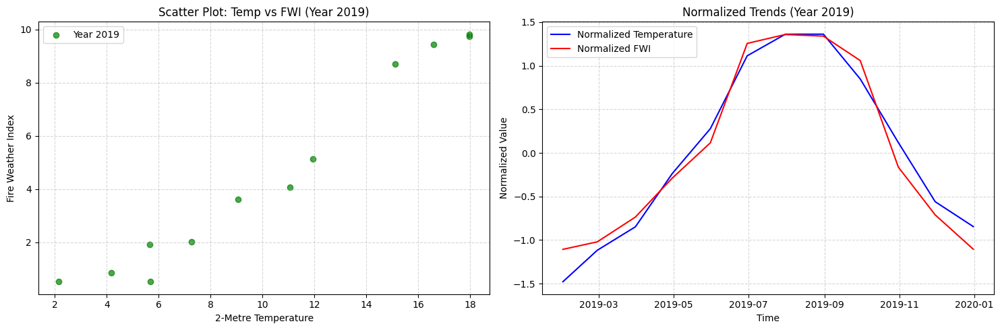

In [18]:
# Extract specific variables for comparison
comparison_variables = ["2_metre_temperature", "fire_weather_index"]

# Filter data for 2019 only
year_to_analyze = 2019

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5), sharex=False)

for time_range, dataframe in segment_dataframes.items():
    print(f"\nAnalyzing relationship for year: {year_to_analyze}...")

    # Ensure 'time' is a proper datetime index
    if 'time' in dataframe.columns:
        dataframe['time'] = pd.to_datetime(dataframe['time'])
        dataframe.set_index('time', inplace=True)

    # Filter for the specific year
    dataframe = dataframe[dataframe.index.year == year_to_analyze]

    if dataframe.empty:
        print(f"No data available for {year_to_analyze} in segment {time_range}.")
        continue

    # Resample data for regular intervals
    resampled_data = dataframe[comparison_variables].resample('M').mean()

    # Scatter plot
    ax_scatter = axes[0]
    ax_scatter.scatter(
        resampled_data["2_metre_temperature"],
        resampled_data["fire_weather_index"],
        alpha=0.7,
        color="green",
        label=f"Year {year_to_analyze}"
    )
    ax_scatter.set_title(f"Scatter Plot: Temp vs FWI (Year {year_to_analyze})")
    ax_scatter.set_xlabel("2-Metre Temperature")
    ax_scatter.set_ylabel("Fire Weather Index")
    ax_scatter.grid(True, linestyle="--", alpha=0.5)
    ax_scatter.legend()

    # Overlay trends (normalized for comparison)
    ax_trend = axes[1]
    temp_normalized = (resampled_data["2_metre_temperature"] - resampled_data["2_metre_temperature"].mean()) / resampled_data["2_metre_temperature"].std()
    fwi_normalized = (resampled_data["fire_weather_index"] - resampled_data["fire_weather_index"].mean()) / resampled_data["fire_weather_index"].std()

    ax_trend.plot(temp_normalized, label="Normalized Temperature", color="blue")
    ax_trend.plot(fwi_normalized, label="Normalized FWI", color="red")
    ax_trend.set_title(f"Normalized Trends (Year {year_to_analyze})")
    ax_trend.set_xlabel("Time")
    ax_trend.set_ylabel("Normalized Value")
    ax_trend.grid(True, linestyle="--", alpha=0.5)
    ax_trend.legend()

    # Compute correlation
    correlation = resampled_data.corr().loc["2_metre_temperature", "fire_weather_index"]
    print(f"Correlation between Temp and FWI in {year_to_analyze}: {correlation:.2f}")

# Adjust layout
plt.tight_layout()
plt.show()


#### Check for Lagged Correlations

Data too large for pairplot, sampling 10000 rows from 54617760...

Checking for lagged correlations...
Lag 1: Correlation between total_precipitation and fire_weather_index = 0.01
Lag 2: Correlation between total_precipitation and fire_weather_index = 0.01
Lag 3: Correlation between total_precipitation and fire_weather_index = -0.00
Lag 4: Correlation between total_precipitation and fire_weather_index = 0.02
Lag 5: Correlation between total_precipitation and fire_weather_index = -0.00
Lag 6: Correlation between total_precipitation and fire_weather_index = 0.02


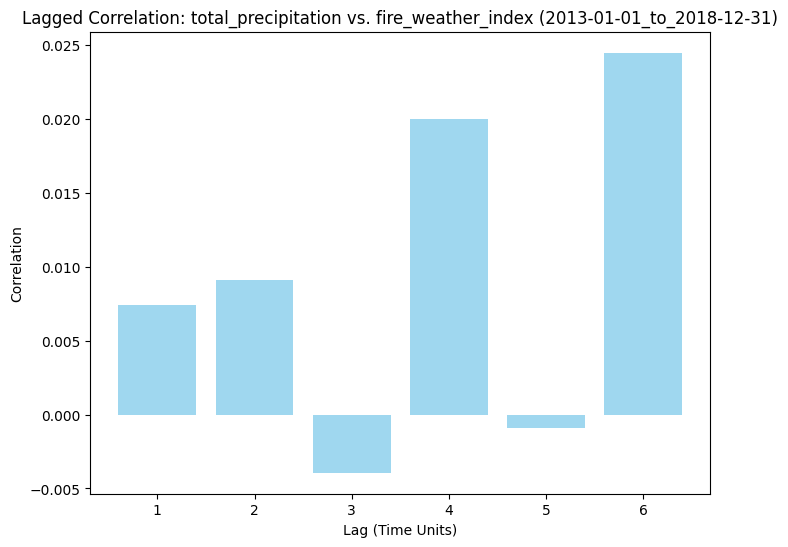

Data too large for pairplot, sampling 10000 rows from 45514800...

Checking for lagged correlations...
Lag 1: Correlation between total_precipitation and fire_weather_index = 0.01
Lag 2: Correlation between total_precipitation and fire_weather_index = -0.00
Lag 3: Correlation between total_precipitation and fire_weather_index = -0.00
Lag 4: Correlation between total_precipitation and fire_weather_index = -0.00
Lag 5: Correlation between total_precipitation and fire_weather_index = 0.00
Lag 6: Correlation between total_precipitation and fire_weather_index = -0.01


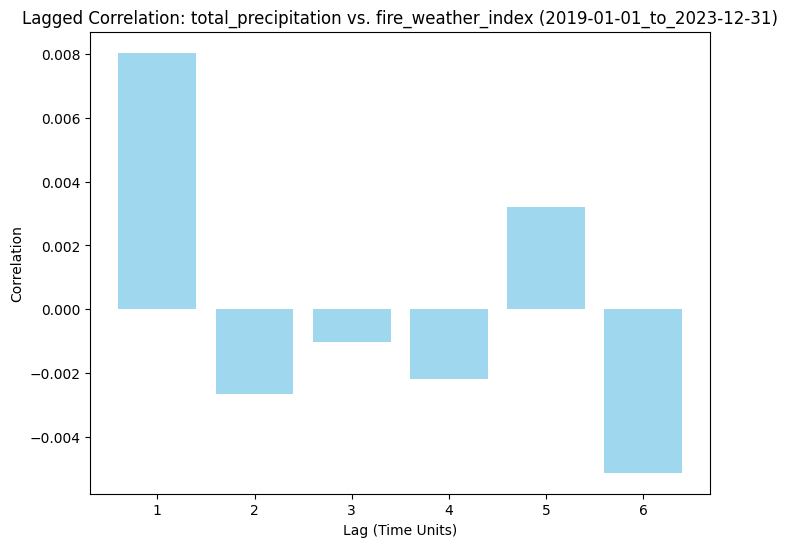

In [19]:
# Correlation analysis for each segment DataFrame
for time_range, dataframe in segment_dataframes.items():

    # Select available variables in the DataFrame
    available_vars = [var for var in variables_of_interest if var in dataframe]

    if not available_vars:
        print(f"No variables of interest found in the DataFrame for {time_range}. Skipping.")
        continue

    # Preprocess DataFrame to handle missing values
    dataframe_subset = dataframe[available_vars]
    # Fill missing values with 0
    dataframe_subset = dataframe_subset.fillna(0)  

    if dataframe_subset.empty:
        print(f"No valid data available for analysis in {time_range}. Skipping.")
        continue

    max_rows = 10000  # Set a maximum number of rows to process
    if len(dataframe_subset) > max_rows:
        print(f"Data too large for pairplot, sampling {max_rows} rows from {len(dataframe_subset)}...")
        dataframe_subset = dataframe_subset.sample(n=max_rows, random_state=42)

    # Lagged Correlation Analysis
    print("\nChecking for lagged correlations...")

    # Define variables for lagged correlation analysis
    lag_variable = "total_precipitation"
    response_variable = "fire_weather_index"

    # Ensure both variables exist in the DataFrame
    if lag_variable not in dataframe_subset.columns or response_variable not in dataframe_subset.columns:
        print(f"One or both variables ({lag_variable}, {response_variable}) not found. Skipping lagged correlation.")
        continue

    # Maximum number of lags to check
    max_lag = 6

    # Calculate lagged correlations
    lagged_correlations = []
    for lag in range(1, max_lag + 1):
        shifted_data = dataframe_subset[lag_variable].shift(lag)  # Shift lag variable
        correlation = dataframe_subset[response_variable].corr(shifted_data)
        lagged_correlations.append((lag, correlation))
        print(f"Lag {lag}: Correlation between {lag_variable} and {response_variable} = {correlation:.2f}")

    # Visualize lagged correlations
    if lagged_correlations:
        lags, correlations = zip(*lagged_correlations)
        plt.figure(figsize=(8, 6))
        plt.bar(lags, correlations, color="skyblue", alpha=0.8)
        plt.xlabel("Lag (Time Units)")
        plt.ylabel("Correlation")
        plt.title(f"Lagged Correlation: {lag_variable} vs. {response_variable} ({time_range})")
        plt.xticks(lags)
        plt.show()


#### Spatial Analysis


Analyzing segment: 2013-01-01_to_2018-12-31
Processing variable: fire_weather_index


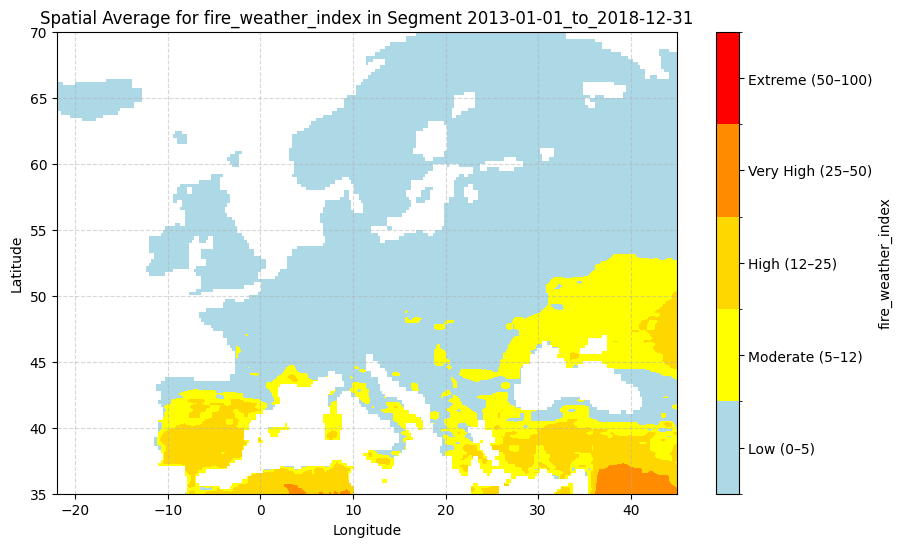

Processing variable: cooling_degree_days


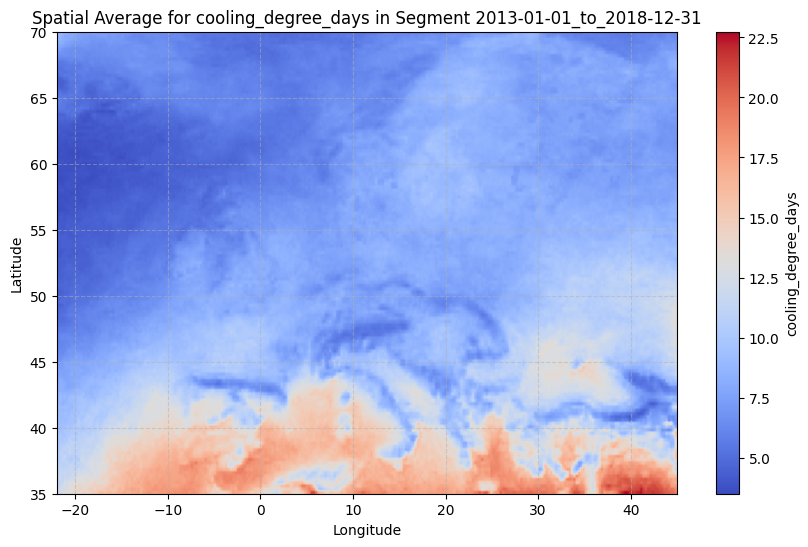


Analyzing segment: 2019-01-01_to_2023-12-31
Processing variable: fire_weather_index


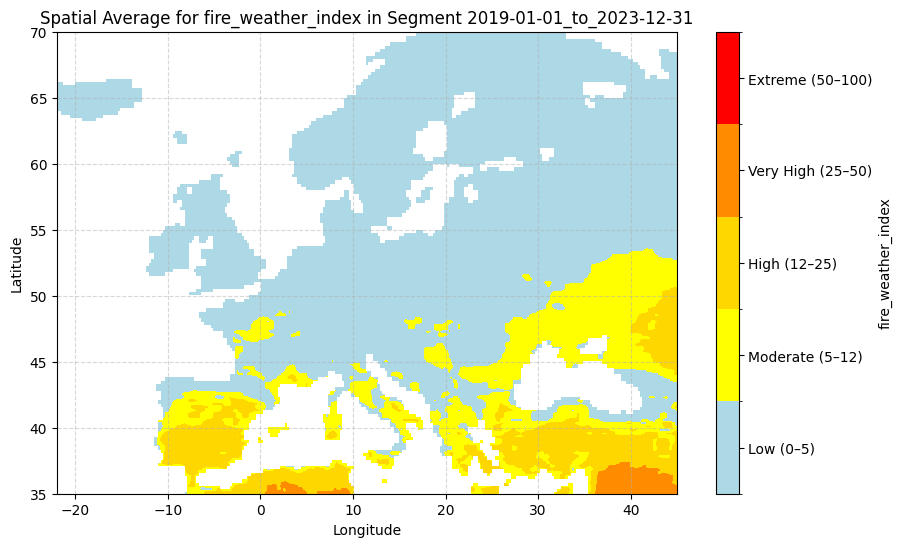

Processing variable: cooling_degree_days


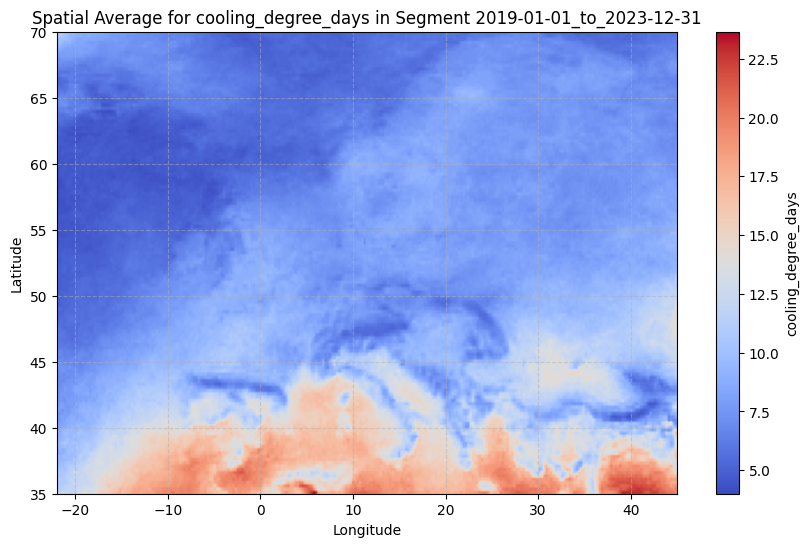

In [80]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

# Define the new colormap for fire_weather_index
fire_weather_colors = ["lightblue", "yellow", "gold", "darkorange", "red"]
bounds = [0, 5, 12, 25, 50, 100]  # Thresholds for fire weather index
fire_weather_labels = ["Low", "Moderate", "High", "Very High", "Extreme"]
fire_weather_cmap = mcolors.ListedColormap(fire_weather_colors)
fire_weather_norm = mcolors.BoundaryNorm(bounds, fire_weather_cmap.N)

# Define variables of interest
variables_of_interest = ["fire_weather_index", "cooling_degree_days"]

# Iterate over each segment in `segment_dataframes`
for segment, dataframe in segment_dataframes.items():
    print(f"\nAnalyzing segment: {segment}")

    # Ensure lat/lon columns exist
    if "lat" not in dataframe.columns or "lon" not in dataframe.columns:
        print(f"Skipping segment '{segment}': Missing lat/lon columns.")
        continue

    # Iterate over variables of interest
    for var in variables_of_interest:
        if var in dataframe.columns:
            print(f"Processing variable: {var}")

            # Pivot the data to get a 2D grid of lat/lon
            spatial_data = dataframe.pivot_table(values=var, index="lat", columns="lon")

            # Determine colormap and norm based on variable
            if var == "fire_weather_index":
                colormap = fire_weather_cmap
                color_norm = fire_weather_norm
                colorbar_bounds = bounds
                colorbar_labels = fire_weather_labels
            else:  # Default look for cooling_degree_days
                colormap = "coolwarm"
                color_norm = None
                colorbar_bounds = None
                colorbar_labels = None

            # Plot the spatial average
            plt.figure(figsize=(10, 6))
            im = plt.imshow(
                spatial_data,
                cmap=colormap,
                norm=color_norm,
                aspect="auto",
                origin="lower",
                extent=[
                    spatial_data.columns.min(),
                    spatial_data.columns.max(),
                    spatial_data.index.min(),
                    spatial_data.index.max(),
                ],
            )

            if colorbar_bounds:  # Add custom colorbar for fire_weather_index
                cbar = plt.colorbar(im, ticks=bounds, label=var)
                # Add both values and descriptions
                tick_positions = [(bounds[i] + bounds[i + 1]) / 2 for i in range(len(bounds) - 1)]
                cbar.ax.set_yticks(tick_positions)
                cbar.ax.set_yticklabels(
                    [f"{fire_weather_labels[i]} ({bounds[i]}–{bounds[i+1]})" for i in range(len(bounds) - 1)]
                )
            else:  # Default colorbar for other variables
                plt.colorbar(im, label=var)

            plt.title(f"Spatial Average for {var} in Segment {segment}")
            plt.xlabel("Longitude")
            plt.ylabel("Latitude")
            plt.grid(True, linestyle="--", alpha=0.5)
            plt.show()

        else:
            print(f"Skipping variable '{var}': Not found in segment '{segment}'.")
